In [1]:
%matplotlib inline

In [6]:
import pandas as pd
import numpy as np 
import geopandas 
import matplotlib.pyplot as plt           
import pandas as pd     
import json 
import requests
import overpy
from tqdm import tqdm
from multiprocessing.dummy import Pool
import seaborn as sns

# Inicia el Análisis exploratorio

In [8]:
Datos_econ_cali = pd.read_excel('databases_and_shapefiles/Covid_19_espacial_machine_learning.xlsx')
Datos_econ_cali.head()

,N,ID_BARRIO,Barrio_Urbanizacion_o_Sector,NOMBRE,Comuna,TGP = PEA/PET,TGI = PEI/PET,TD = Desocupados/PEA,TO = Ocupados/PET,TE = Ocupados/PEA,...,Tasa_ind_cobert_serv_bajo,Tasa_Pobre_nbi,Comorbilidad,Diabetes,HTA,Muertos,Recuperados,razon_letalidad,Covid,geometry
0,1,101,Terron Colorado,Terron Colorado,1,0.406665,0.182994,0.185587,0.331193,0.814413,...,0.240125,0.072224,230,56.0,83.0,51,1197,0.040865,1679,POLYGON ((-76.56995120093426 3.456430244134905...
1,2,102,Vista Hermosa,Vista Hermosa,1,0.390458,0.169281,0.178775,0.320654,0.821225,...,0.287637,0.098189,79,10.0,34.0,10,439,0.022272,614,POLYGON ((-76.57692380316878 3.458973625028077...
2,3,196,Sector Patio Bonito,Sect. Patio Bonito,1,0.371220,0.203902,0.203679,0.295610,0.796321,...,0.400932,0.157675,10,3.0,6.0,1,66,0.014925,123,"POLYGON ((-76.59073787613775 3.46718939421395,..."
3,4,199,Aguacatal,Aguacatal,1,0.380852,0.194102,0.200827,0.304367,0.799173,...,0.234079,0.090310,94,15.0,39.0,12,543,0.021622,733,"POLYGON ((-76.5591645462267 3.463446593644202,..."
4,5,201,Santa Rita,Santa Rita,2,NaN,NaN,NaN,NaN,NaN,...,0.055994,0.018139,26,4.0,12.0,0,121,0.000000,184,POLYGON ((-76.54810921072797 3.454631979818922...


In [9]:
Datos_econ_cali.columns

Index(['N', 'ID_BARRIO', 'Barrio_Urbanizacion_o_Sector', 'NOMBRE', 'Comuna',
       'TGP = PEA/PET', 'TGI = PEI/PET', 'TD = Desocupados/PEA',
       'TO = Ocupados/PET', 'TE = Ocupados/PEA', 'Estrato_moda',
       'Poblacion_total', 'e0_19', 'e20_39', 'e40_59', 'e60', 'pope0a19_M',
       'pope20a39_M', 'pope40a59_M', 'pope60_M', 'popae0a19_F', 'pope20a39_F',
       'pope40a59_F', 'pope60_F', 'Hogares', 'Tam_promedio_hog',
       'Adulto_mayor', 'Prop_adulto_mayor', 'Prop_Edad_T_60a64',
       'Prop_Edad_T_65a69', 'Prop_Edad_T_70a74', 'Prop_Edad_T_75a79',
       'Prop_Edad_T_80omas', 'Prop_Edad_H_60a64', 'Prop_Edad_H_65a69',
       'Prop_Edad_H_70a74', 'Prop_Edad_H_75a79', 'Prop_Edad_H_80omas',
       'Prop_Edad_M_60a64', 'Prop_Edad_M_65a69', 'Prop_Edad_M_70a74',
       'Prop_Edad_M_75a79', 'Prop_Edad_M_80omas', 'Proporcion_etnia',
       'Proporcion_ngr_afro_pal_raiz', 'Proporc_personas_dificultades',
       'Proporcion_sabe_leer_escribir', 'Asistencia_esc_5',
       'Asistencia_esc_6

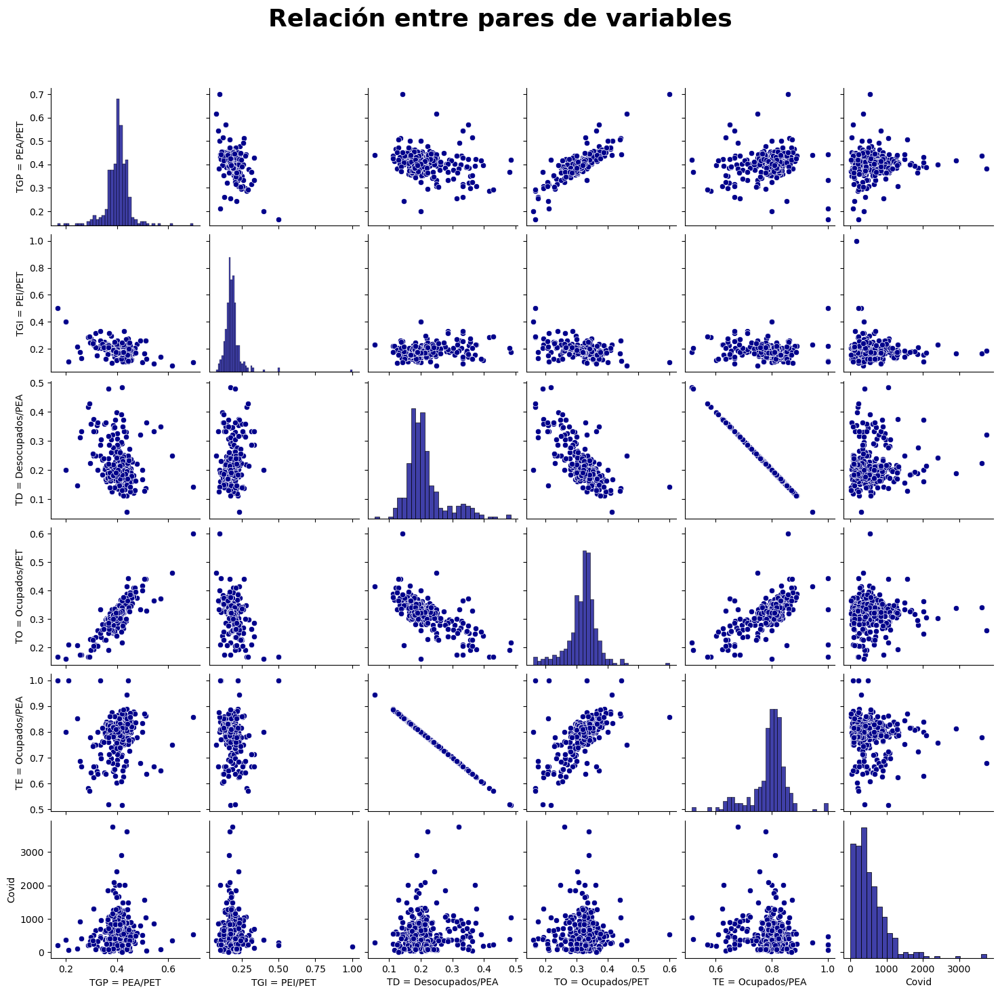

In [10]:
#### Variables de empleo y covid
g = sns.pairplot(Datos_econ_cali.iloc[:,[5,6,7,8,9,72]], plot_kws = {"color": "darkblue"},
                 diag_kws = {"color":"darkblue"})
g.fig.suptitle("Relación entre pares de variables",
               fontsize = 26,
               fontweight = "bold")
plt.subplots_adjust(top=0.9)
plt.show()

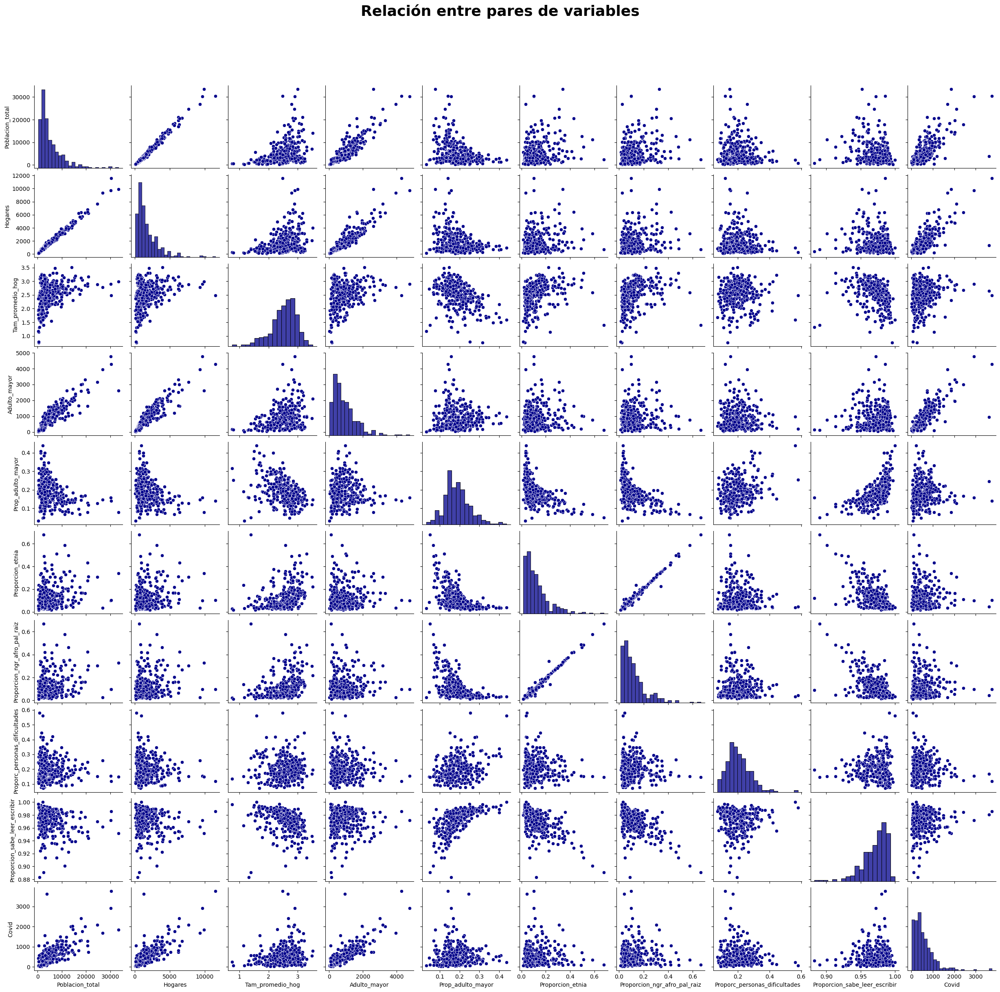

In [11]:
#### Variables de edad, población, etnia  y covid
g = sns.pairplot(Datos_econ_cali.iloc[:,[11,24,25,26,27,43,44,45,46,72]], plot_kws = {"color": "darkblue"},
                 diag_kws = {"color":"darkblue"})
g.fig.suptitle("Relación entre pares de variables",
               fontsize = 26,
               fontweight = "bold")
plt.subplots_adjust(top=0.9)
plt.show()

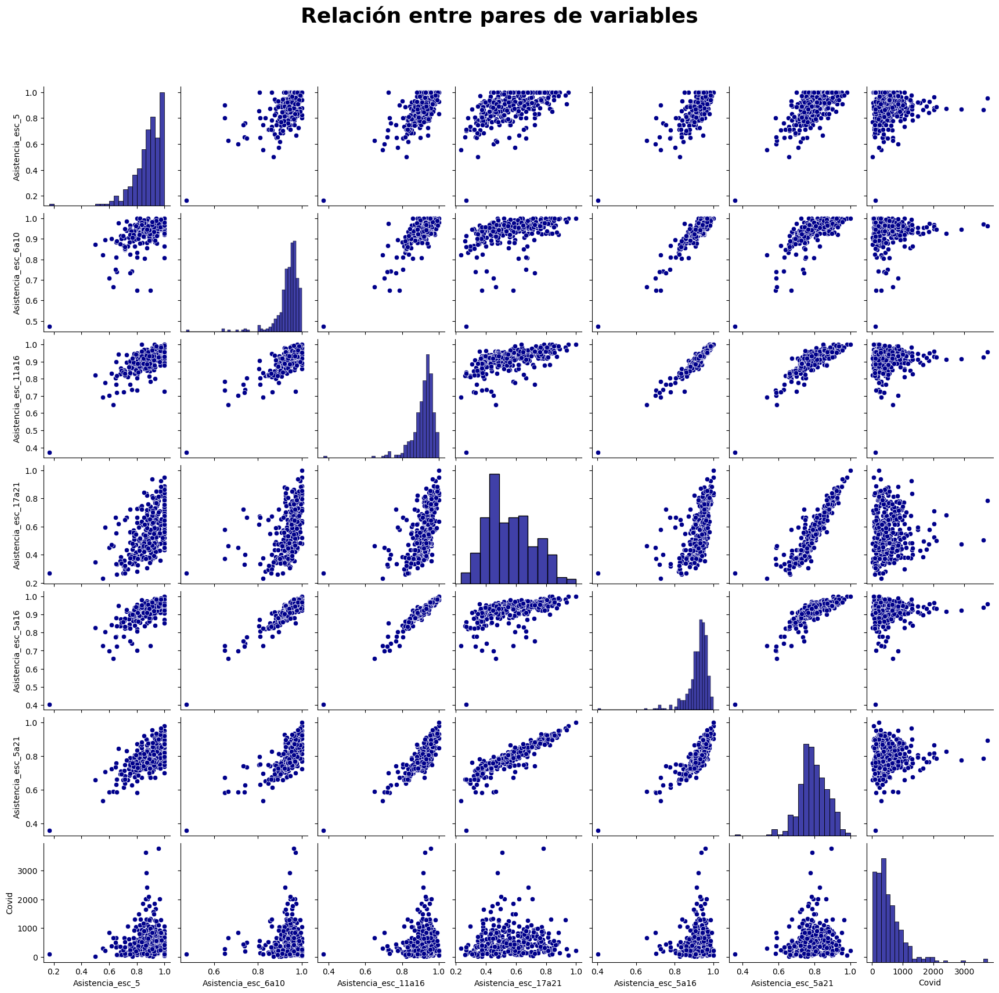

In [12]:
#### Variables de asistencia escolar y covid
g = sns.pairplot(Datos_econ_cali.iloc[:,[47,48,49,50,51,52,72]], plot_kws = {"color": "darkblue"},
                 diag_kws = {"color":"darkblue"})
g.fig.suptitle("Relación entre pares de variables",
               fontsize = 26,
               fontweight = "bold")
plt.subplots_adjust(top=0.9)
plt.show()

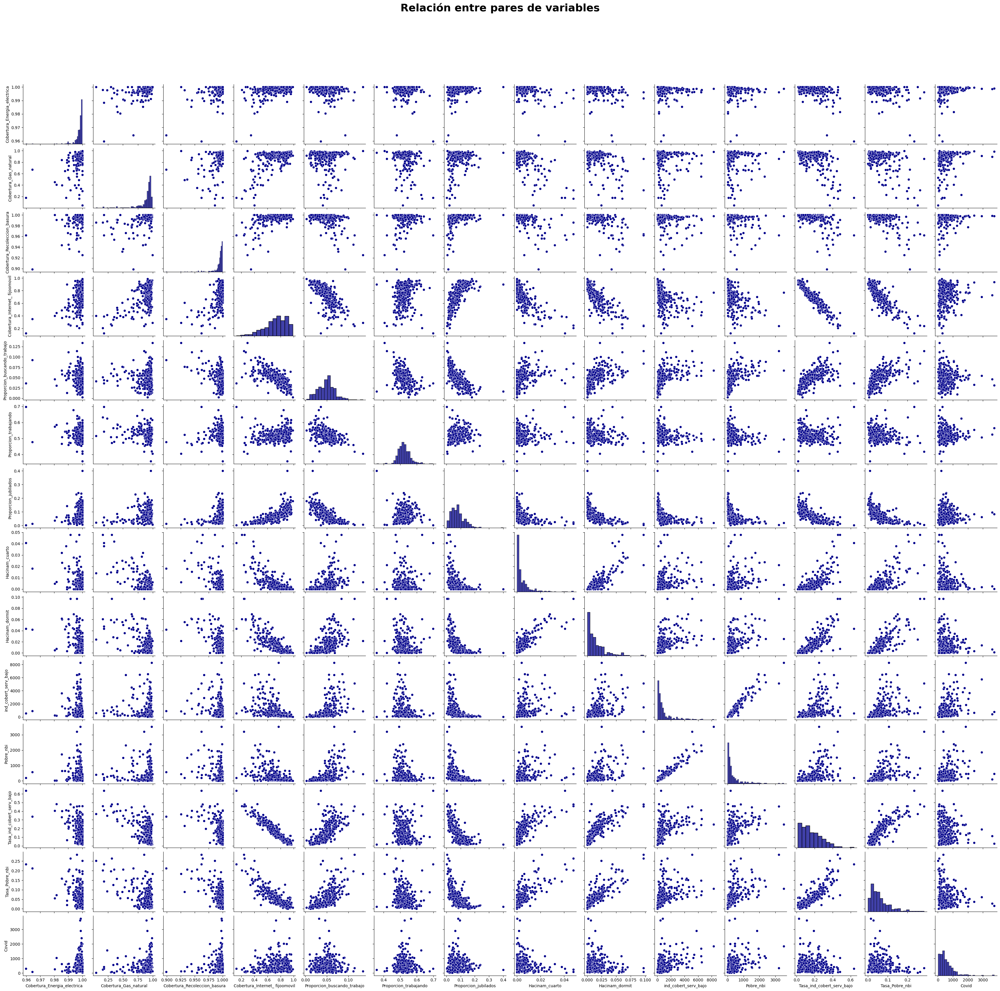

In [13]:
#### Variables socioeconómicas y de hacinamiento y covid
g = sns.pairplot(Datos_econ_cali.iloc[:,[53,54,55,56,57,58,59,60,61,62,63,64,65,72]], plot_kws = {"color": "darkblue"},
                 diag_kws = {"color":"darkblue"})
g.fig.suptitle("Relación entre pares de variables",
               fontsize = 26,
               fontweight = "bold")
plt.subplots_adjust(top=0.9)
plt.show()

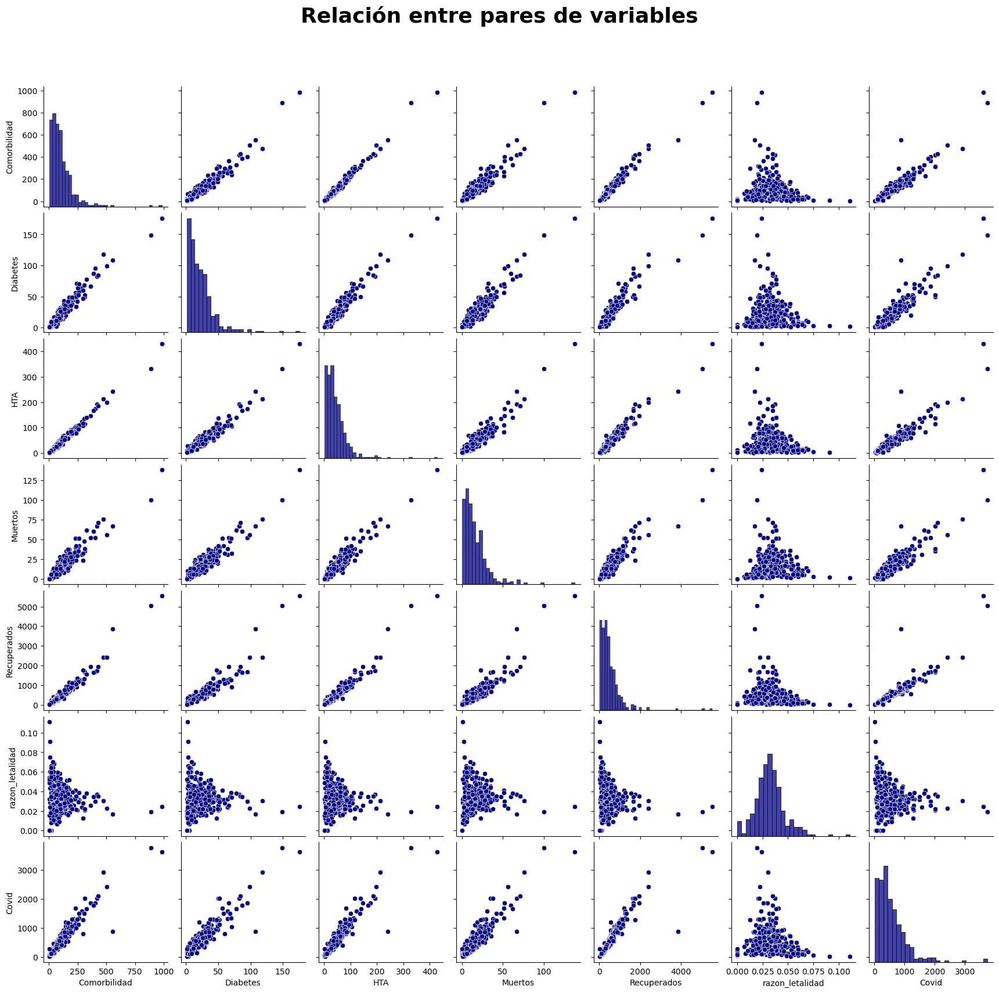

In [14]:
#### Variables asociadas con Covid y covid
g = sns.pairplot(Datos_econ_cali.iloc[:,[66,67,68,69,70,71,72]], plot_kws = {"color": "darkblue"},
                 diag_kws = {"color":"darkblue"})
g.fig.suptitle("Relación entre pares de variables",
               fontsize = 26,
               fontweight = "bold")
plt.subplots_adjust(top=0.9)
plt.show()

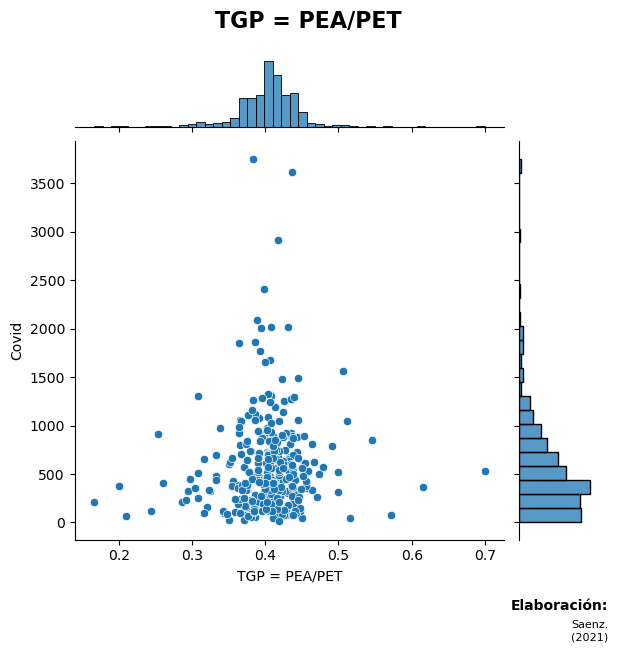

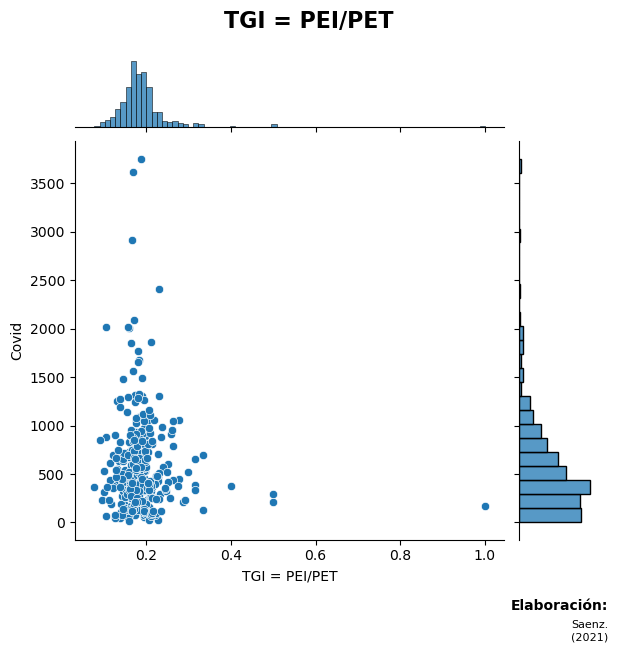

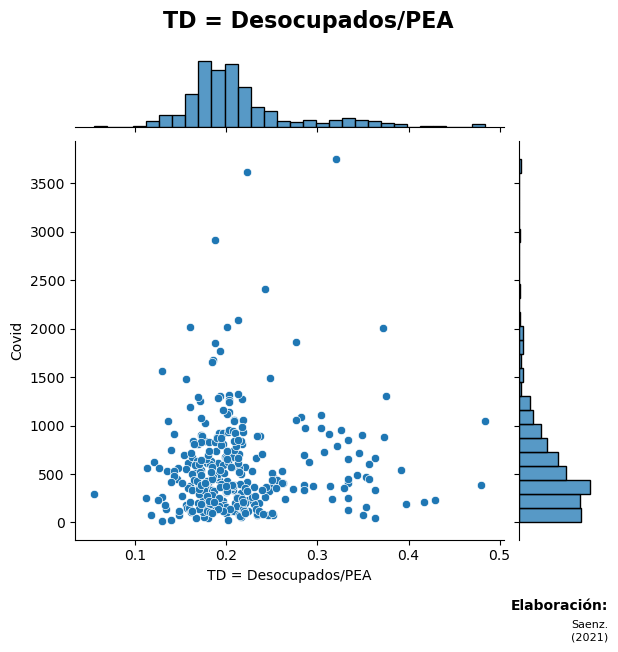

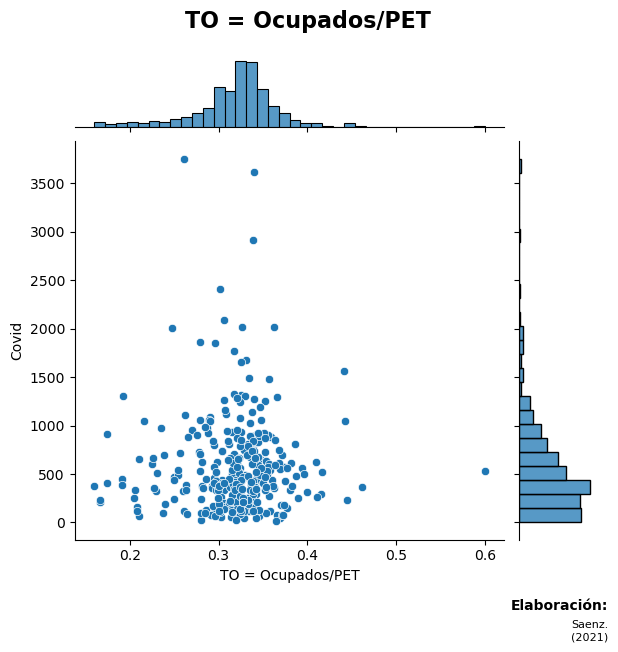

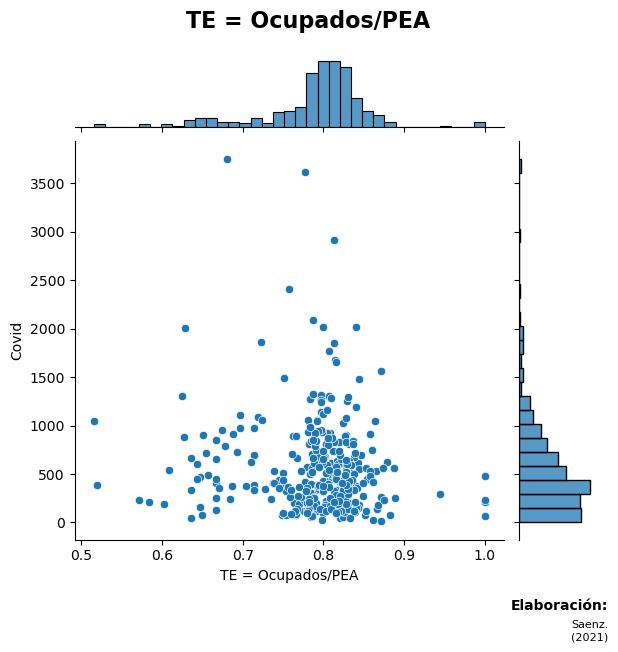

...

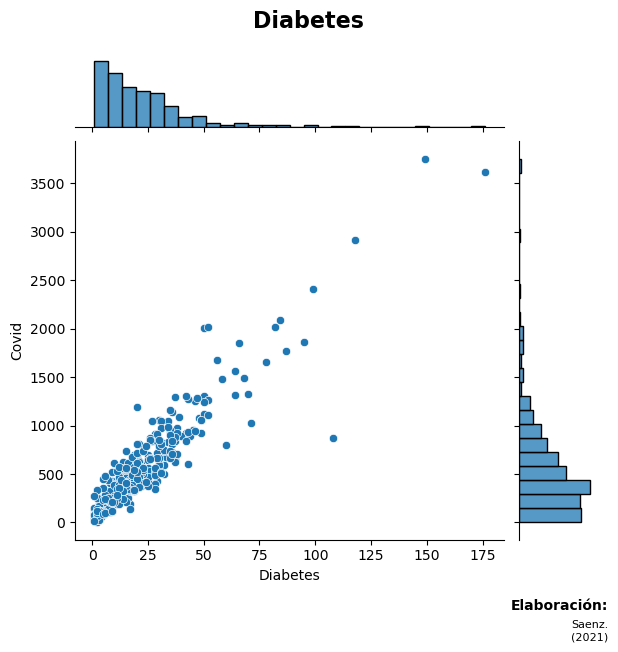

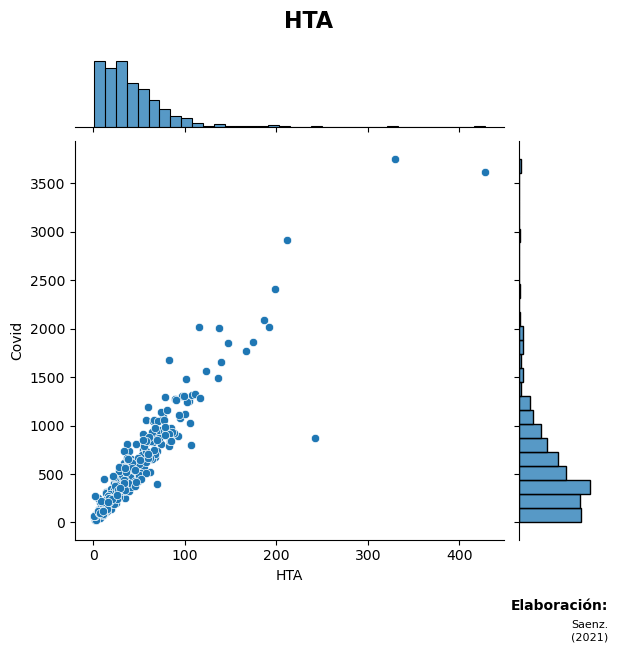

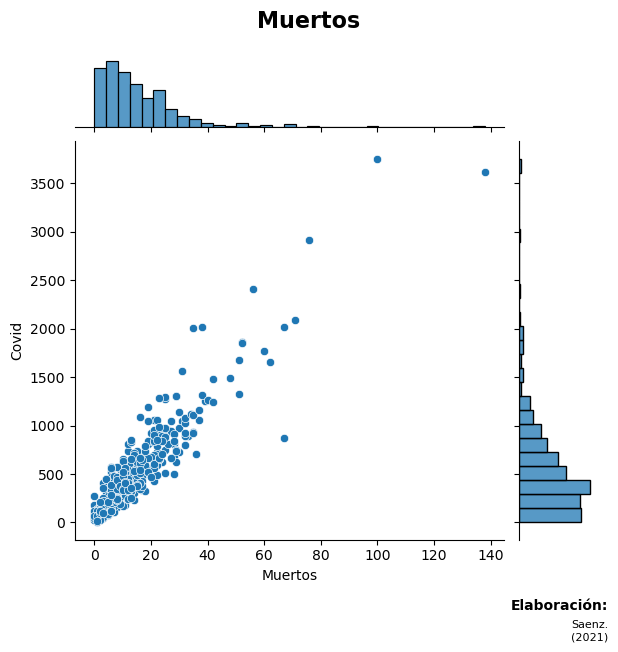

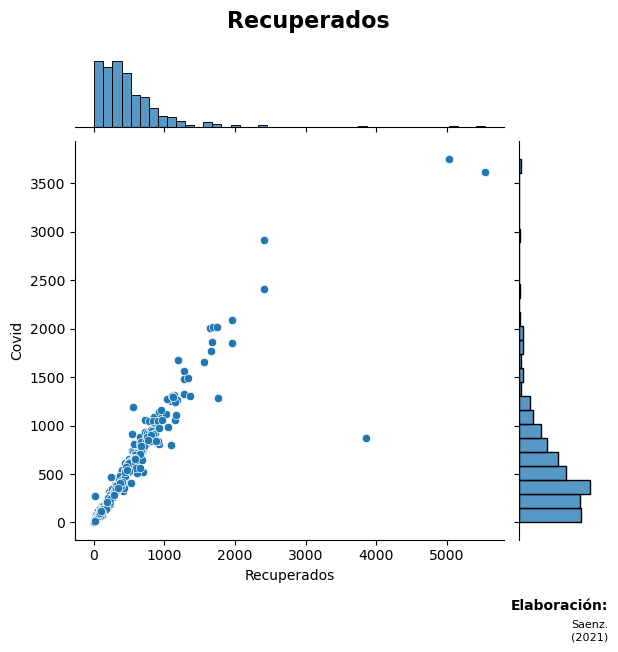

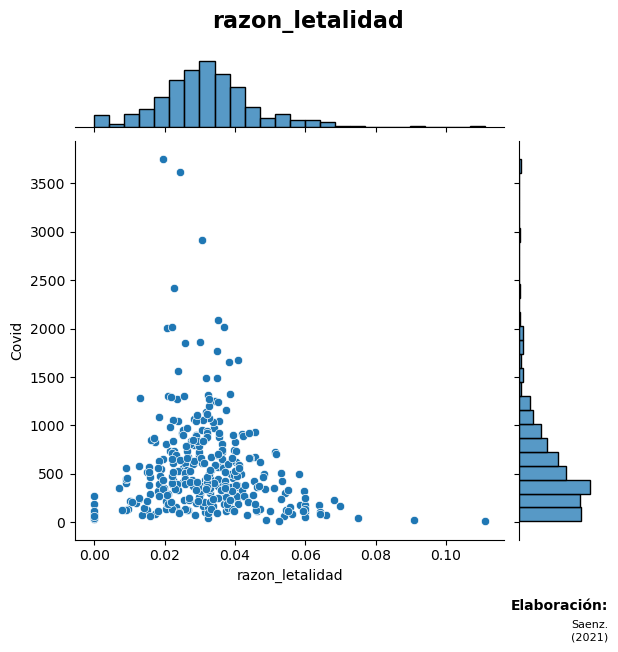

In [15]:
for i in Datos_econ_cali.columns[5:72]:
    var = i
    data = pd.concat([Datos_econ_cali['Covid'], Datos_econ_cali[var]], axis=1)
    g = sns.jointplot(x = var, y = "Covid", data = data)
    g.fig.suptitle(i, fontsize = 16, fontweight = "bold")
    plt.subplots_adjust(top=0.9)
    g.fig.text(1,-.02, "Elaboración:", fontsize = 10, fontweight = "bold", ha = "right")
    g.fig.text(1,-.07, "Saenz.\n(2021)", fontsize = 8, ha = "right")
    plt.show()

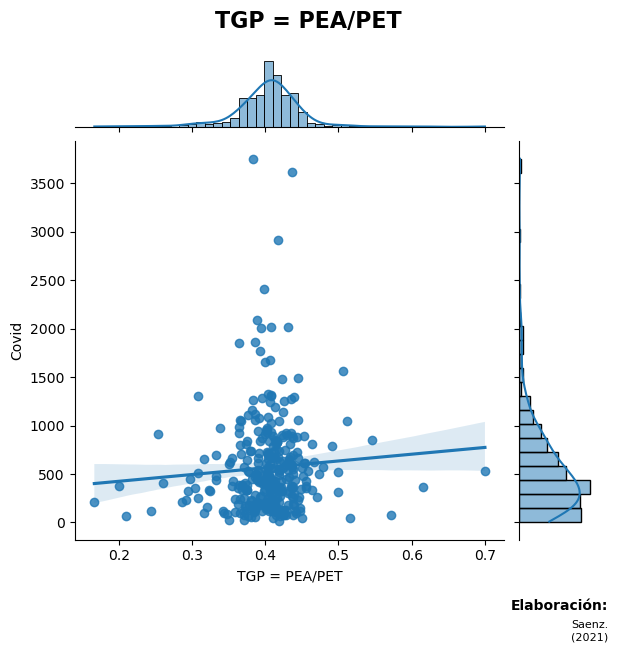

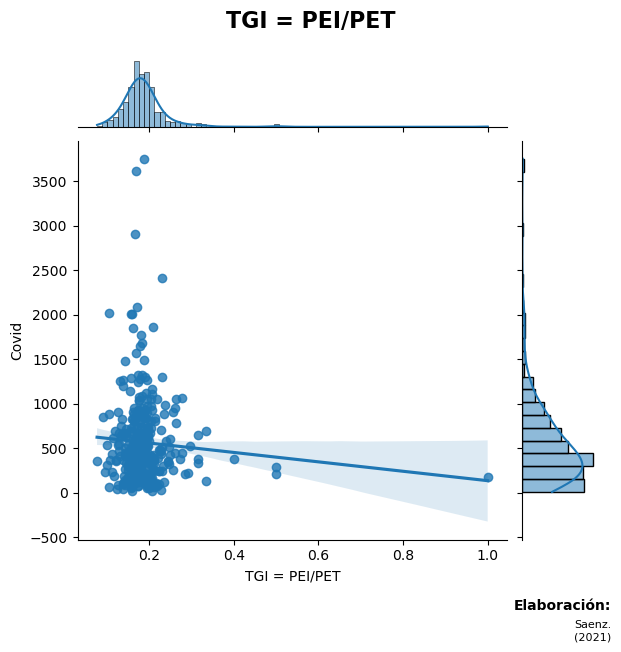

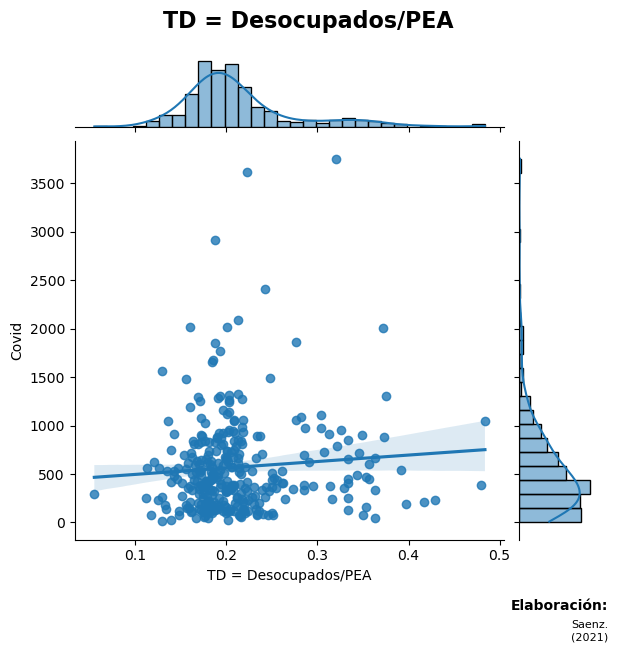

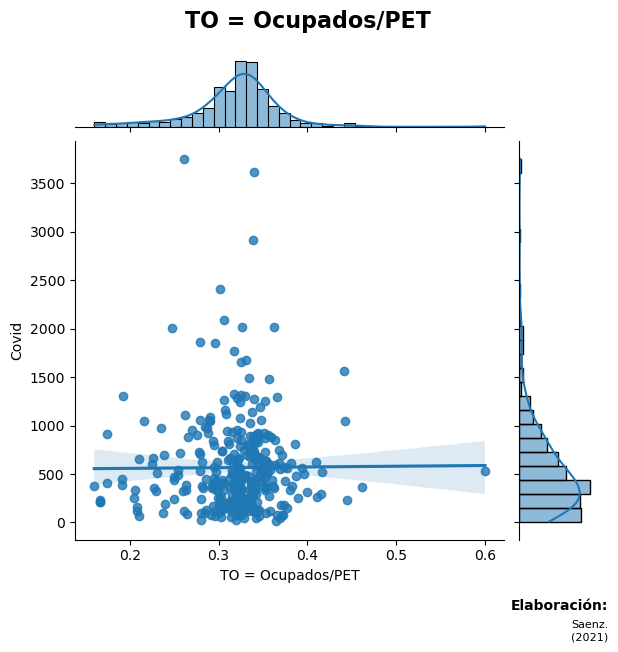

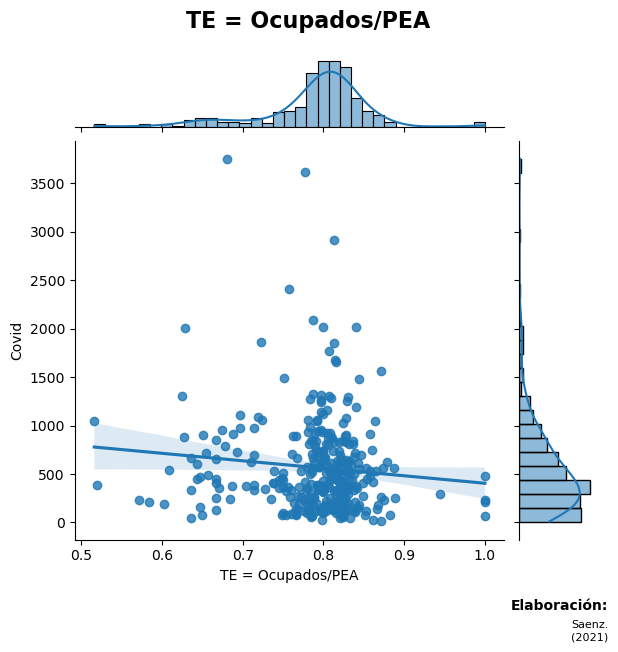

...

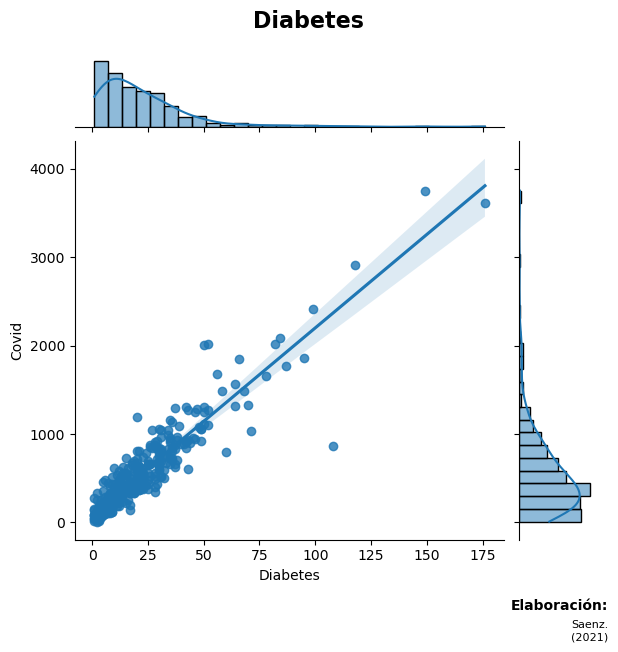

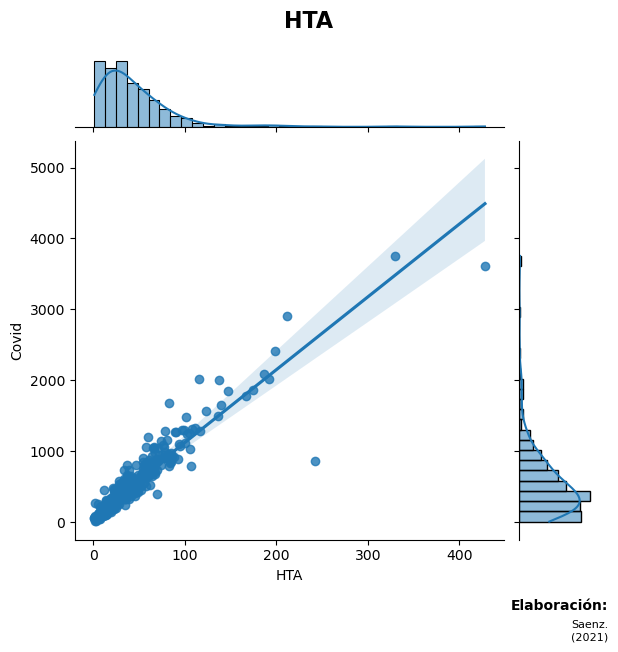

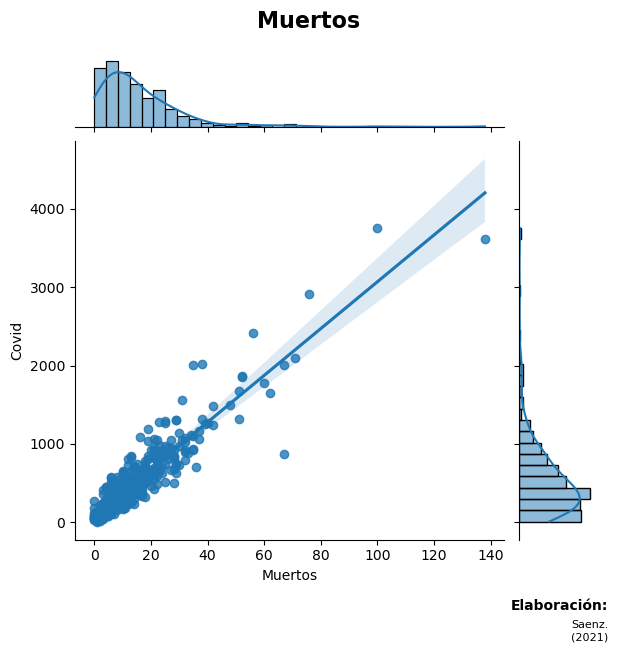

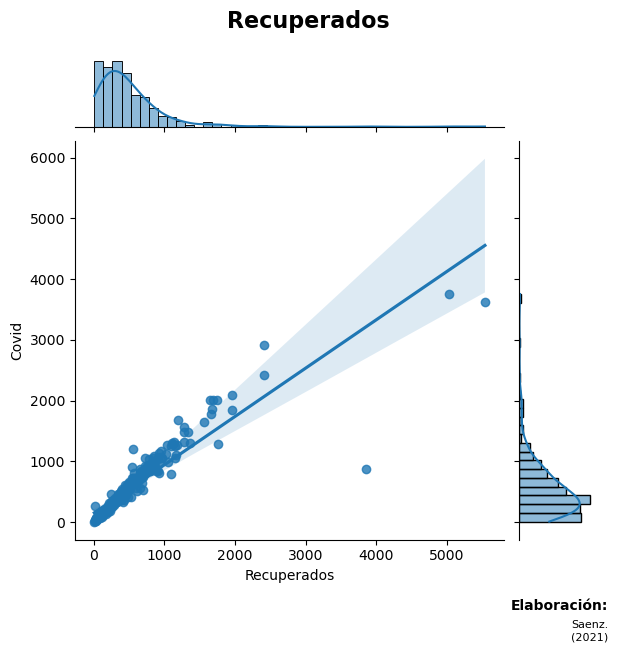

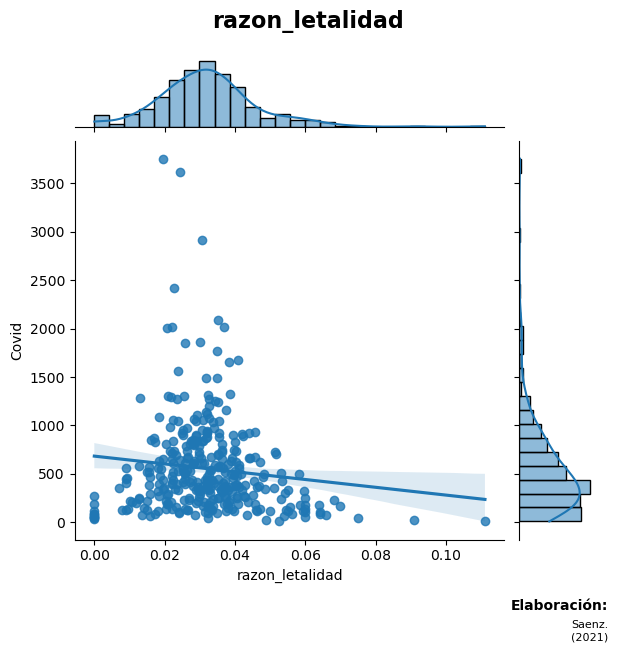

In [16]:
for i in Datos_econ_cali.columns[5:72]:
    var = i
    data = pd.concat([Datos_econ_cali['Covid'], Datos_econ_cali[var]], axis=1)
    g = sns.jointplot(x = var, y = "Covid", data = data, kind = "reg")
    g.fig.suptitle(i, fontsize = 16, fontweight = "bold")
    plt.subplots_adjust(top=0.9)
    g.fig.text(1,-.02, "Elaboración:", fontsize = 10, fontweight = "bold", ha = "right")
    g.fig.text(1,-.07, "Saenz.\n(2021)", fontsize = 8, ha = "right")
    plt.show()

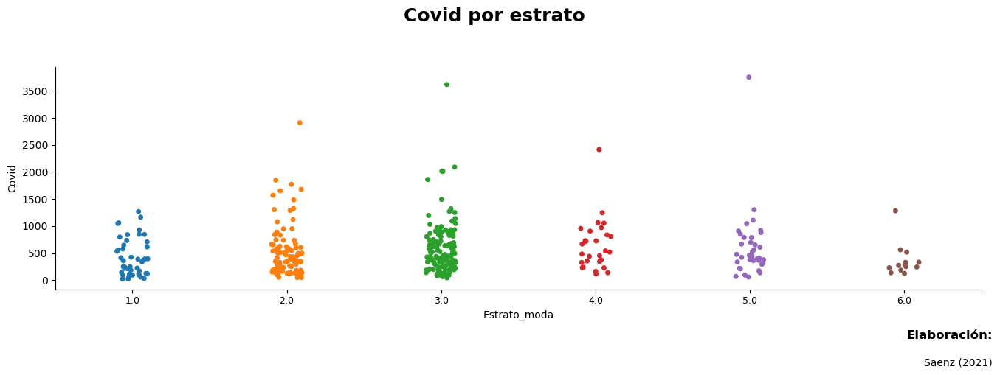

In [17]:
#Análisis con la variable Estrato:
g = sns.catplot(x = "Estrato_moda", y = "Covid", height = 4.5, aspect = 3, data = Datos_econ_cali)
g.fig.suptitle("Covid por estrato", fontsize = 18, fontweight = "bold")
for ax in g.axes.flat:
    ax.set_xticklabels(ax.get_xticklabels(), fontsize=9)
plt.subplots_adjust(top=0.8)
g.fig.text(1,-.02, "Elaboración:", fontsize = 12, fontweight = "bold", ha = "right")
g.fig.text(1,-.1, "Saenz (2021)", fontsize = 10, ha = "right")
plt.show()

In [18]:
Cali = geopandas.read_file('databases_and_shapefiles/Barrios Cali.zip')
Cali = Cali.to_crs(epsg=4326)
Mapas_VarCali = Cali.merge(Datos_econ_cali, left_on='NOMBRE', right_on=Datos_econ_cali['NOMBRE'],how='left')
Mapas_VarCali = geopandas.GeoDataFrame(Mapas_VarCali, geometry='geometry_x')

<AxesSubplot:>

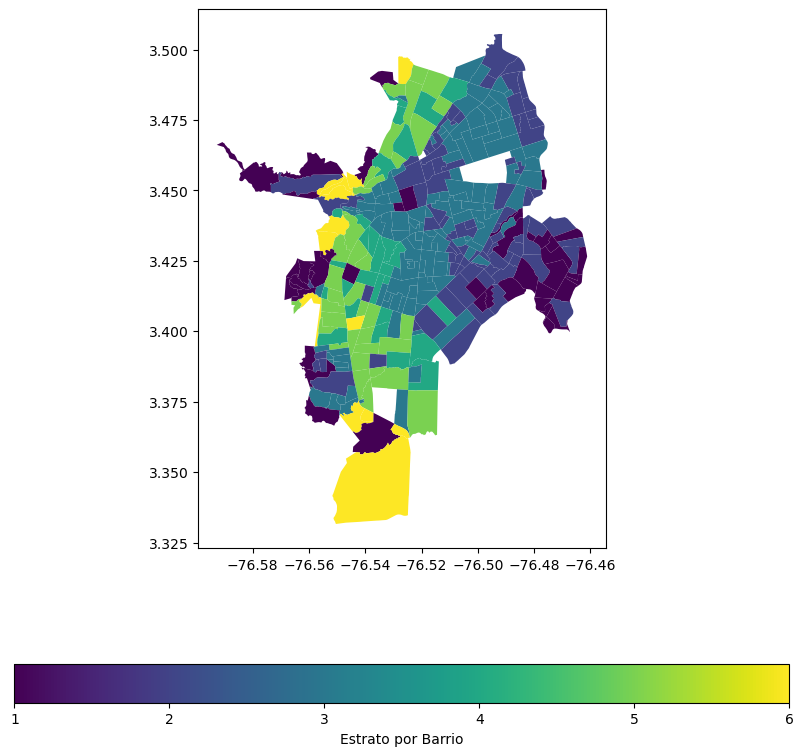

In [19]:
fig, ax = plt.subplots(1, 1,figsize=(10, 10))
Mapas_VarCali.plot(column='Estrato_moda', ax=ax, legend=True, 
                   legend_kwds={'label': "Estrato por Barrio",'orientation': "horizontal"})

In [20]:
Mapas_VarCali.iloc[:,79]

0      2910.0
1      1092.0
2       136.0
3       411.0
4       905.0
        ...  
333     272.0
334     286.0
335     844.0
336     561.0
337    1282.0
Name: Covid, Length: 338, dtype: float64

C:\Users\Juan Pablo\AppData\Local\Temp\ipykernel_17808\4234076875.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1, 1,figsize=(10, 10))


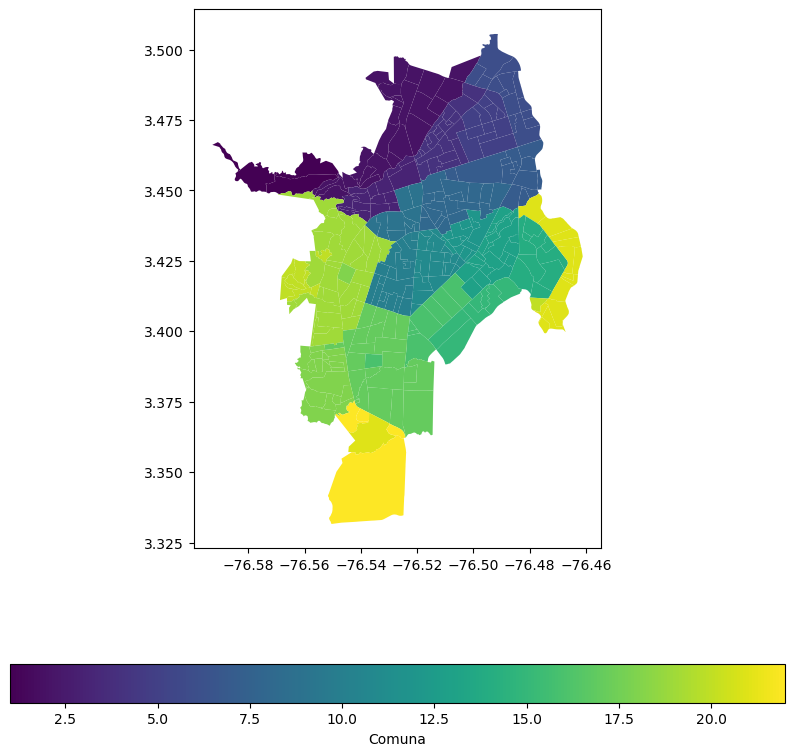

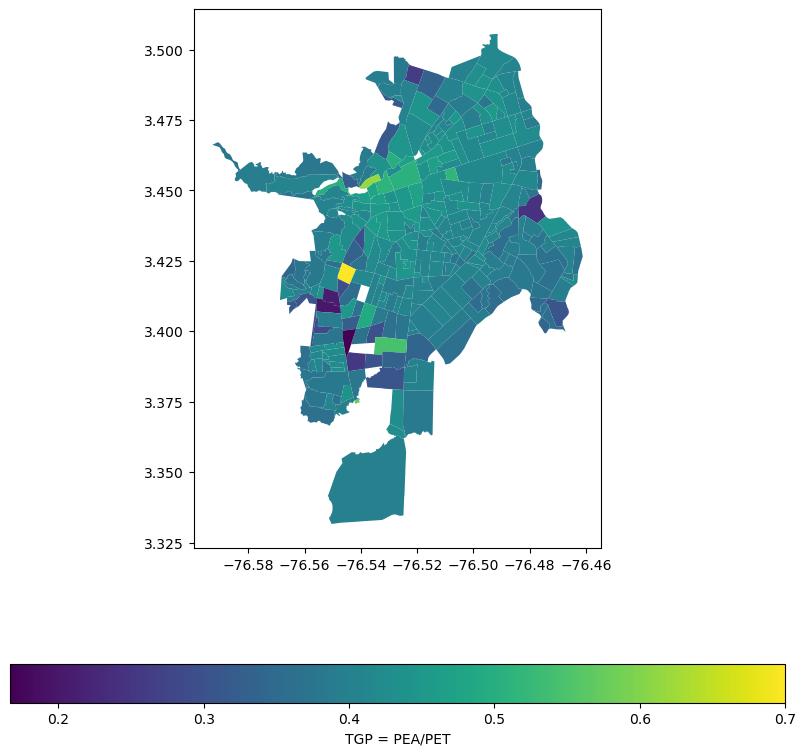

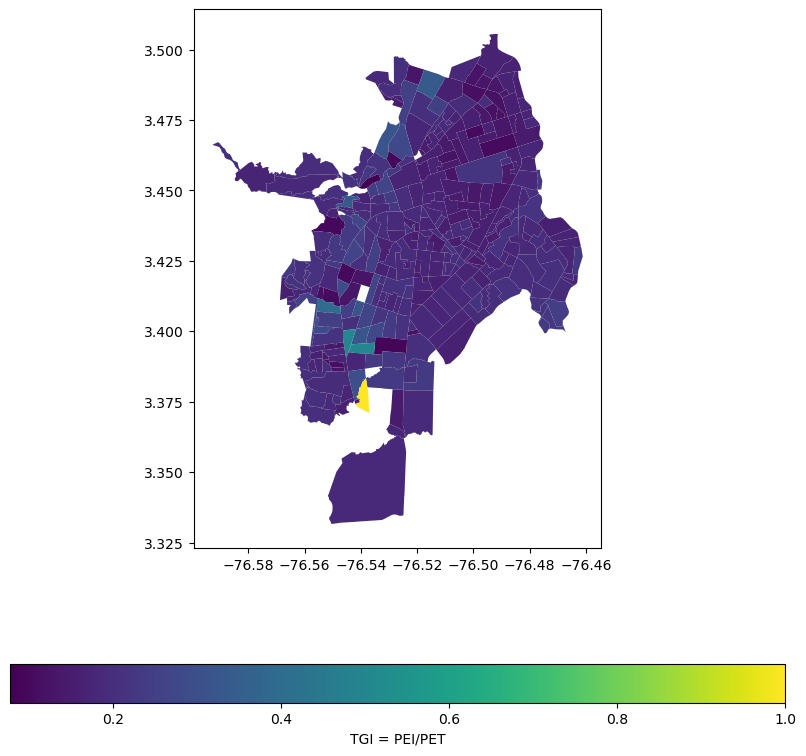

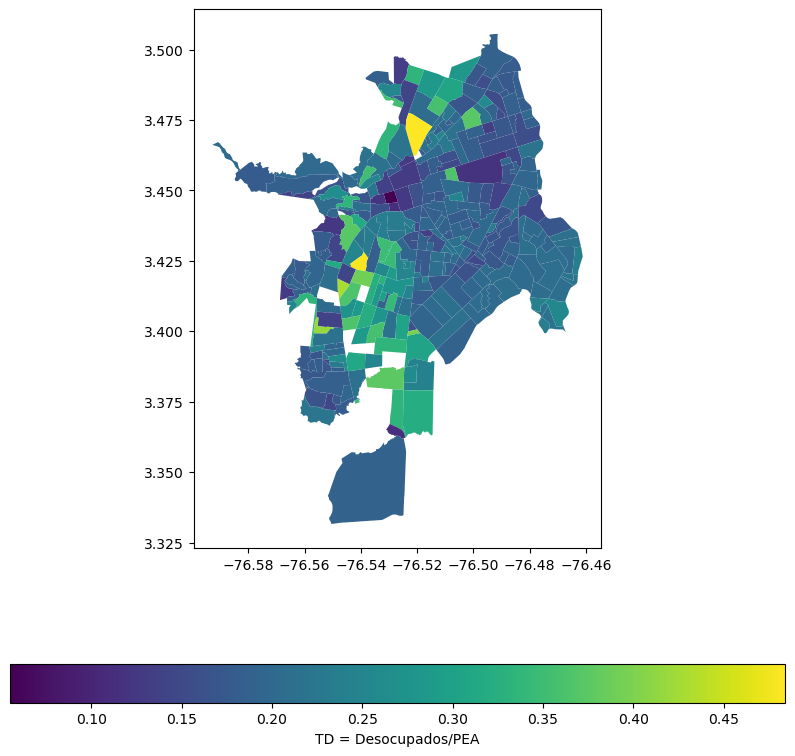

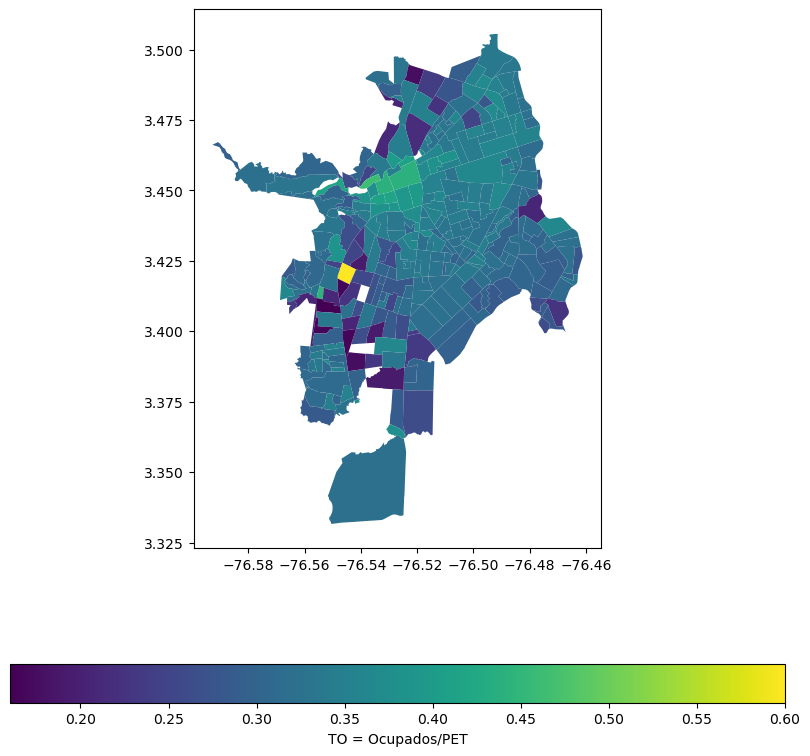

...

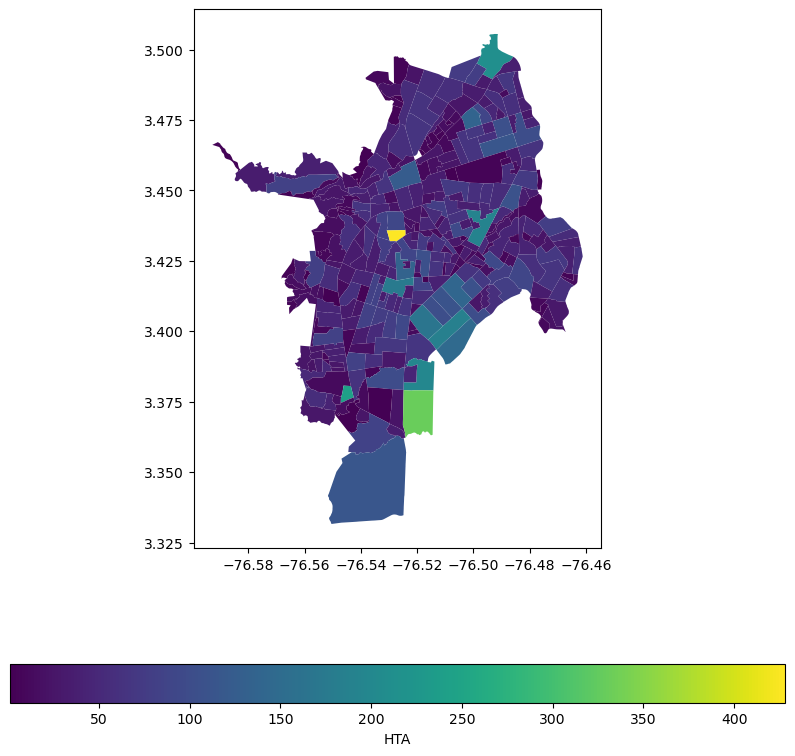

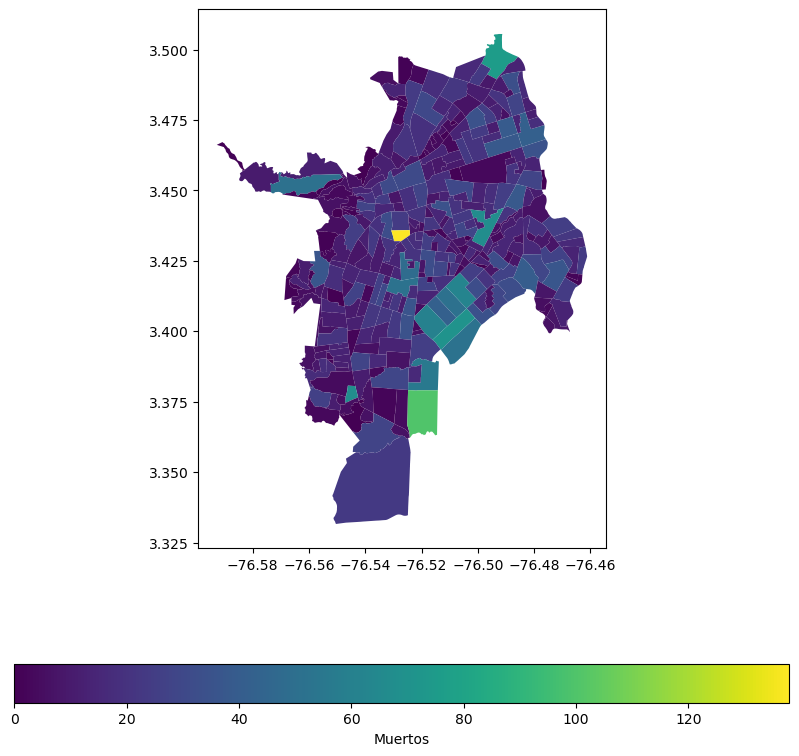

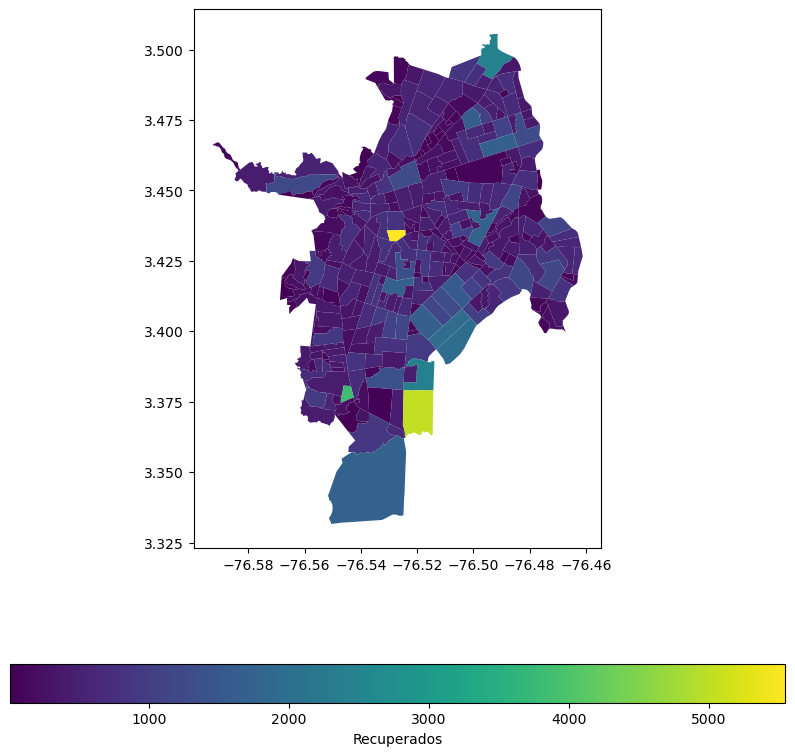

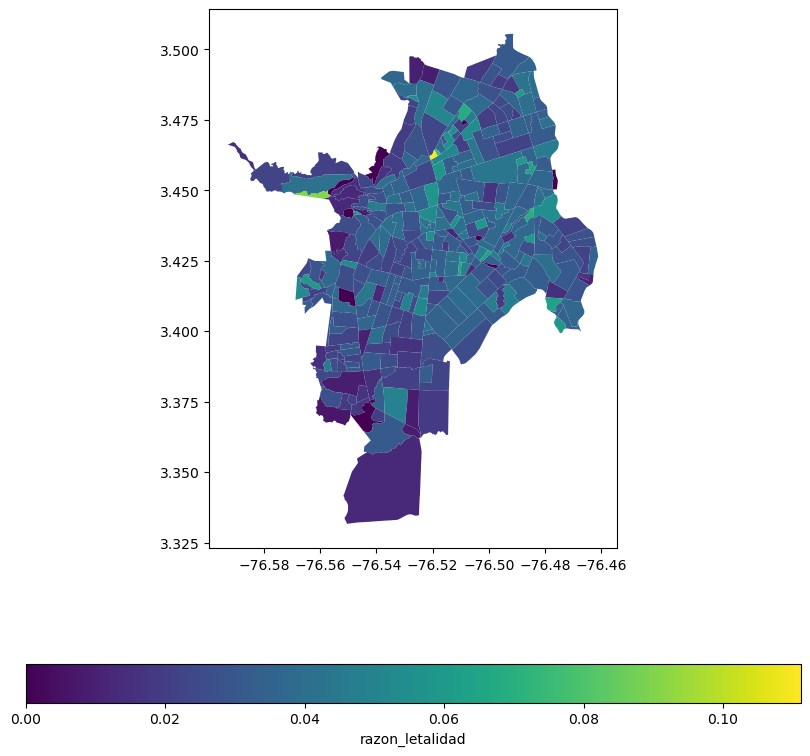

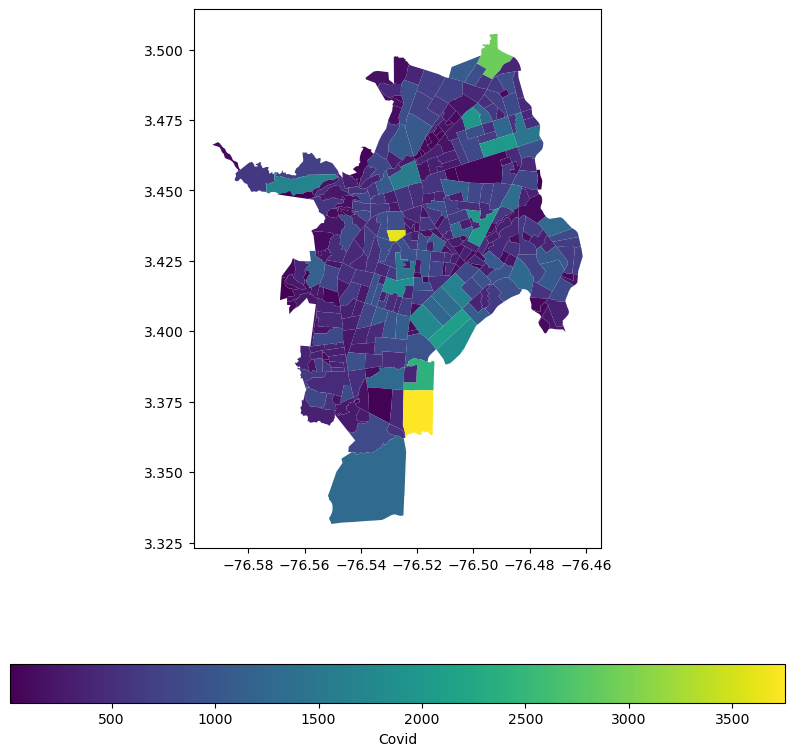

In [21]:
for i in Mapas_VarCali.columns[11:80]: #138
    var2 = i
    data2 = pd.concat([Mapas_VarCali['Covid'], Mapas_VarCali[var2]], axis=1)
    fig, ax = plt.subplots(1, 1,figsize=(10, 10))
    Mapas_VarCali.plot(column=var2, ax=ax, legend=True, legend_kwds={'label': var2,'orientation': "horizontal"})

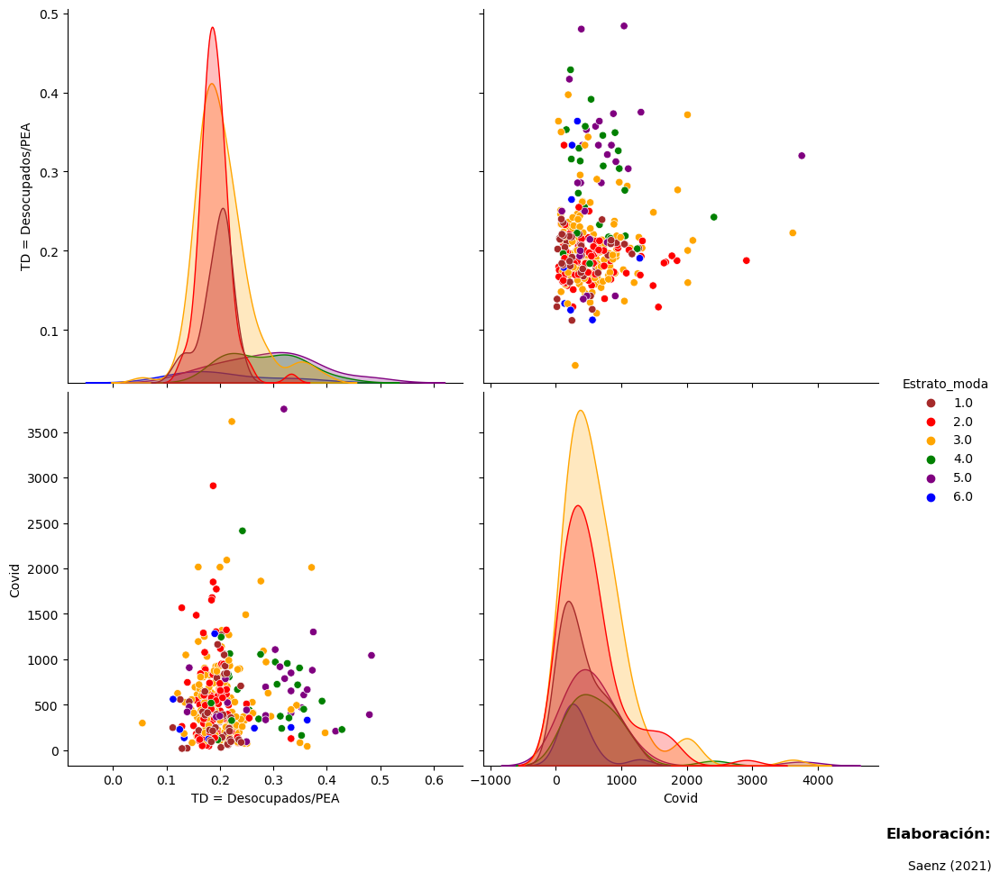

In [22]:
## Variables categóricas 
# Estrato moda 
pal = {1.0:"brown", 2.0:"red", 3.0: "orange", 4.0: "green", 5.0: "purple", 6.0: "blue"}
g = sns.pairplot(Datos_econ_cali, vars = ['TD = Desocupados/PEA', 'Covid'], hue = 'Estrato_moda', palette = pal, height=5) #, hue_order = ["1", "2", "3", "4", "5", "6"]
#g.fig.suptitle("Relación entre pares de variables", fontsize = 20, ontweight = "bold")
plt.subplots_adjust(top=0.9)
g.fig.text(1,-.02, "Elaboración:", fontsize = 12, fontweight = "bold", ha = "right")
g.fig.text(1,-.055, "Saenz (2021)", fontsize = 10, ha = "right")
plt.show()

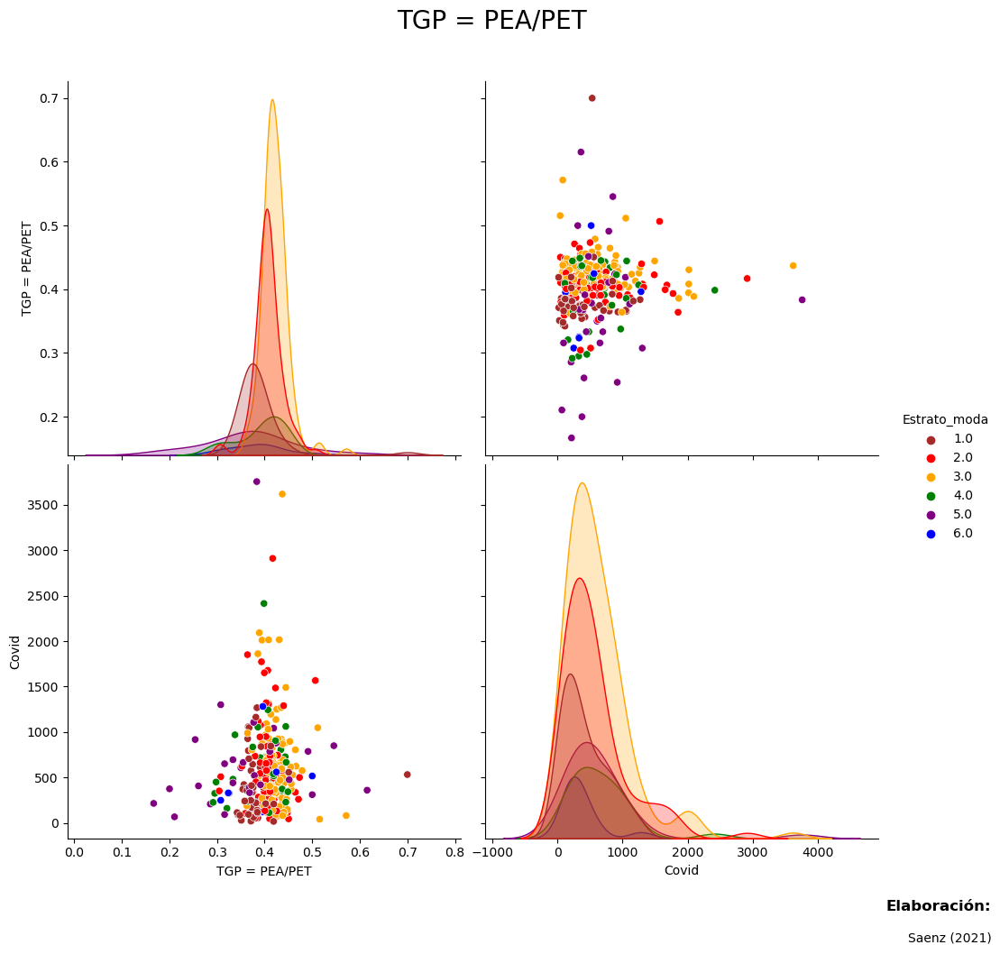

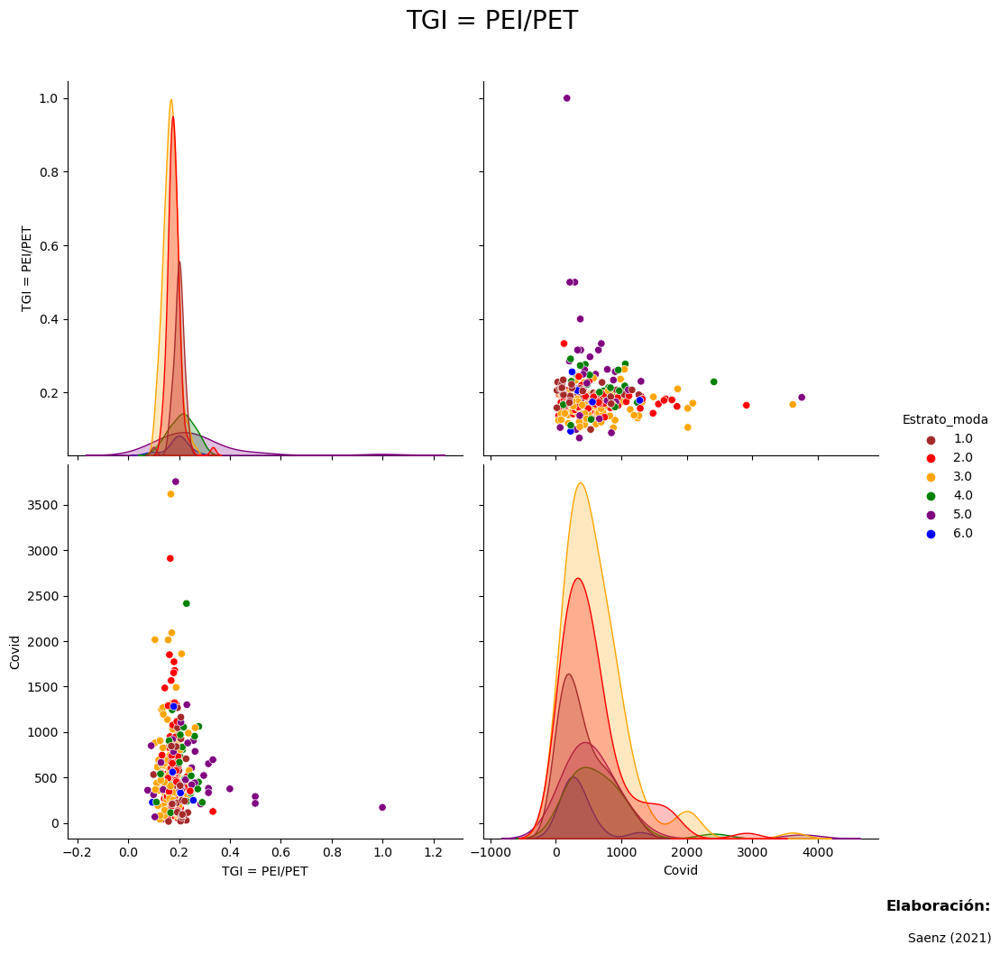

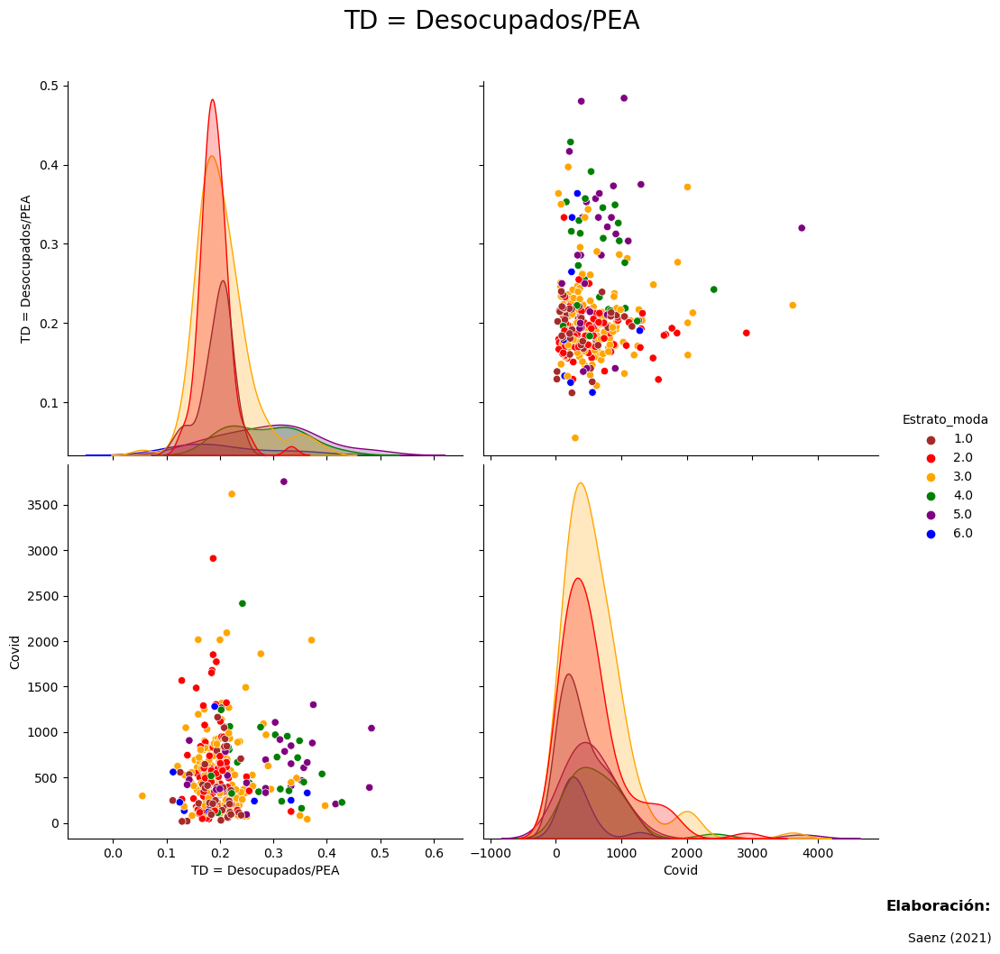

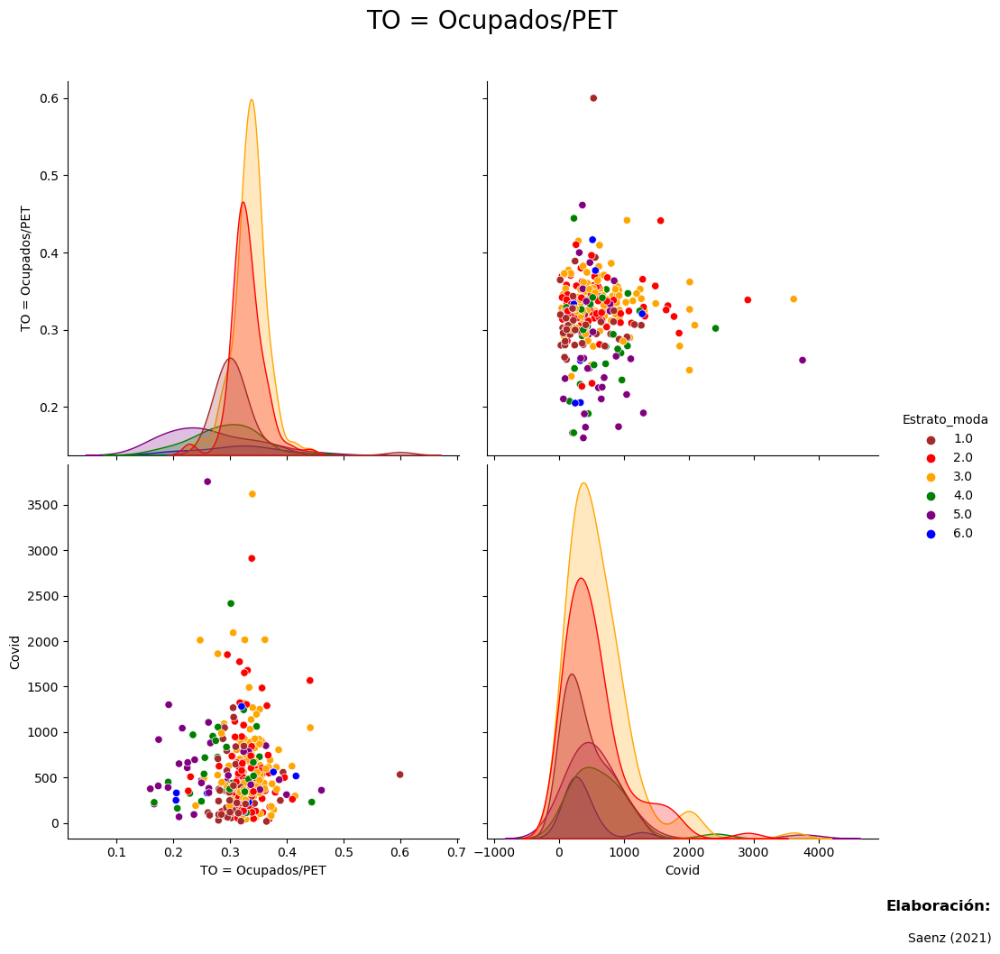

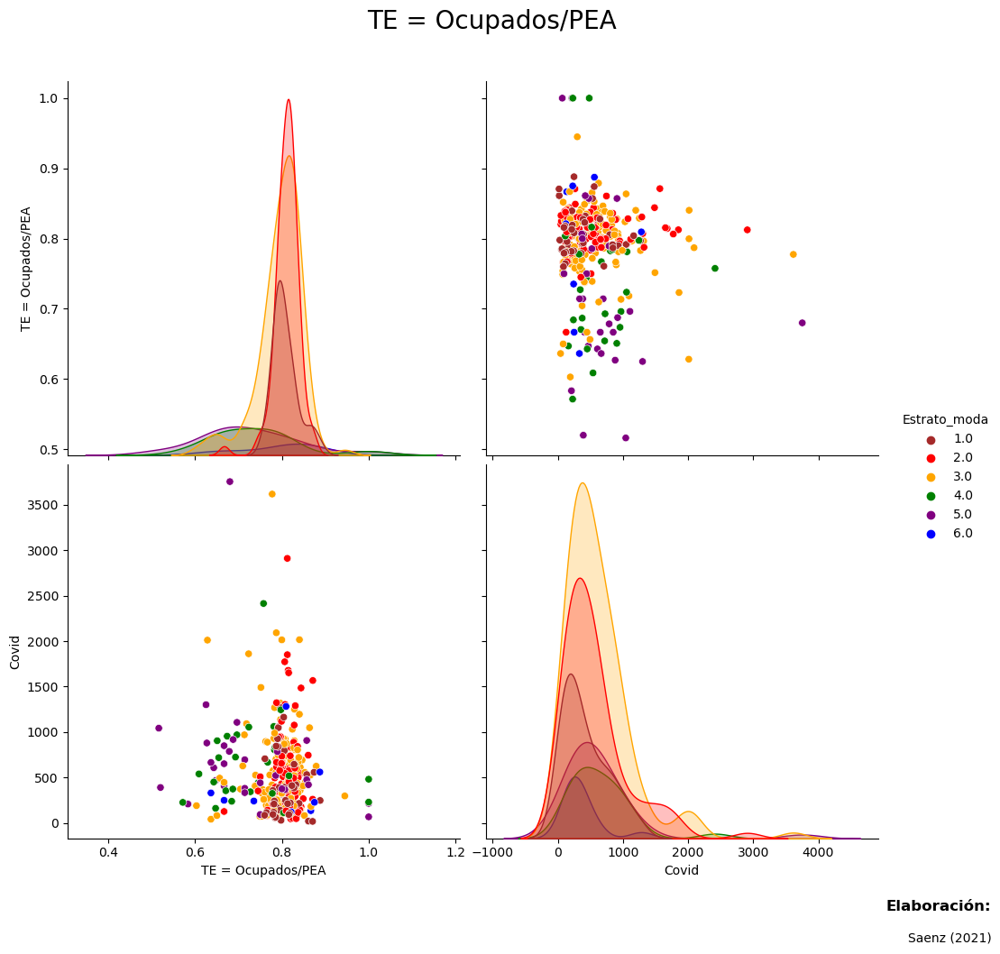

...

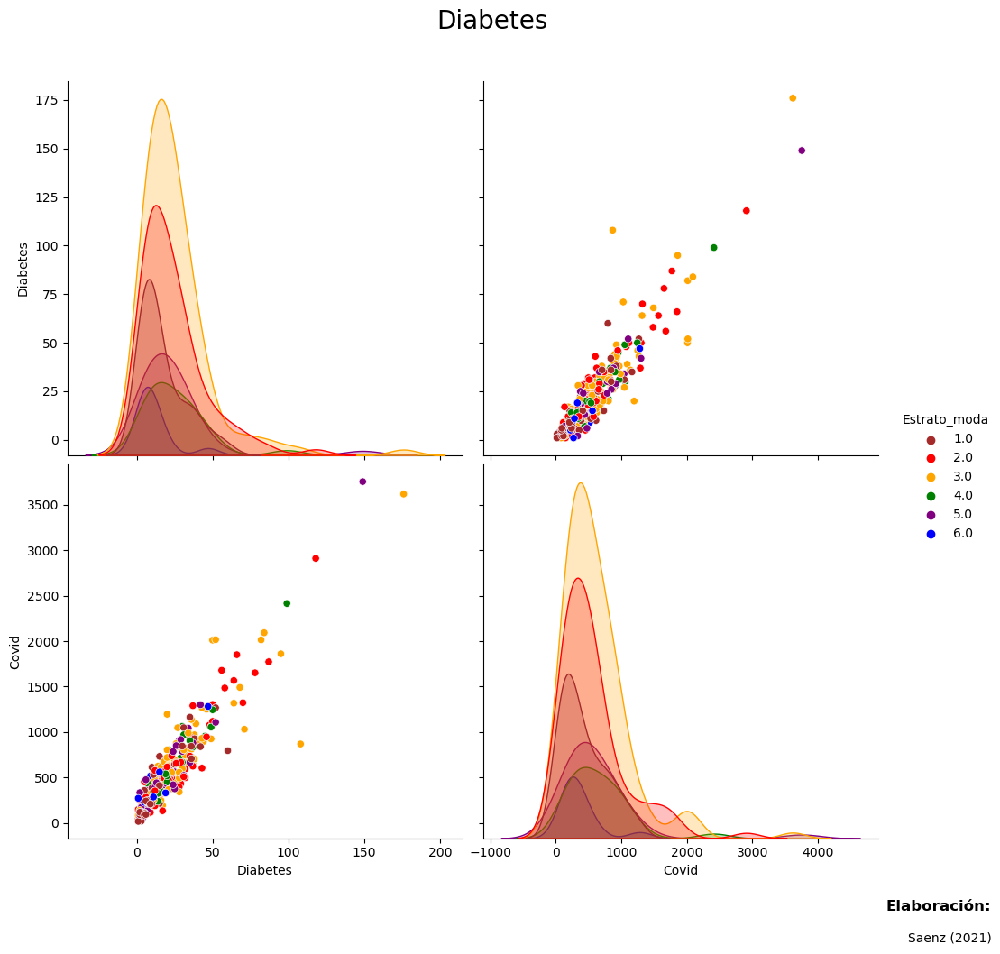

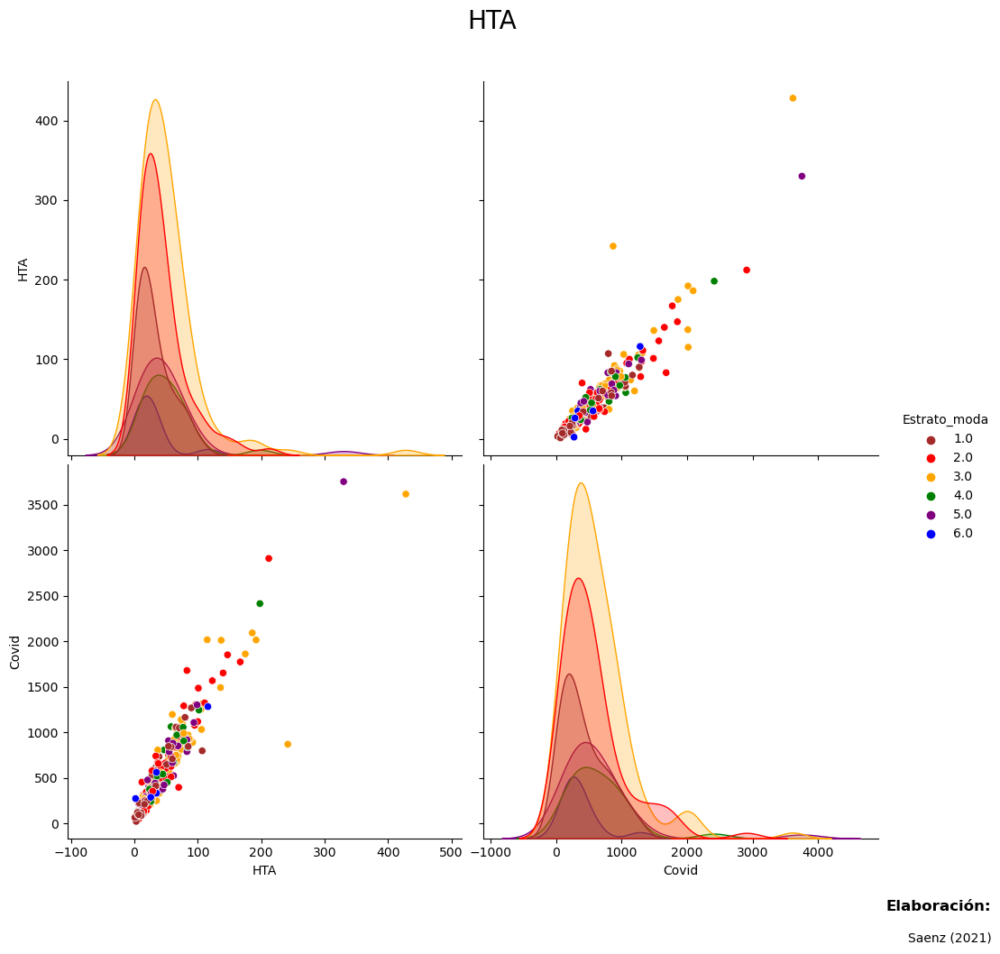

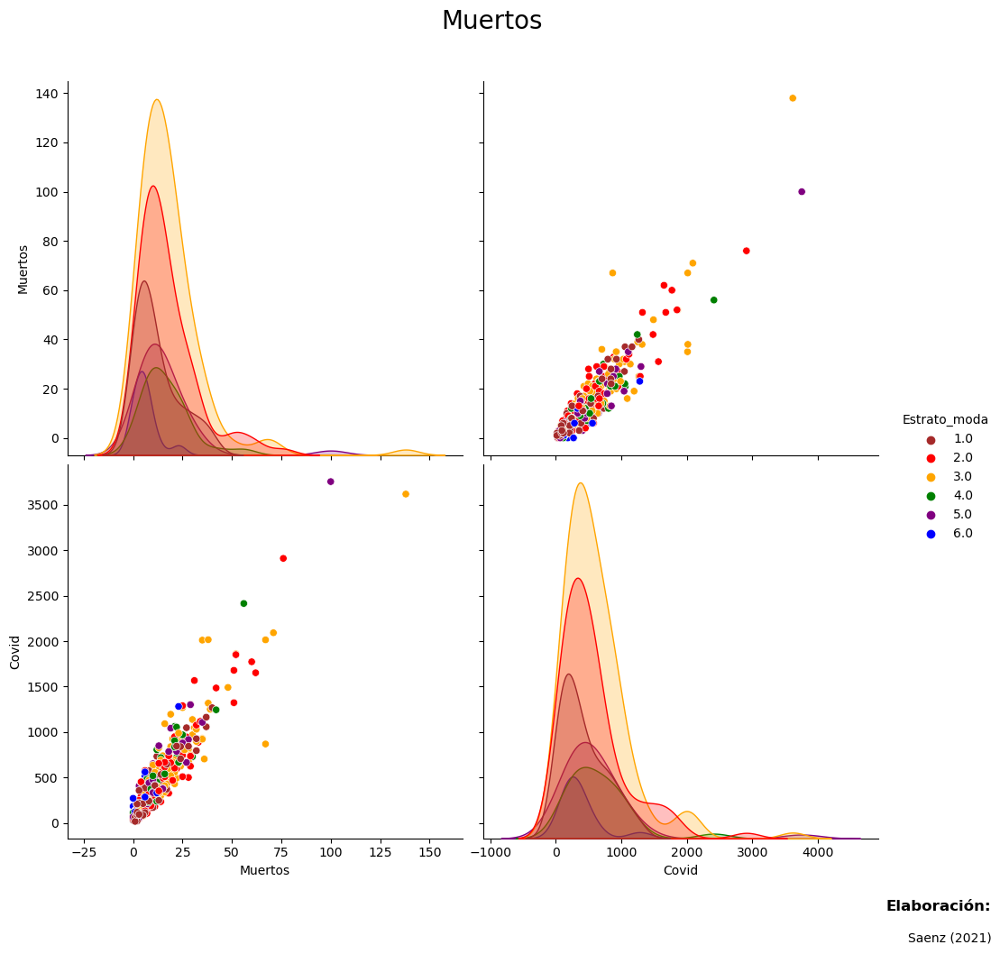

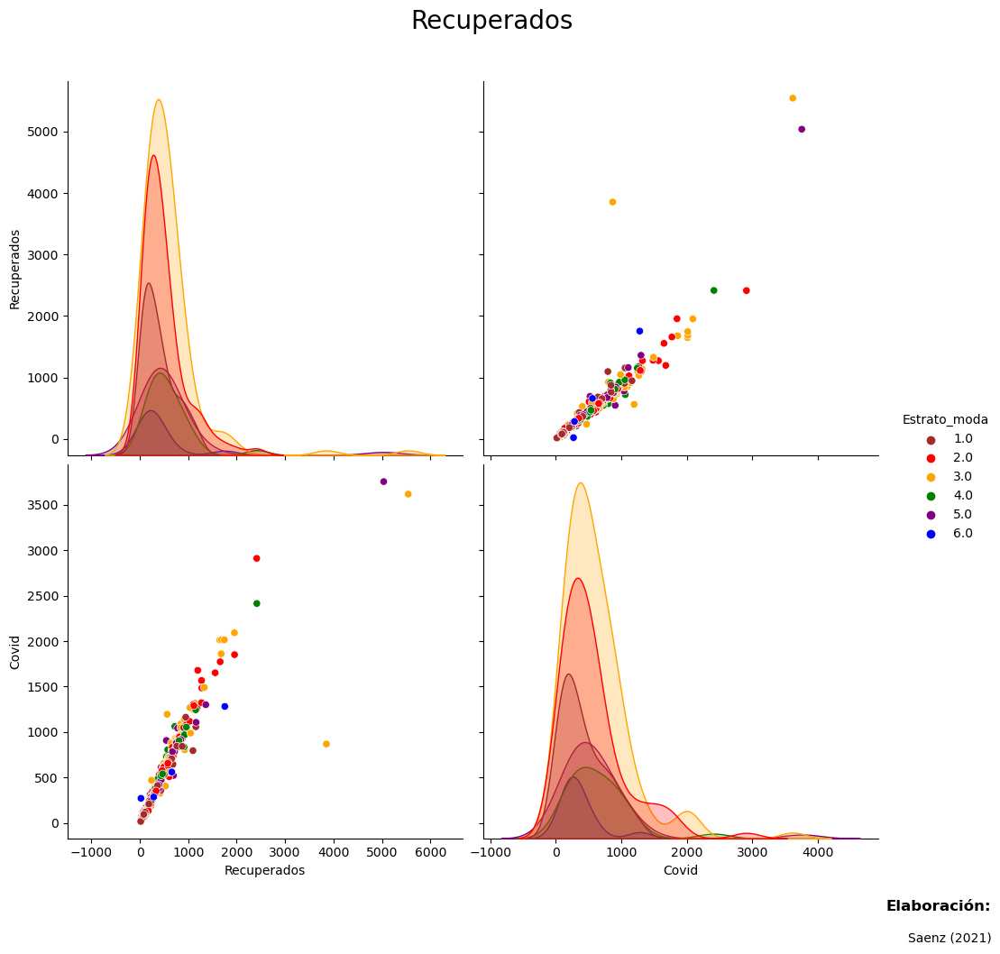

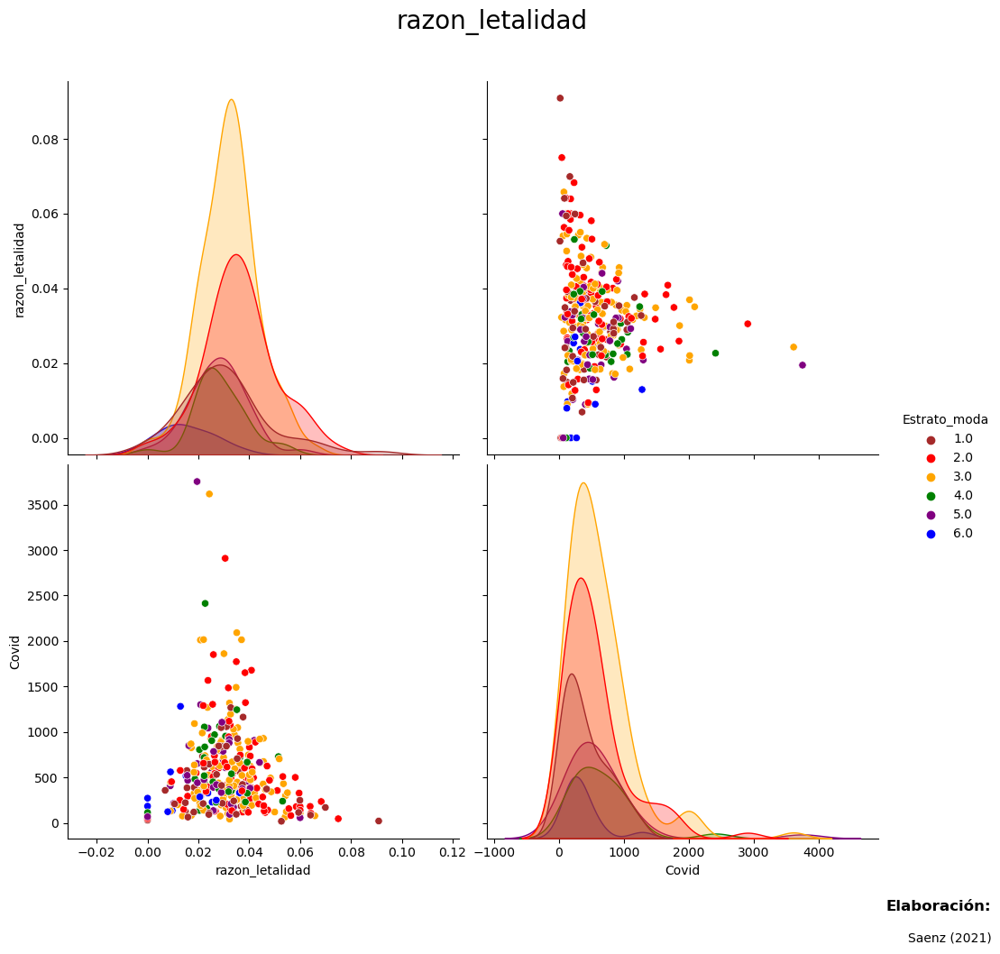

In [23]:
for i in Datos_econ_cali.columns[5:72]:
    g = sns.pairplot(Datos_econ_cali, vars = [i, 'Covid'], hue = 'Estrato_moda', palette = pal, height=5) #, hue_order = ["1", "2", "3", "4", "5", "6"]
    plt.subplots_adjust(top=0.9)
    g.fig.suptitle(i, fontsize = 20)
    g.fig.text(1,-.02, "Elaboración:", fontsize = 12, fontweight = "bold", ha = "right")
    g.fig.text(1,-.055, "Saenz (2021)", fontsize = 10, ha = "right")
    plt.show()

In [24]:
Datos_econ_cali.Estrato_moda.value_counts()

3.0    123
2.0     86
1.0     46
5.0     37
4.0     28
6.0     13
Name: Estrato_moda, dtype: int64

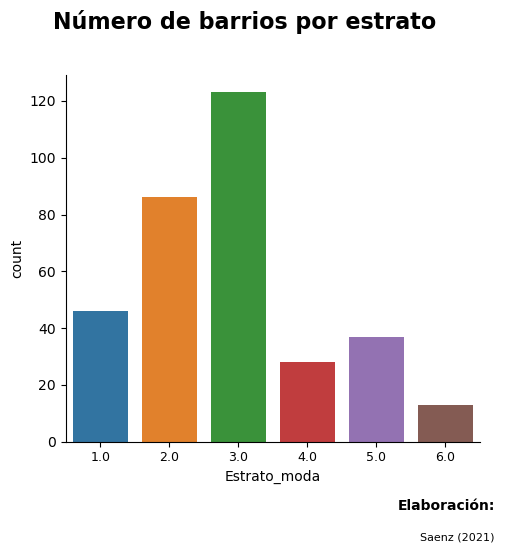

In [25]:
g = sns.catplot(x = "Estrato_moda", kind = "count", data = Datos_econ_cali)
g.fig.suptitle("Número de barrios por estrato", fontsize = 16, fontweight = "bold")
for ax in g.axes.flat:
    ax.set_xticklabels(ax.get_xticklabels(), fontsize=9)
plt.subplots_adjust(top=0.85)
g.fig.text(1,-.02, "Elaboración:", fontsize = 10, fontweight = "bold", ha = "right")
g.fig.text(1,-.08, "Saenz (2021)", fontsize = 8, ha = "right")
plt.show()

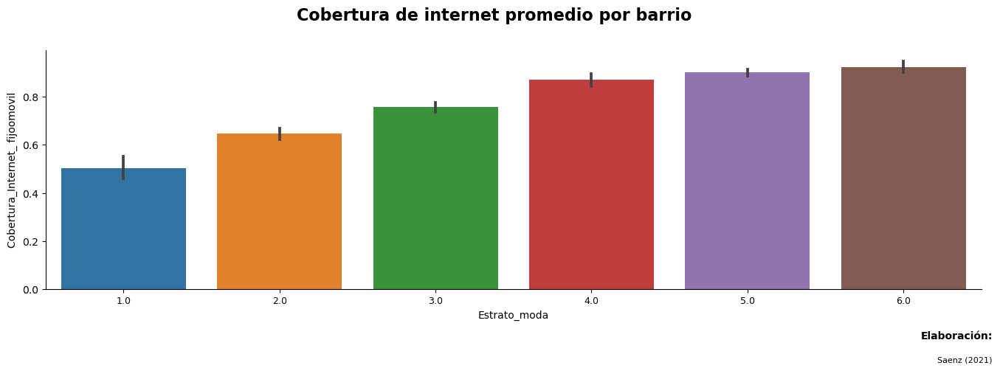

In [26]:
g = sns.catplot(x = "Estrato_moda", y = "Cobertura_Internet_ fijoomovil", kind = "bar", height = 4.5, aspect = 3, data = Datos_econ_cali)
g.fig.suptitle("Cobertura de internet promedio por barrio", fontsize = 16, fontweight = "bold")
for ax in g.axes.flat:
    ax.set_xticklabels(ax.get_xticklabels(), fontsize=9)
plt.subplots_adjust(top=0.85)
g.fig.text(1,-.02, "Elaboración:", fontsize = 10, fontweight = "bold", ha = "right")
g.fig.text(1,-.09, "Saenz (2021)", fontsize = 8, ha = "right")
plt.show()

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


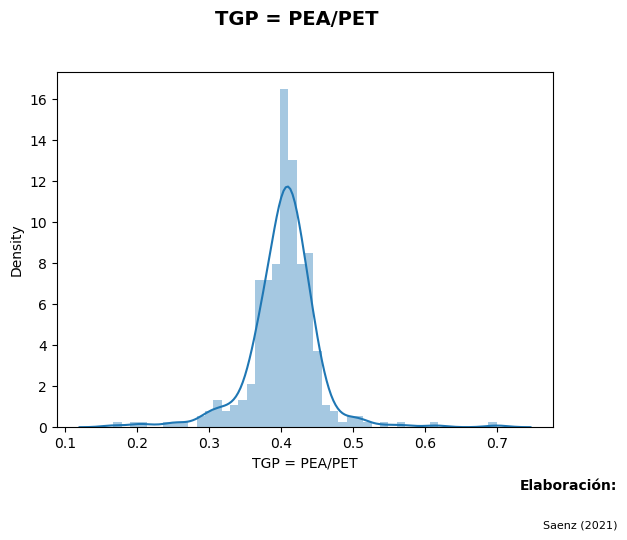

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


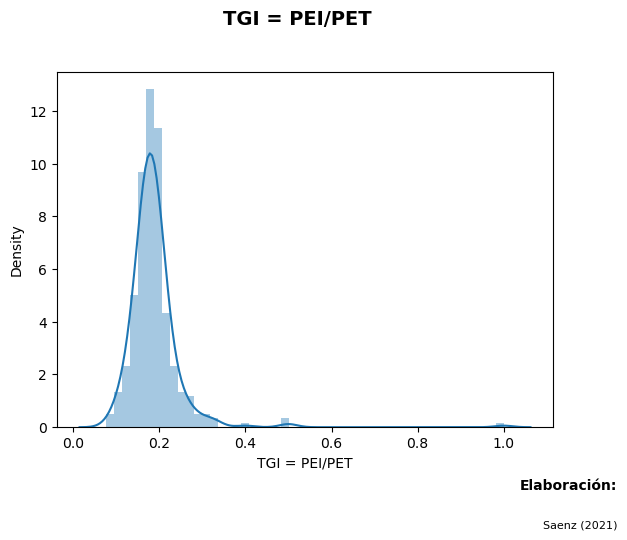

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


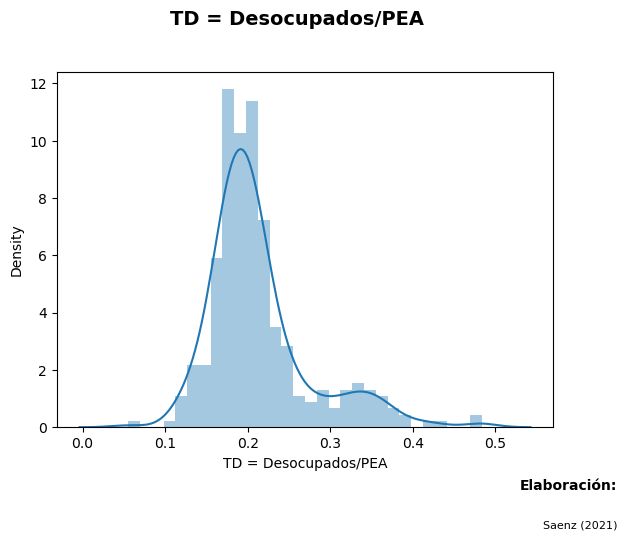

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


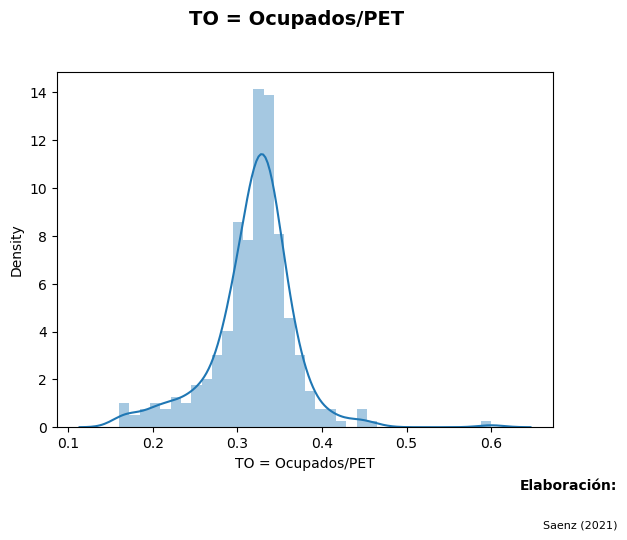

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


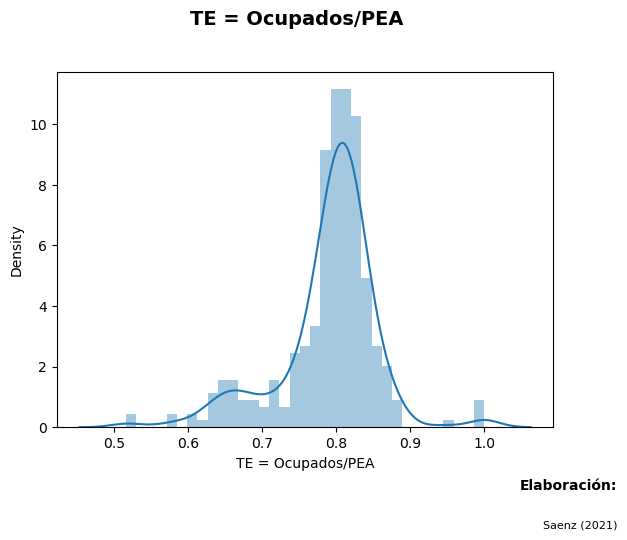

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


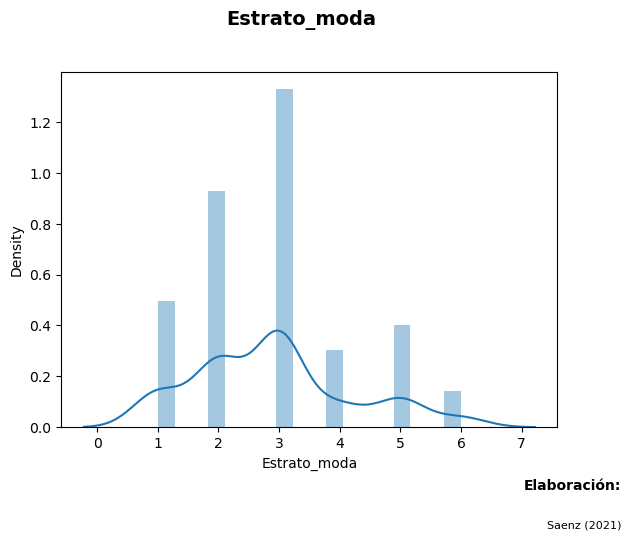

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


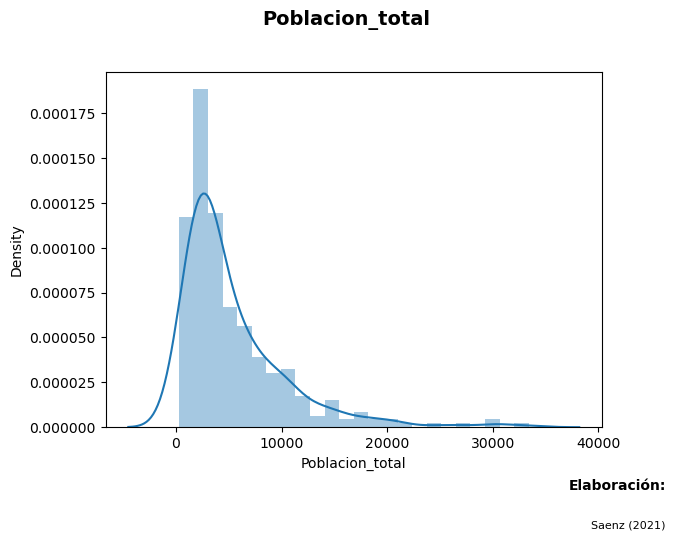

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


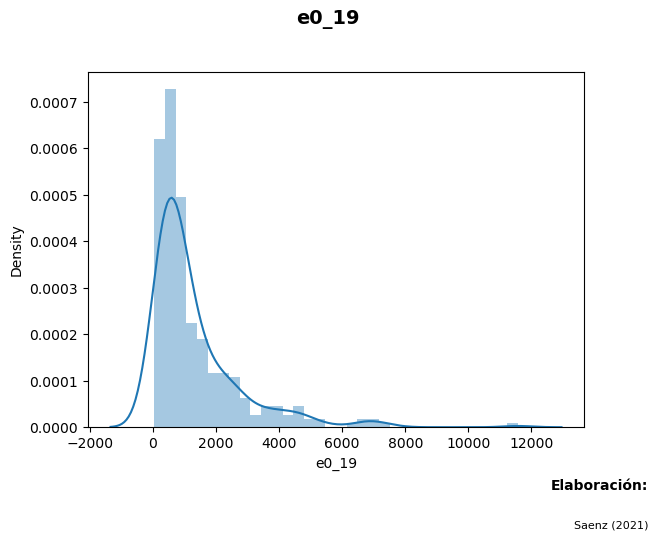

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


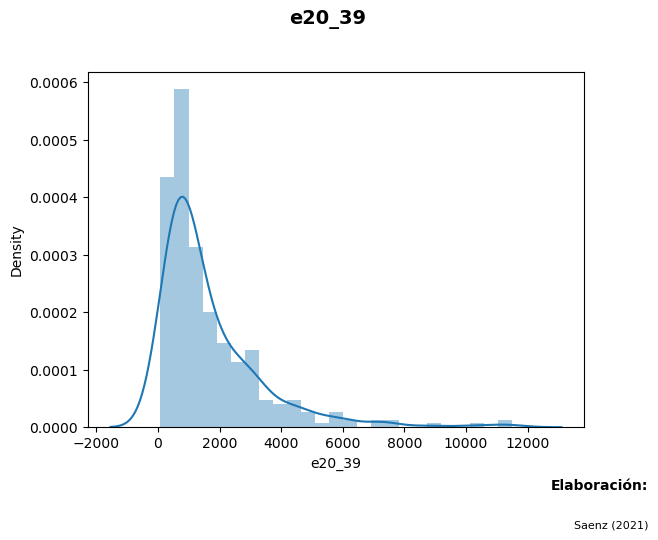

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


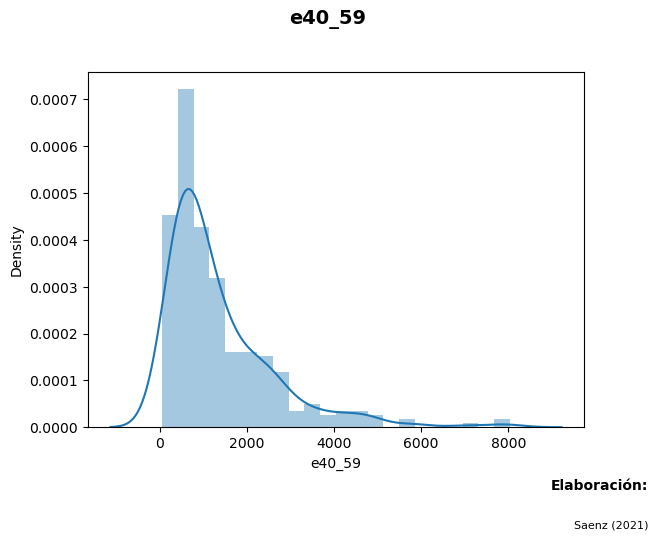

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


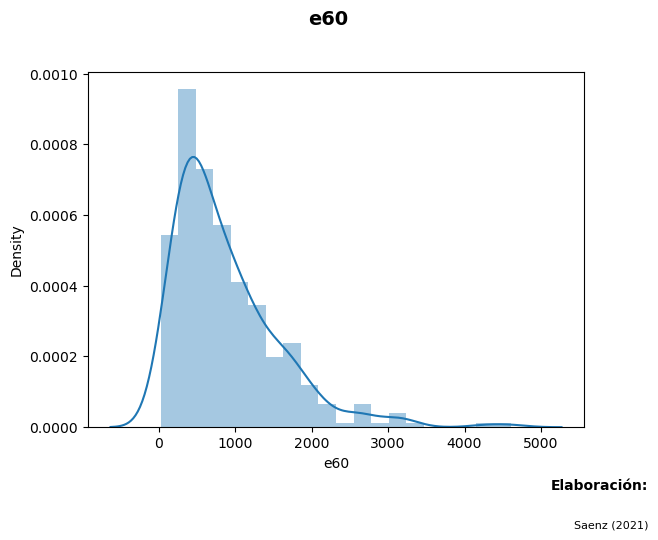

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


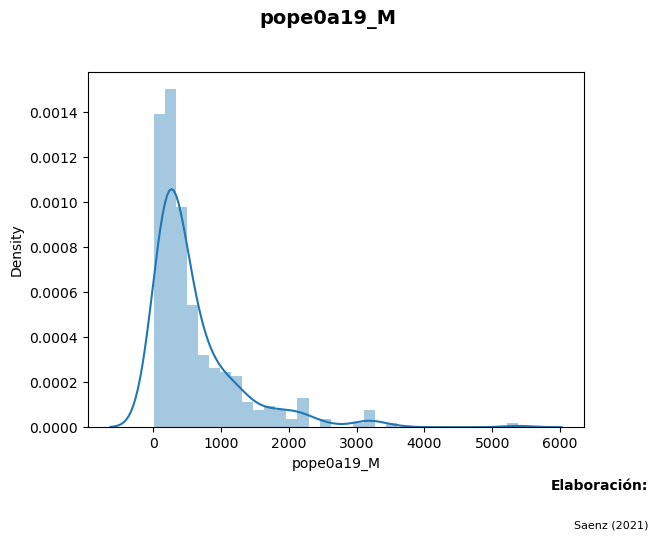

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


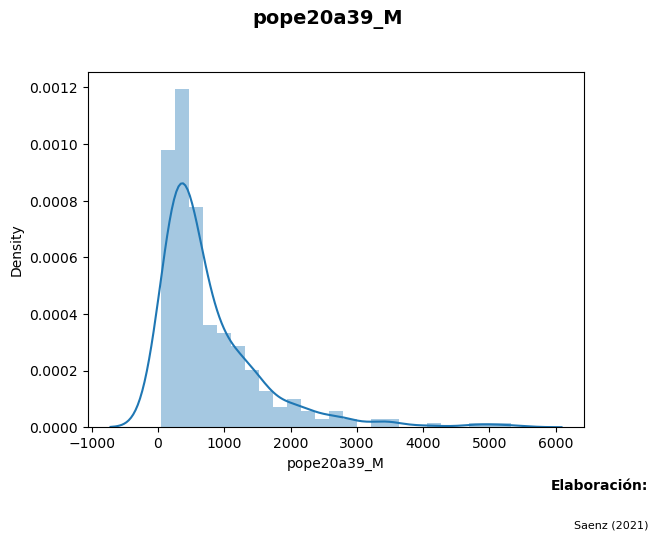

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


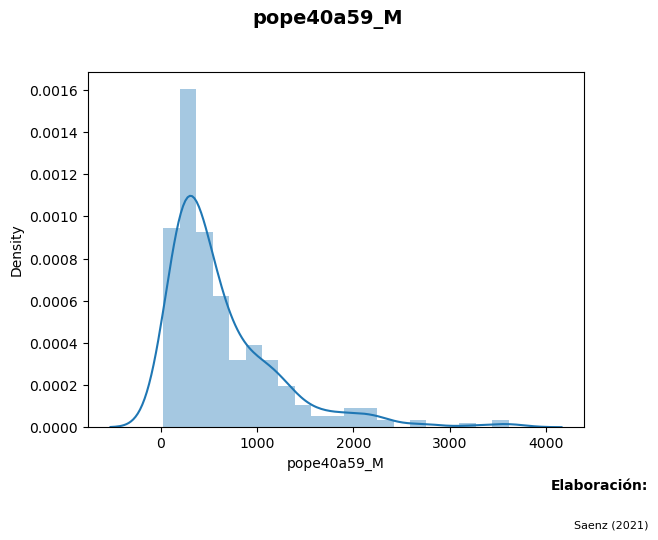

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


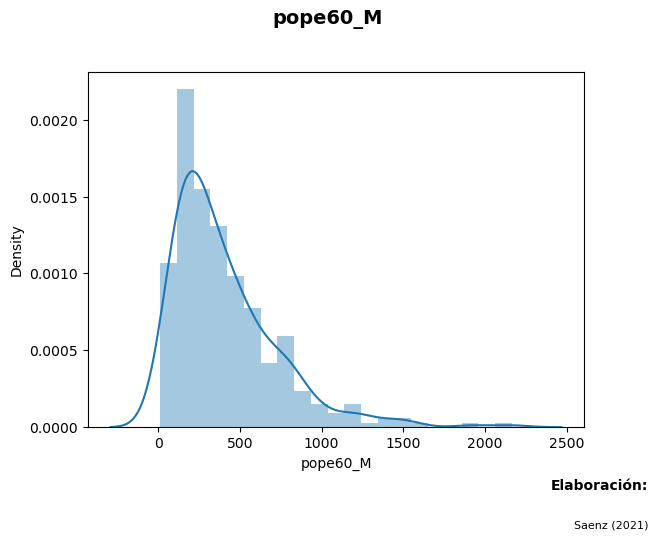

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


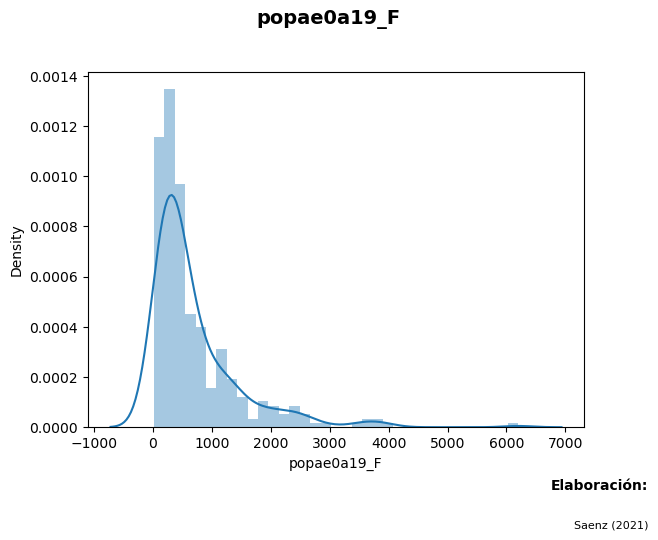

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


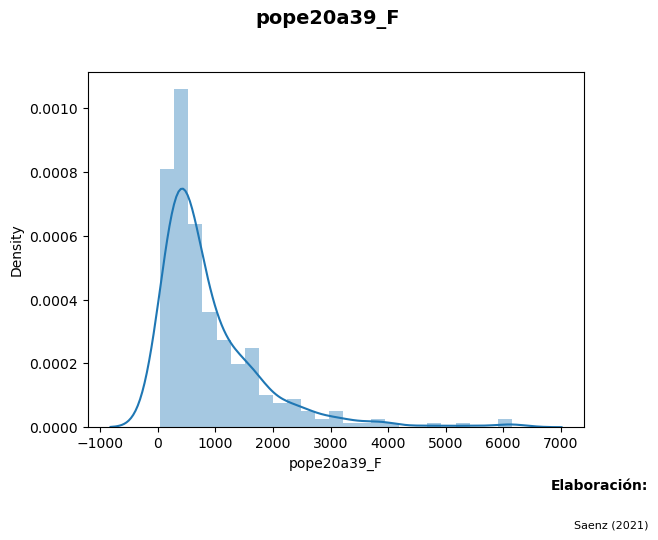

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


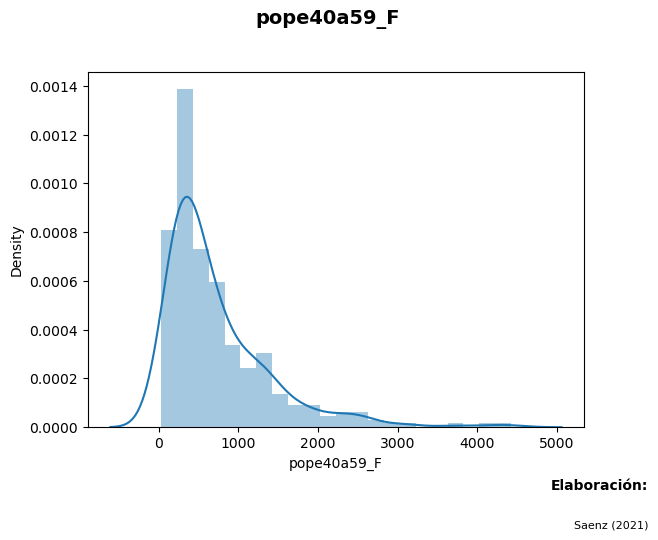

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


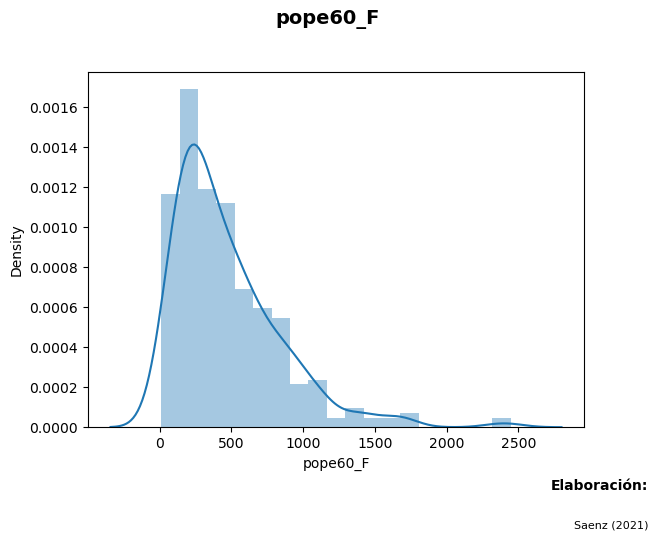

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


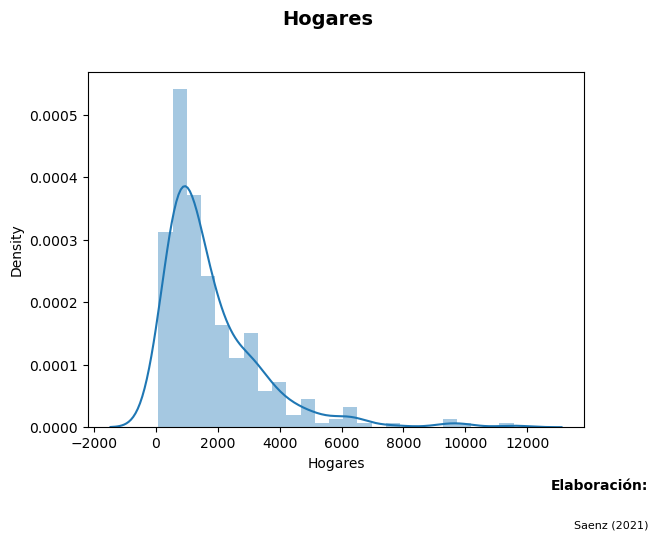

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


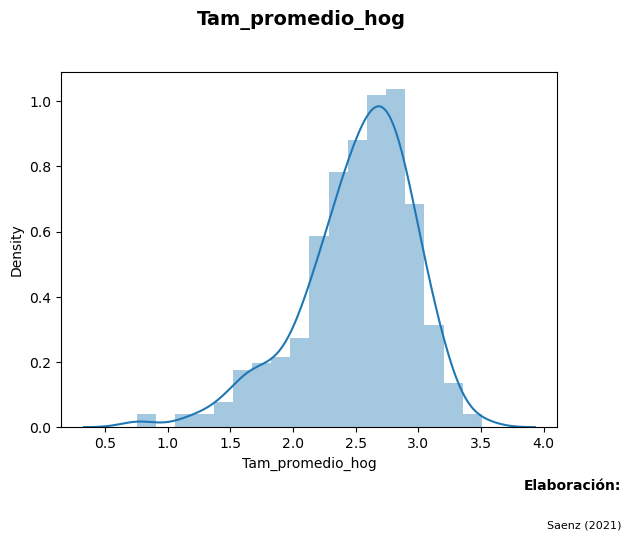

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


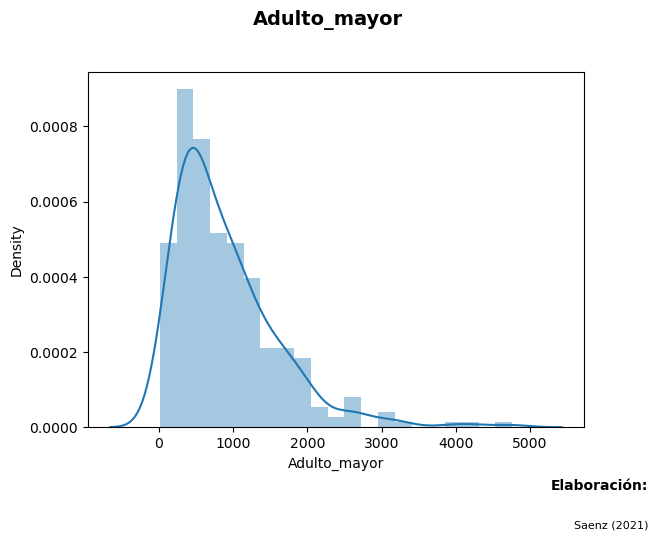

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


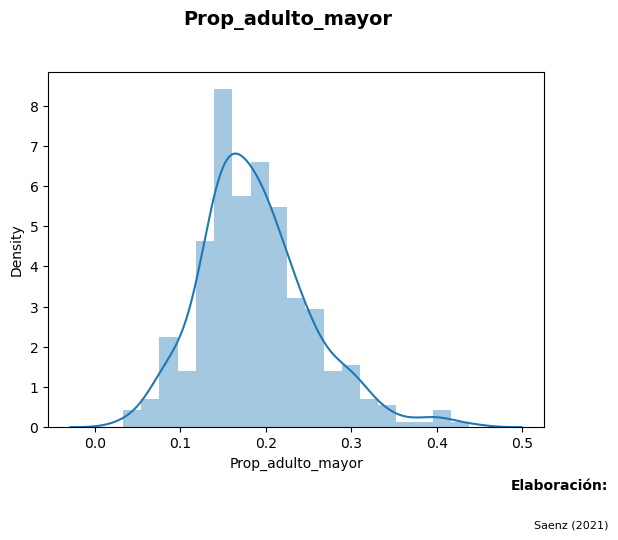

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


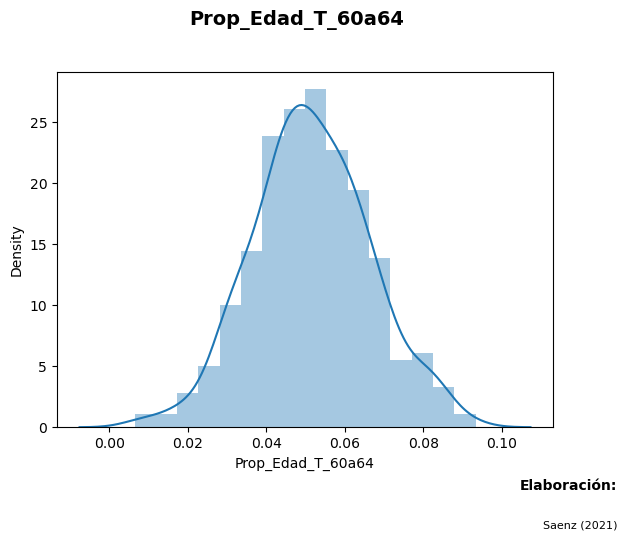

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


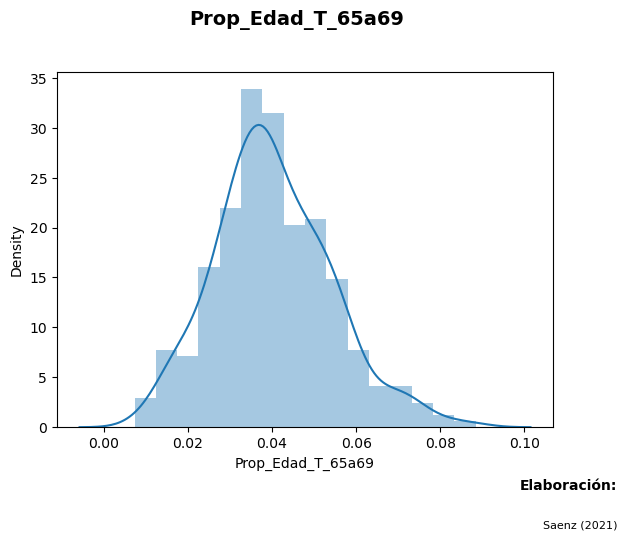

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


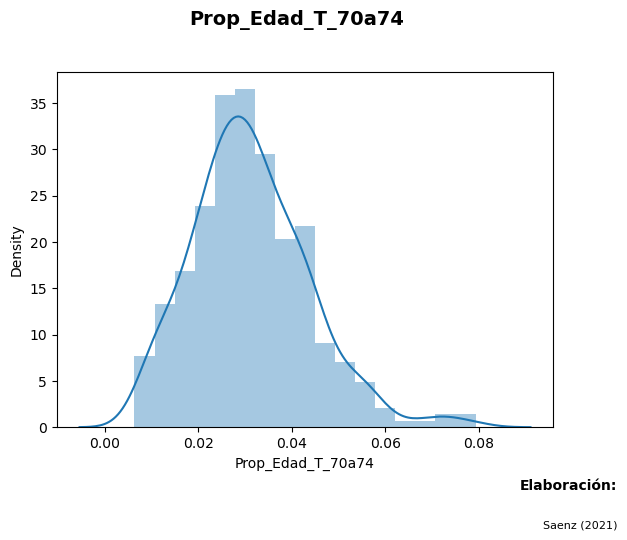

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


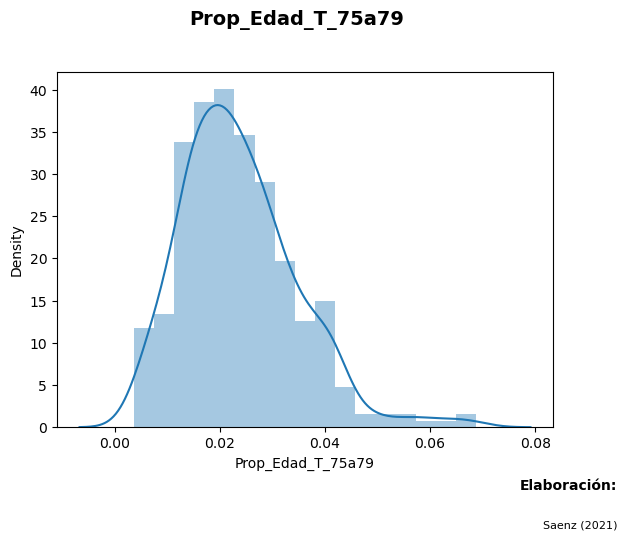

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


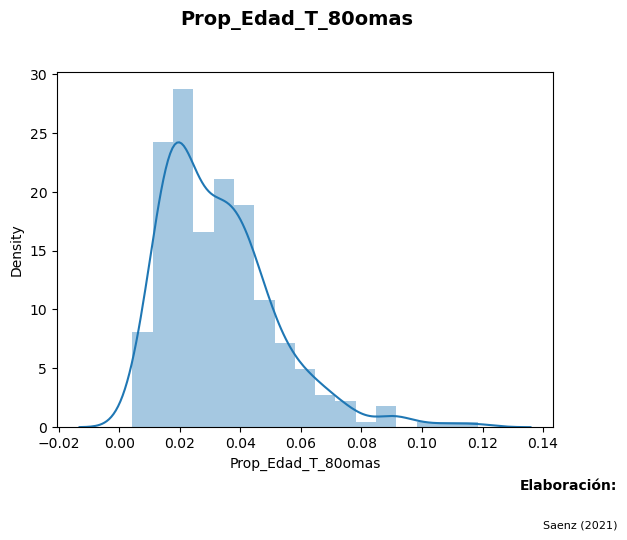

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


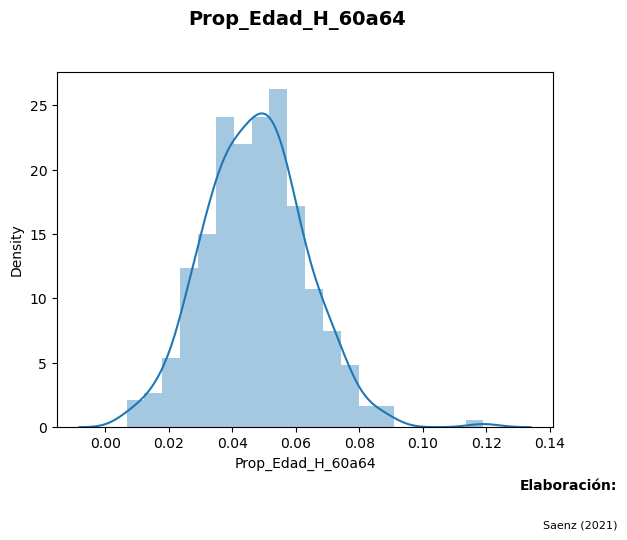

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


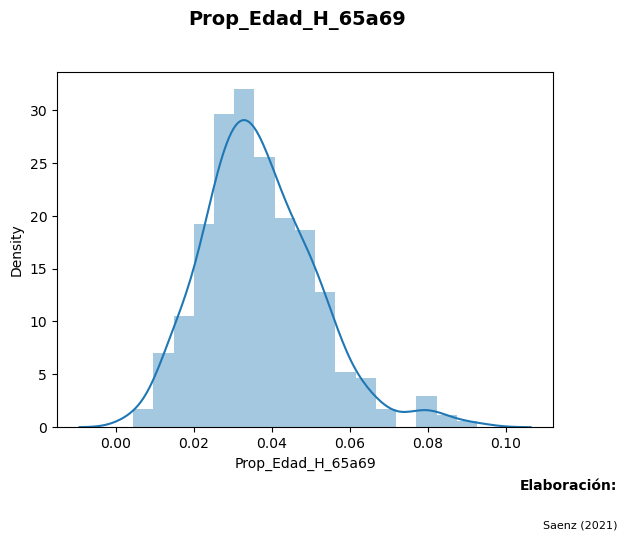

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


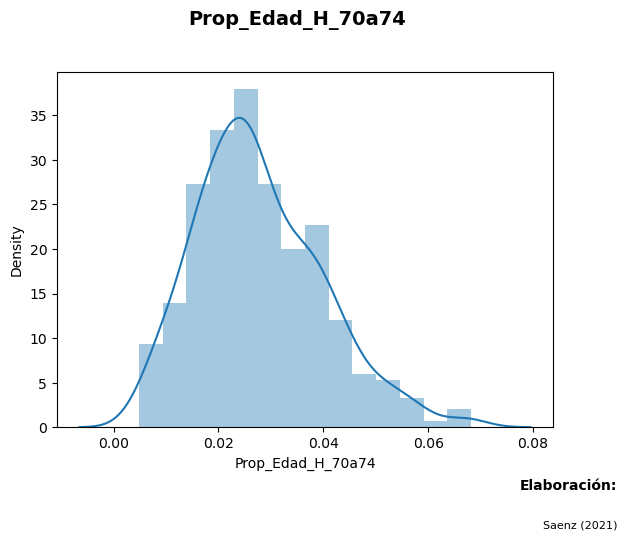

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


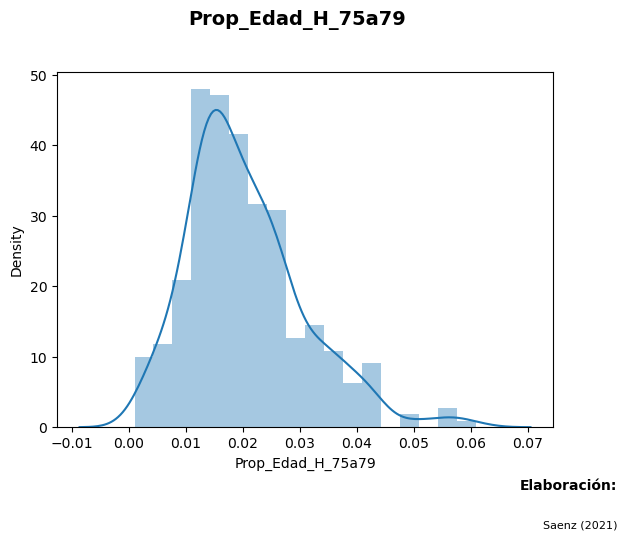

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


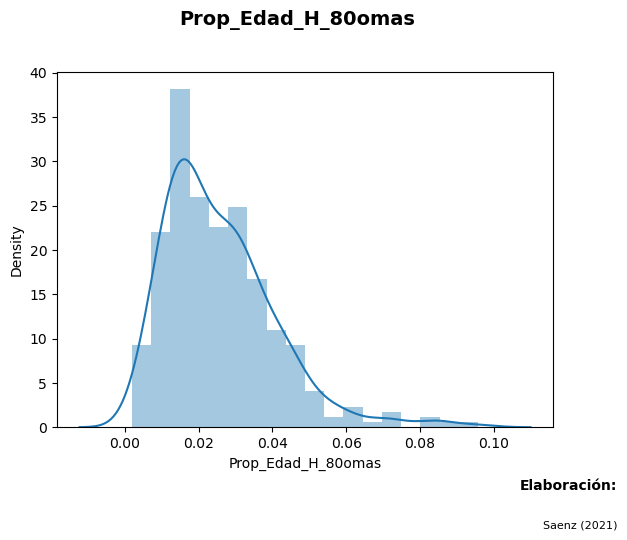

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


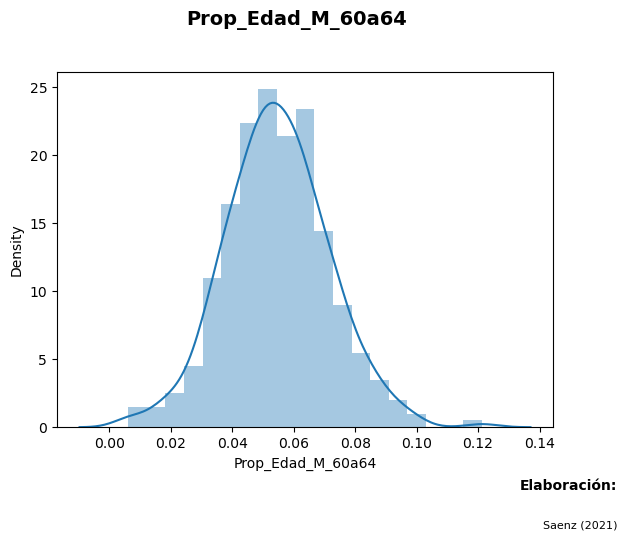

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


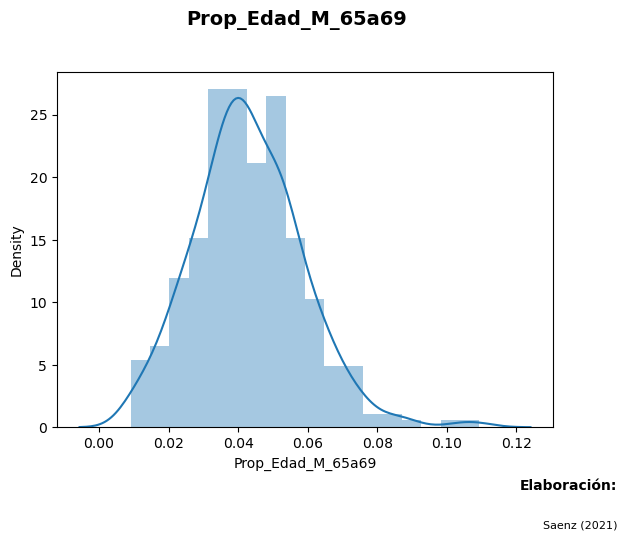

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


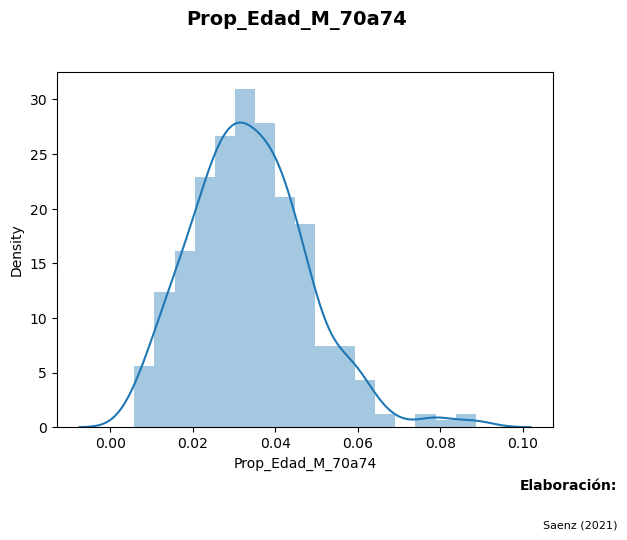

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


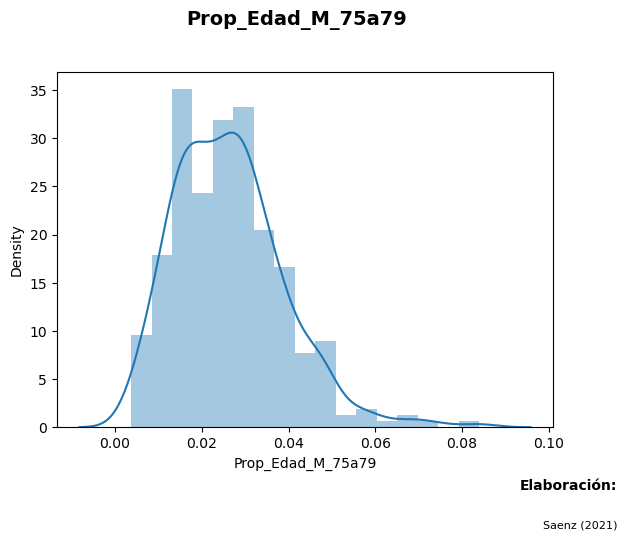

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


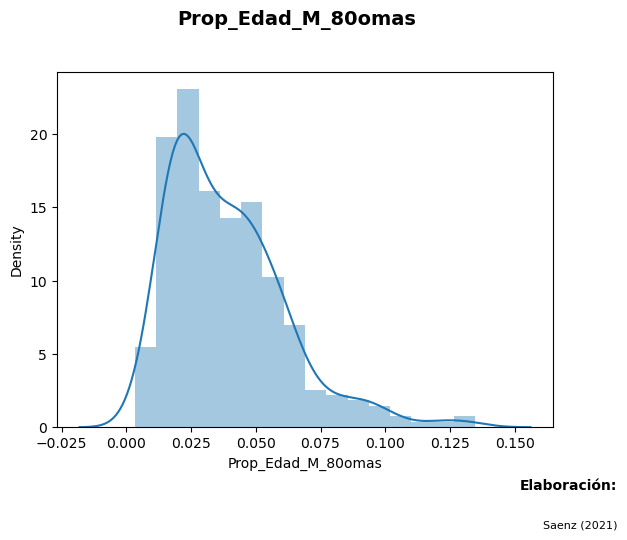

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


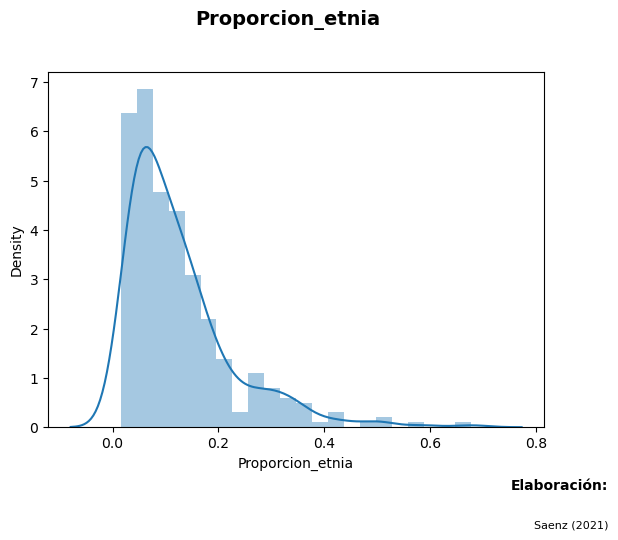

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


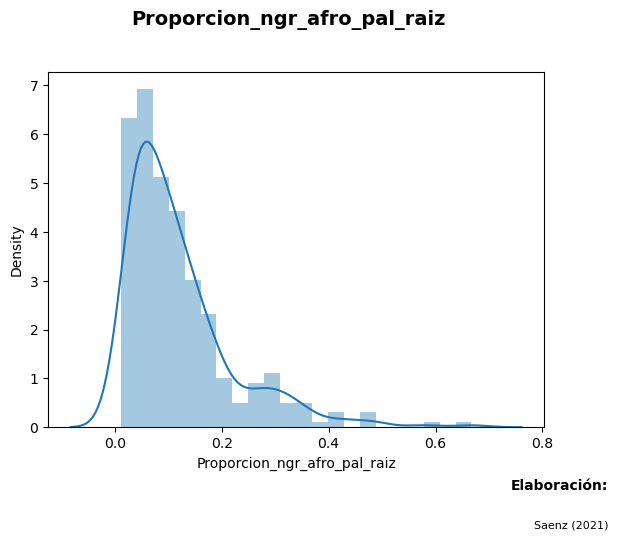

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


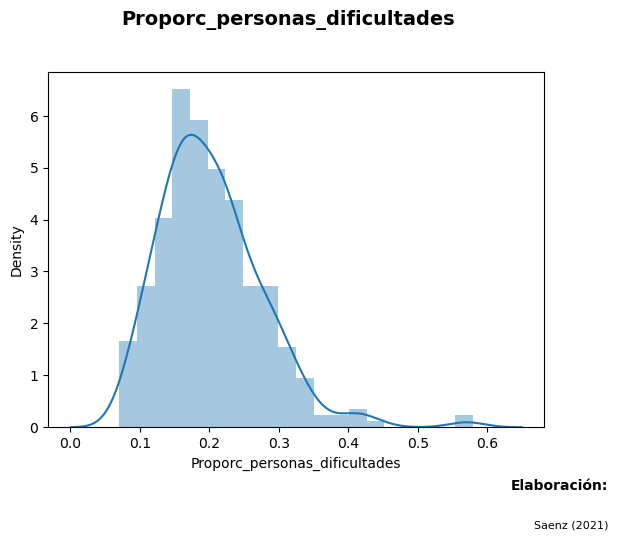

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


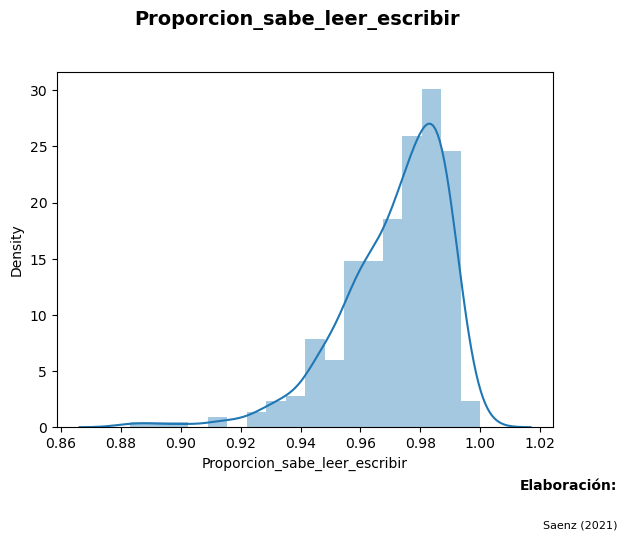

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


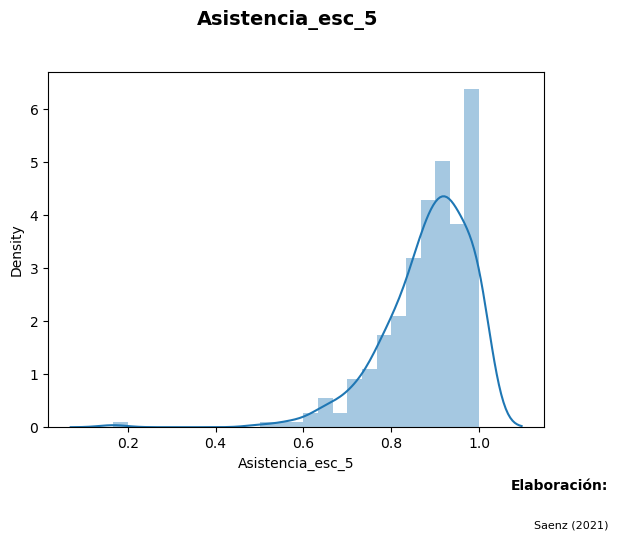

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


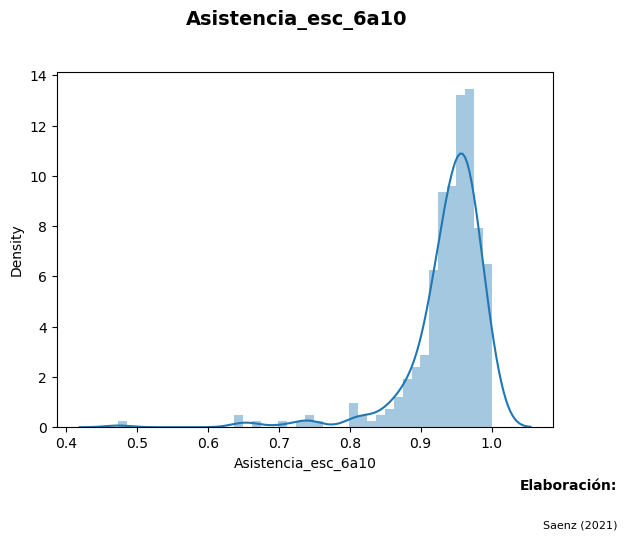

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


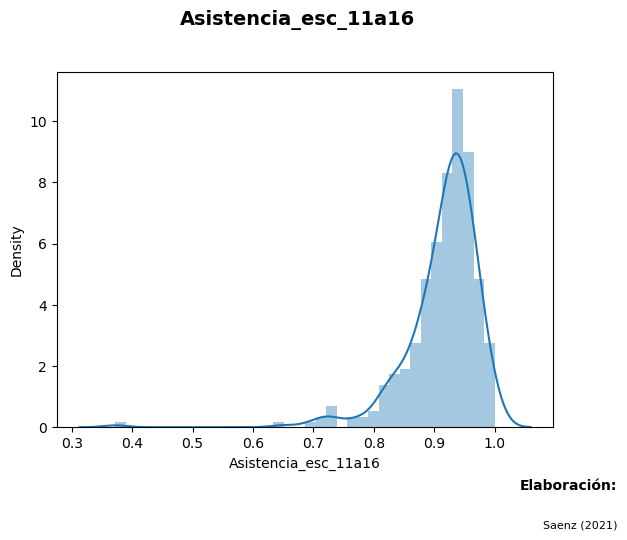

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


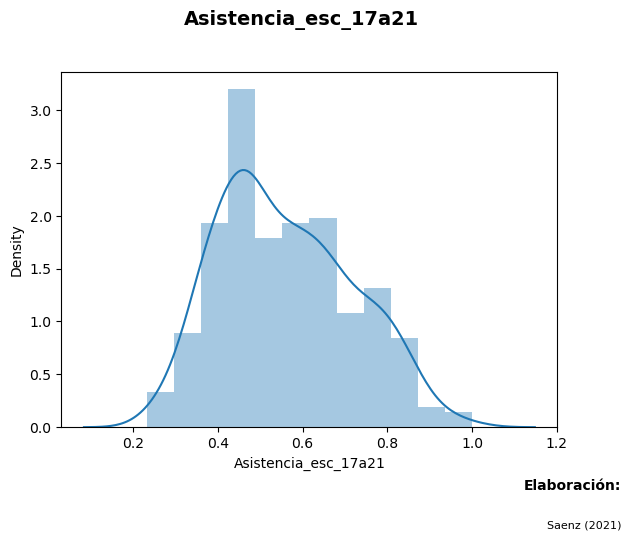

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


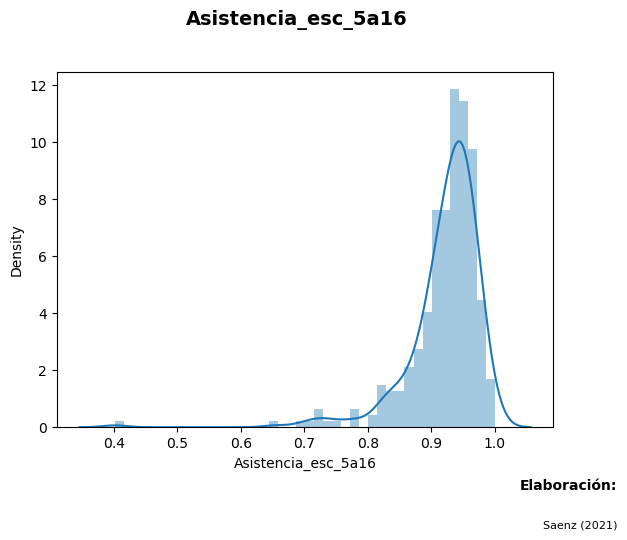

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


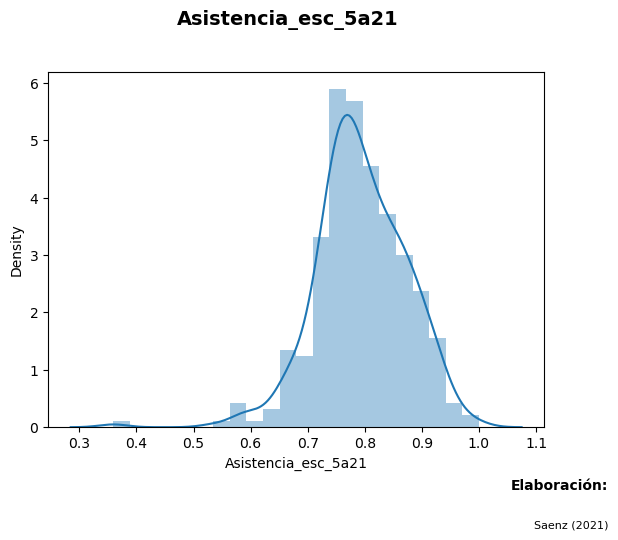

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


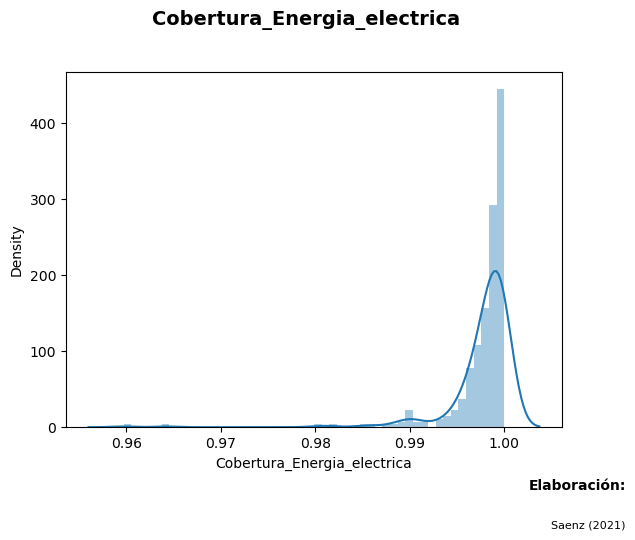

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


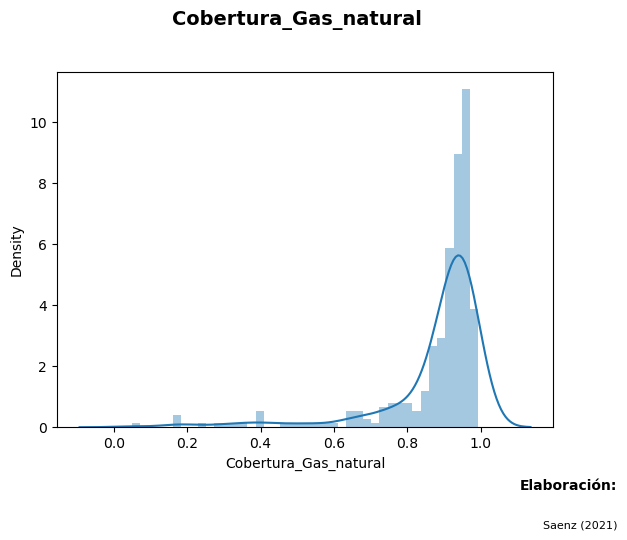

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


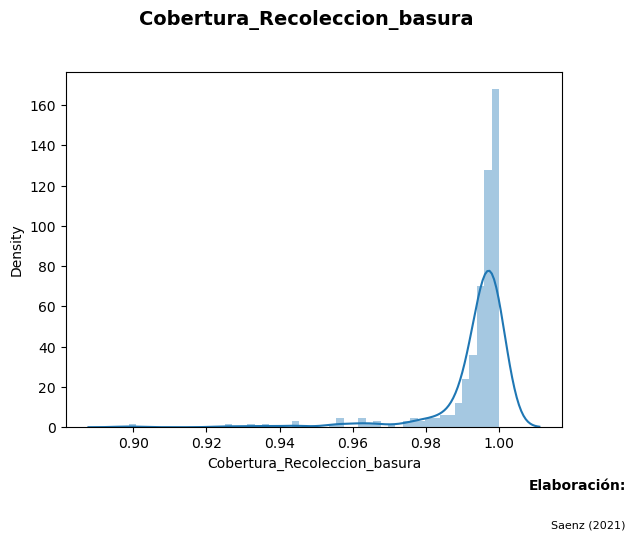

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


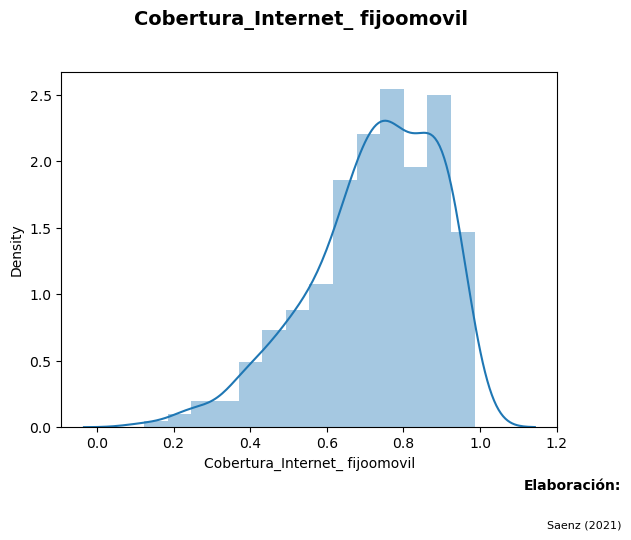

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


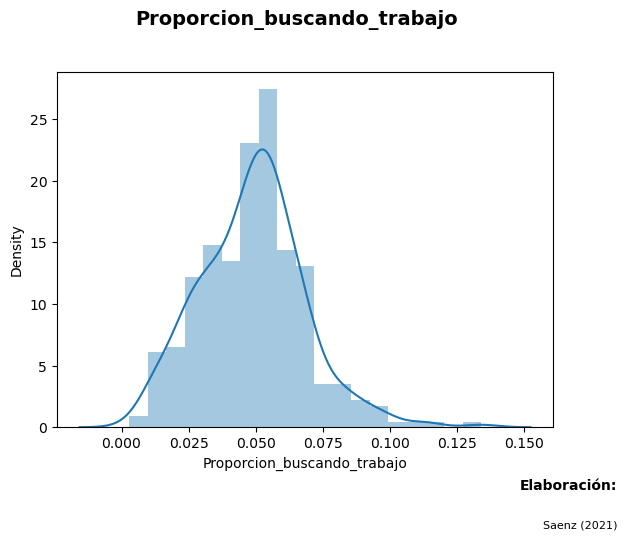

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


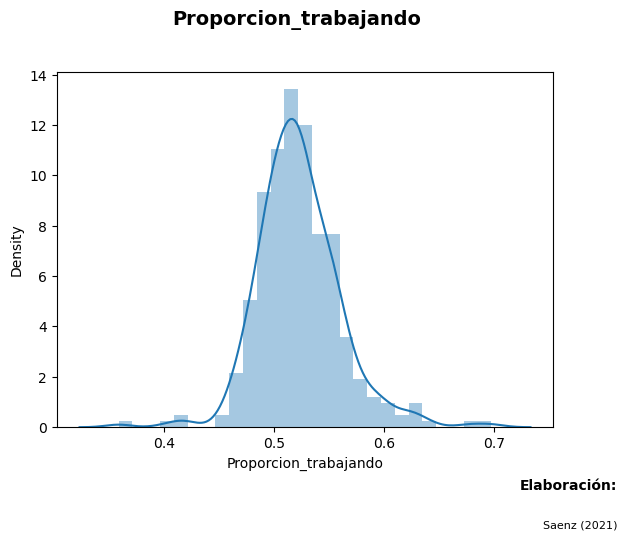

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


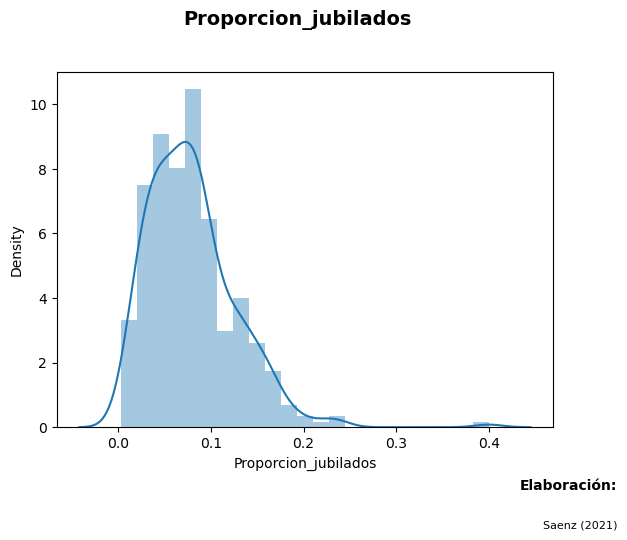

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


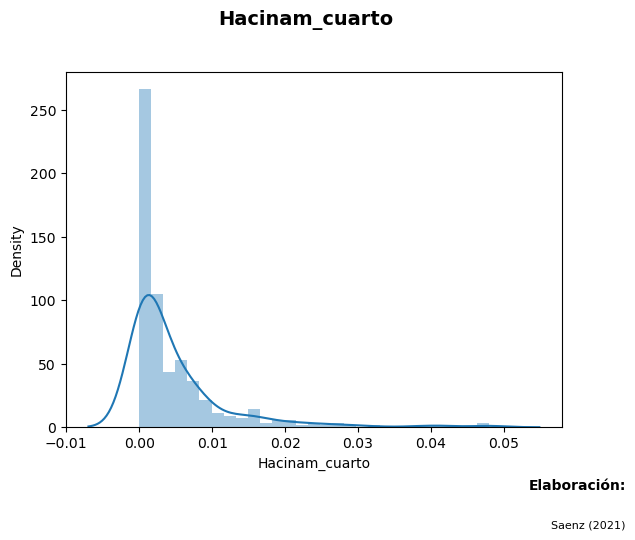

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


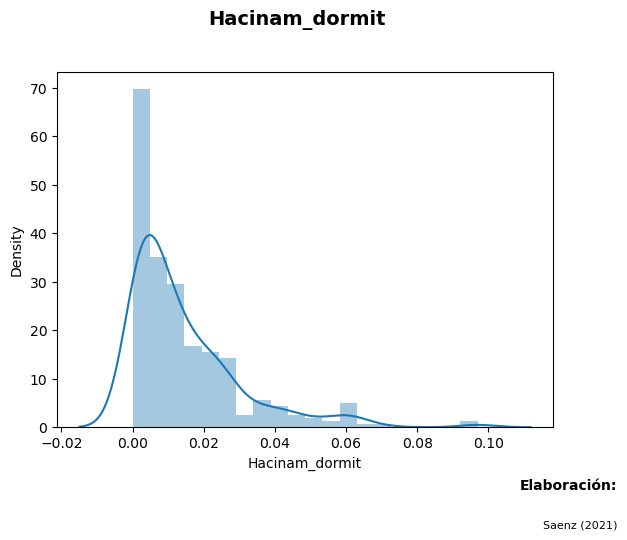

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


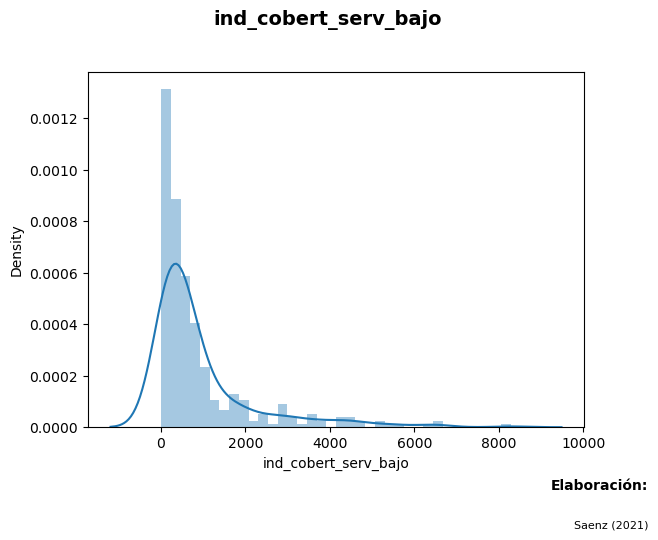

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


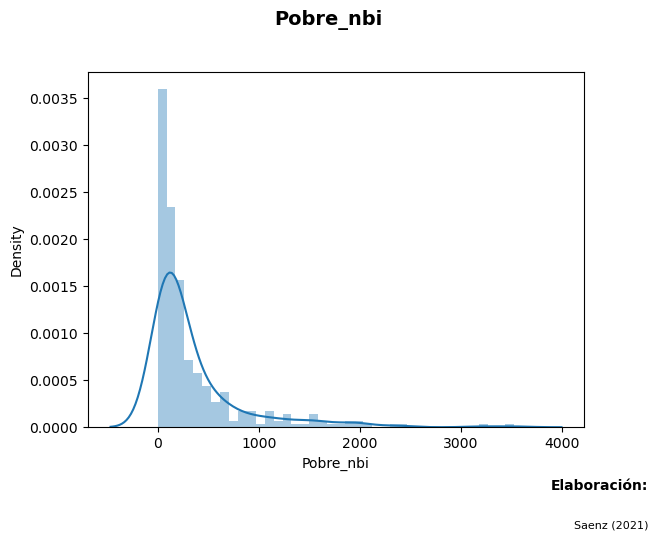

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


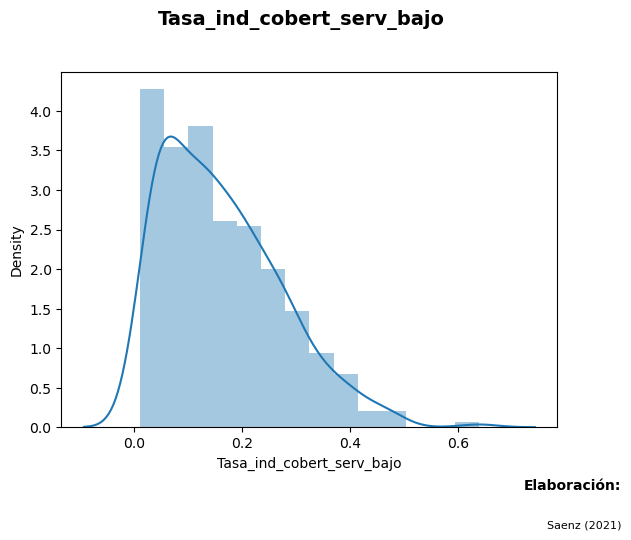

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


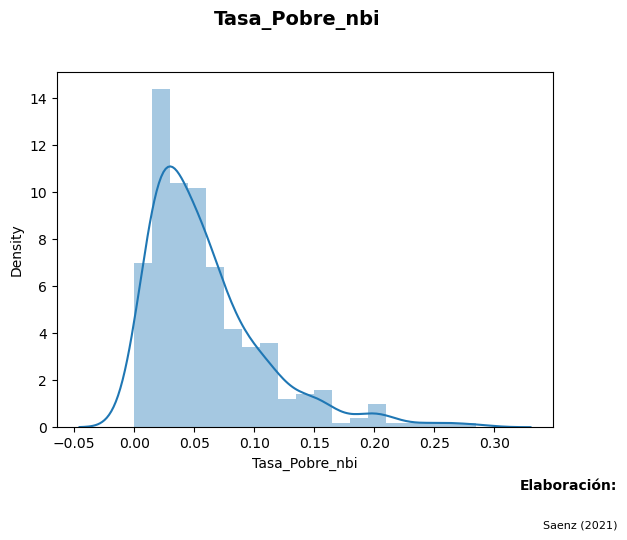

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


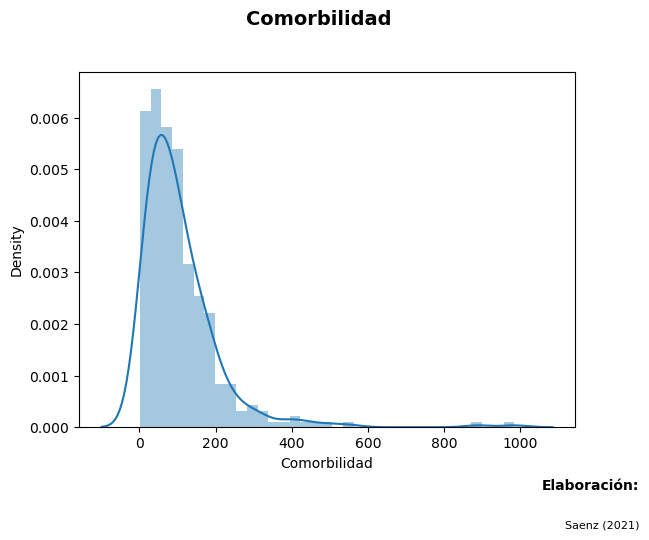

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


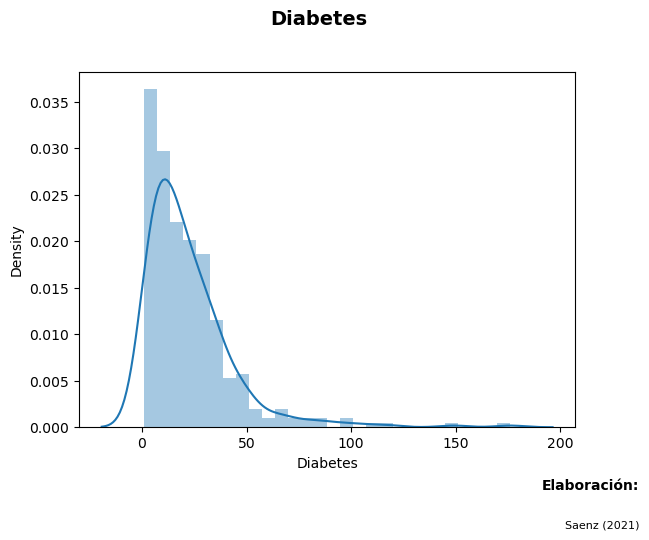

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


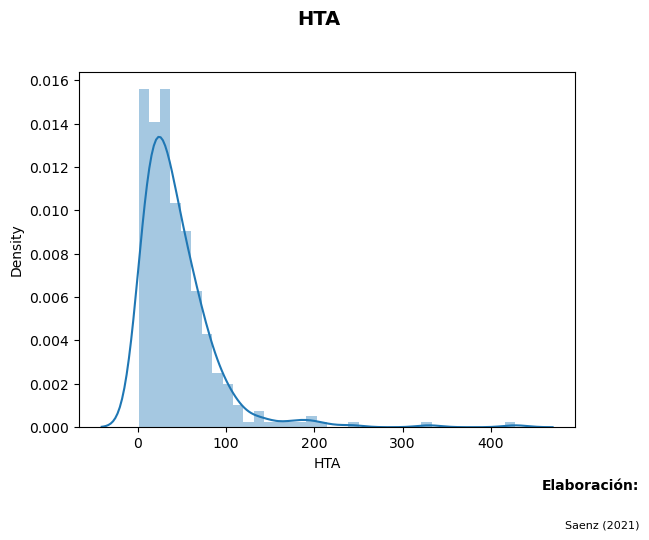

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


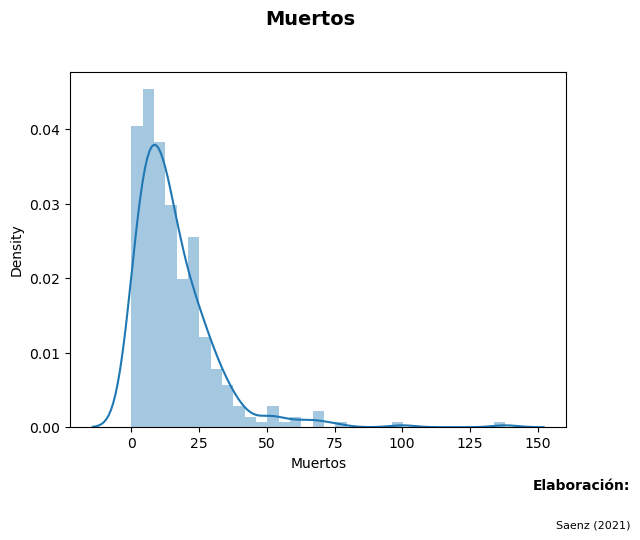

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


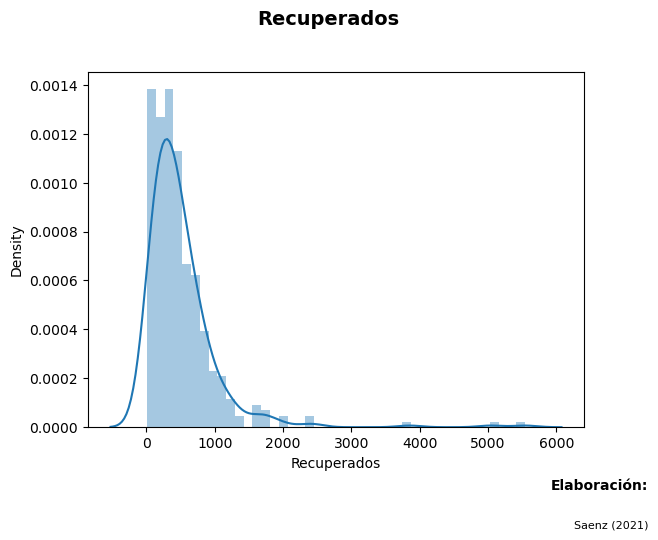

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


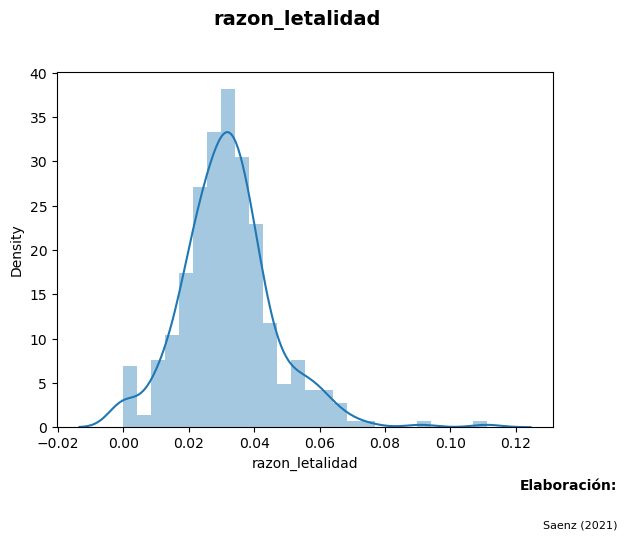

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


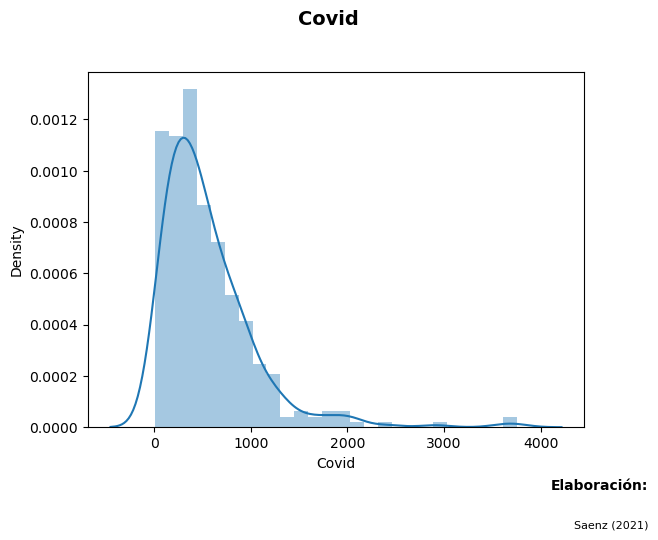

In [27]:
######## Distribuciones de las variables
for i in Datos_econ_cali.columns[5:73]:
    fig = plt.figure()
    ax = sns.distplot(Datos_econ_cali[i].dropna()) #.dropna()
    fig.axes.append(ax)
    fig.suptitle(i, fontsize = 14, fontweight = "bold")
    plt.subplots_adjust(top = 0.85)
    fig.text(1,-.02, "Elaboración:", fontsize = 10, fontweight = "bold", ha = "right")
    fig.text(1,-.1, "Saenz (2021)", fontsize = 8, ha = "right")
    plt.show()

In [28]:
Datos_econ_cali2 = Datos_econ_cali[['Estrato_moda','Poblacion_total','Hogares','Tam_promedio_hog',
                                   'Adulto_mayor','Prop_adulto_mayor','Proporcion_etnia',
                                    'Proporcion_ngr_afro_pal_raiz','Proporc_personas_dificultades',
                                   'Proporcion_sabe_leer_escribir','Asistencia_esc_6a10',
                                   'Asistencia_esc_11a16','Asistencia_esc_17a21','Asistencia_esc_5a16',
                                   'Asistencia_esc_5a21','Cobertura_Energia_electrica', 'Cobertura_Gas_natural',
                                    'Cobertura_Recoleccion_basura', 'Cobertura_Internet_ fijoomovil',
                                    'Proporcion_buscando_trabajo', 'Proporcion_trabajando',
                                    'Proporcion_jubilados', 'Hacinam_cuarto', 'Hacinam_dormit',
                                    'ind_cobert_serv_bajo', 'Pobre_nbi', 'Tasa_ind_cobert_serv_bajo',
                                    'Tasa_Pobre_nbi', 'Covid']]
Datos_econ_cali2 = Datos_econ_cali2.set_index([Datos_econ_cali['NOMBRE']])
Datos_econ_cali2 = Datos_econ_cali2.dropna()
Datos_econ_cali2

,Estrato_moda,Poblacion_total,Hogares,Tam_promedio_hog,Adulto_mayor,Prop_adulto_mayor,Proporcion_etnia,Proporcion_ngr_afro_pal_raiz,Proporc_personas_dificultades,Proporcion_sabe_leer_escribir,...,Proporcion_buscando_trabajo,Proporcion_trabajando,Proporcion_jubilados,Hacinam_cuarto,Hacinam_dormit,ind_cobert_serv_bajo,Pobre_nbi,Tasa_ind_cobert_serv_bajo,Tasa_Pobre_nbi,Covid
NOMBRE,,,,,,,,,,,,,,,,,,,,,
Terron Colorado,2.0,26861.0,9306.0,2.778397,3950.0,0.147053,0.035689,0.025353,0.259367,0.961728,...,0.054866,0.529735,0.050823,0.009143,0.023765,6450.0,1940.0,0.240125,0.072224,1679
Vista Hermosa,1.0,10103.0,3349.0,2.504631,1321.0,0.130753,0.031976,0.026527,0.244032,0.954170,...,0.047786,0.541374,0.036172,0.008575,0.028119,2906.0,992.0,0.287637,0.098189,614
Sect. Patio Bonito,1.0,4078.0,1375.0,2.609828,526.0,0.128985,0.063113,0.044875,0.284698,0.946782,...,0.058394,0.508516,0.025547,0.023114,0.060156,1635.0,643.0,0.400932,0.157675,123
Aguacatal,1.0,14572.0,5133.0,2.714030,1931.0,0.132514,0.042671,0.037469,0.169366,0.958894,...,0.045005,0.571116,0.043059,0.015196,0.045630,3411.0,1316.0,0.234079,0.090310,733
Santa Rita,6.0,1268.0,514.0,2.220381,362.0,0.285489,0.039085,0.036278,0.417674,0.985366,...,0.012048,0.601406,0.127510,0.000000,0.006187,71.0,23.0,0.055994,0.018139,184
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Urb. Ciudad Jardin,1.0,4745.0,1676.0,2.268615,1151.0,0.242571,0.048148,0.042360,0.130398,0.985370,...,0.010882,0.546250,0.116395,0.001757,0.001877,120.0,35.0,0.025290,0.007376,844
Parcelaciones Pance,6.0,11720.0,3919.0,2.720580,1975.0,0.168515,0.041911,0.038055,0.088775,0.982354,...,0.009880,0.556893,0.085851,0.000000,0.001018,395.0,106.0,0.033703,0.009044,1282
Urb. Rio Lili,6.0,3126.0,1246.0,2.181534,478.0,0.152911,0.092730,0.082853,0.169866,0.982624,...,0.022826,0.599275,0.085870,0.000000,0.003999,181.0,39.0,0.057901,0.012476,561


In [29]:
from scipy import stats
Covid_normal, fitted_lambda = stats.boxcox(Datos_econ_cali2['Covid']) 

In [30]:
Covid_normal

array([15.83952667, 12.25110781,  7.72872874, 12.83595713,  8.7395565 ,
       11.70131782,  9.47121202, 10.33623622, 11.39078558, 10.60740924,
       13.15730043, 10.1832999 , 14.12330161, 12.44723073, 14.05857071,
       13.56863569,  8.41184769,  6.23993253, 11.31744598,  7.97394056,
       12.79917218,  7.99199821, 14.22360869, 12.2192405 , 12.81760586,
       12.66298549,  8.7395565 ,  5.9940935 , 10.97210123,  8.91842315,
       11.96599874, 13.15306213, 12.56144518, 13.29891067, 12.2458143 ,
       12.30887664, 12.05037951,  9.53841805, 10.05215586, 14.0756979 ,
       15.57153944, 11.14524639,  9.69021528,  7.86325867,  8.66800596,
       10.56636715, 10.41460607, 10.70404875,  8.86444062, 12.4823353 ,
        5.55259548,  7.64902279,  6.58514169,  7.74832401,  9.24901222,
       11.57130965,  5.88111889,  7.56709839,  9.75324998,  6.75630511,
        9.39106324,  7.28370052,  9.02375703, 11.20121607, 10.0711947 ,
       13.24117784, 13.45963955, 14.72049606, 12.26167374, 10.59

In [31]:
fitted_lambda

0.1834979059151258

In [32]:
from scipy.special import boxcox, inv_boxcox
inv_boxcox(Covid_normal, 0.1834979059151258)

array([1679.,  614.,  123.,  733.,  184.,  517.,  242.,  329.,  468.,
        361.,  806.,  312., 1062.,  652., 1043.,  908.,  162.,   64.,
        457.,  136.,  725.,  137., 1092.,  608.,  729.,  696.,  184.,
         57.,  408.,  197.,  562.,  805.,  675.,  840.,  613.,  625.,
        577.,  248.,  298., 1048., 1567.,  432.,  262.,  130.,  179.,
        356.,  338.,  373.,  193.,  659.,   46.,  119.,   75.,  124.,
        223.,  496.,   54.,  115.,  268.,   81.,  235.,  102.,  205.,
        440.,  300.,  826.,  880., 1251.,  616.,  359.,  693., 1269.,
        527.,  526.,  675., 2011., 2016.,  832., 1485.,  411.,  637.,
        498.,  432.,  537.,  905.,  432., 2910.,  107.,  888.,  488.,
        549.,  930.,  434.,  812.,   30.,  334.,  389., 1318.,  182.,
        180.,  634.,   42.,  449.,  595.,  193.,  603.,  157.,  474.,
        922.,  293.,  378.,  576., 1138.,  329.,  671.,  657.,  502.,
        827.,  428.,  721.,  746.,  529.,  897., 3617.,  889.,  260.,
        275.,  148.,

In [33]:
Datos_econ_cali2['Covid_normal'] = Covid_normal
Datos_econ_cali2.head()

,Estrato_moda,Poblacion_total,Hogares,Tam_promedio_hog,Adulto_mayor,Prop_adulto_mayor,Proporcion_etnia,Proporcion_ngr_afro_pal_raiz,Proporc_personas_dificultades,Proporcion_sabe_leer_escribir,...,Proporcion_trabajando,Proporcion_jubilados,Hacinam_cuarto,Hacinam_dormit,ind_cobert_serv_bajo,Pobre_nbi,Tasa_ind_cobert_serv_bajo,Tasa_Pobre_nbi,Covid,Covid_normal
NOMBRE,,,,,,,,,,,,,,,,,,,,,
Terron Colorado,2.0,26861.0,9306.0,2.778397,3950.0,0.147053,0.035689,0.025353,0.259367,0.961728,...,0.529735,0.050823,0.009143,0.023765,6450.0,1940.0,0.240125,0.072224,1679,15.839527
Vista Hermosa,1.0,10103.0,3349.0,2.504631,1321.0,0.130753,0.031976,0.026527,0.244032,0.954170,...,0.541374,0.036172,0.008575,0.028119,2906.0,992.0,0.287637,0.098189,614,12.251108
Sect. Patio Bonito,1.0,4078.0,1375.0,2.609828,526.0,0.128985,0.063113,0.044875,0.284698,0.946782,...,0.508516,0.025547,0.023114,0.060156,1635.0,643.0,0.400932,0.157675,123,7.728729
Aguacatal,1.0,14572.0,5133.0,2.714030,1931.0,0.132514,0.042671,0.037469,0.169366,0.958894,...,0.571116,0.043059,0.015196,0.045630,3411.0,1316.0,0.234079,0.090310,733,12.835957
Santa Rita,6.0,1268.0,514.0,2.220381,362.0,0.285489,0.039085,0.036278,0.417674,0.985366,...,0.601406,0.127510,0.000000,0.006187,71.0,23.0,0.055994,0.018139,184,8.739556


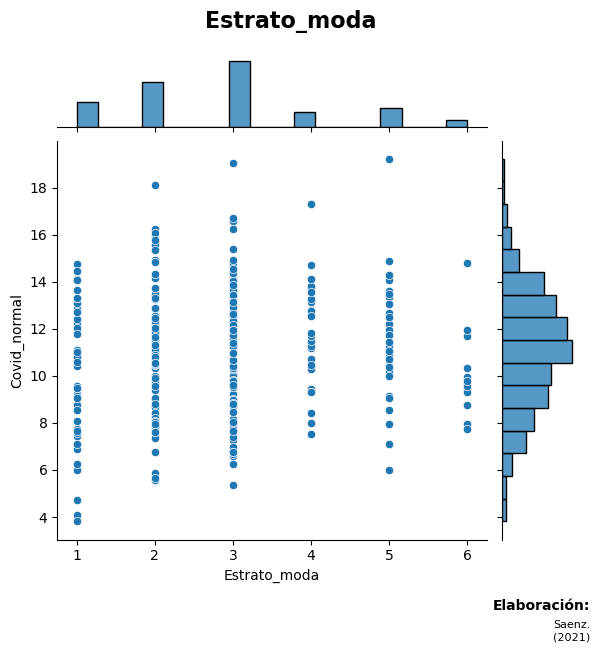

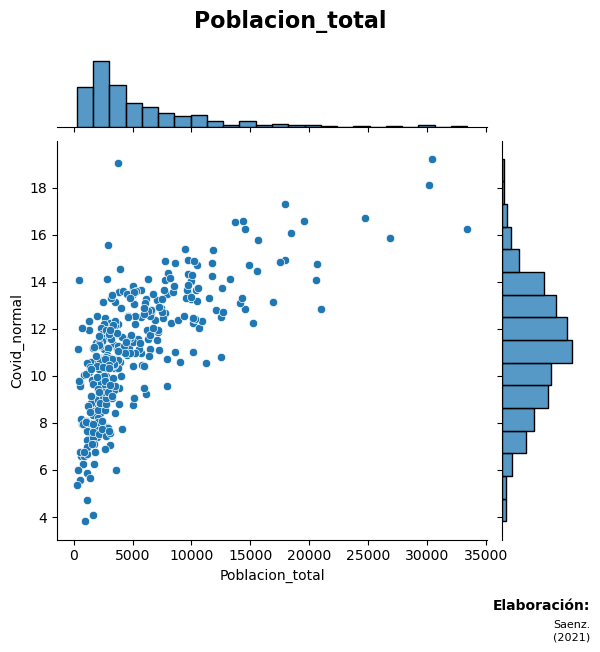

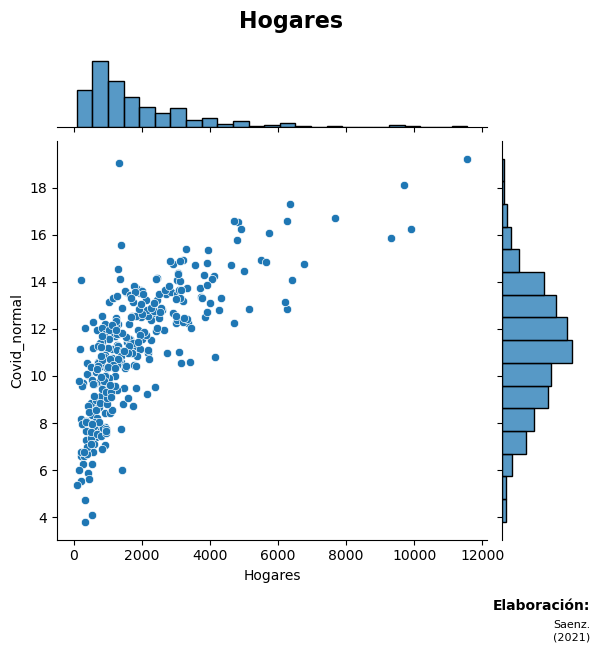

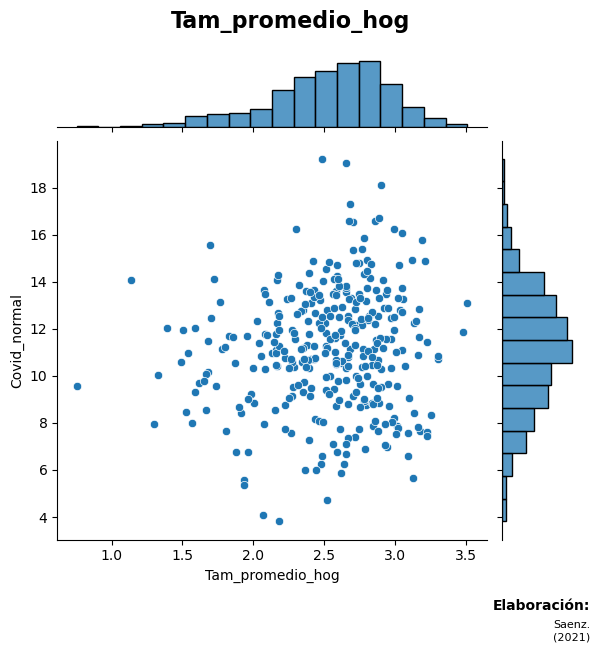

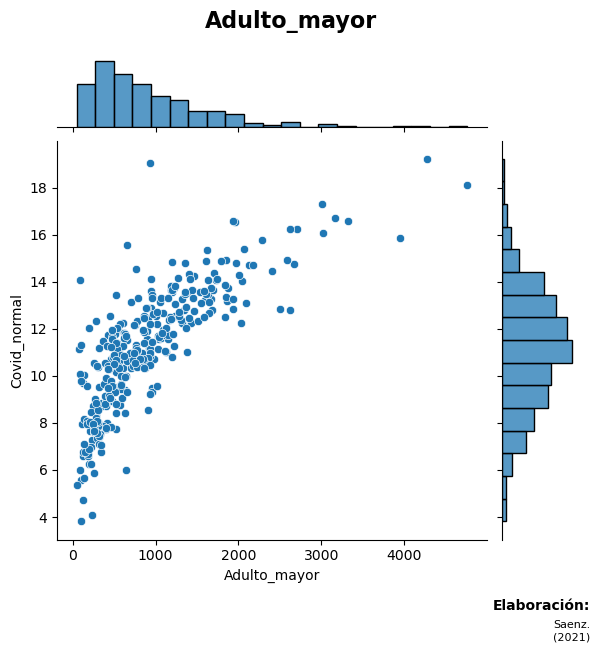

...

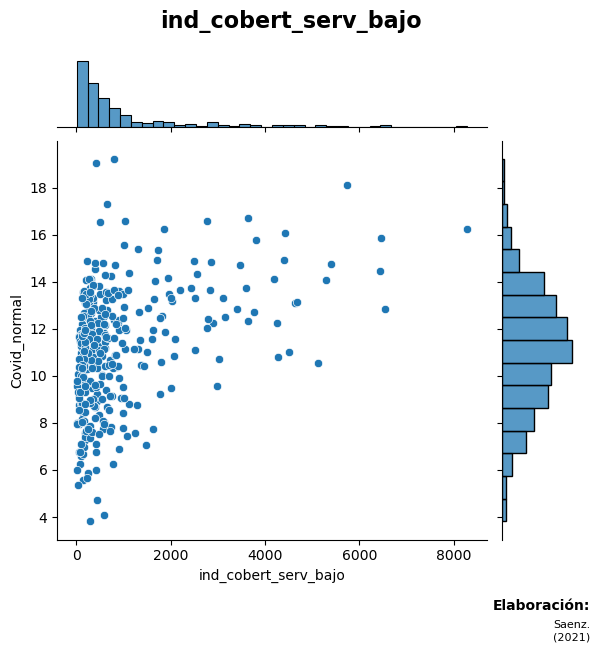

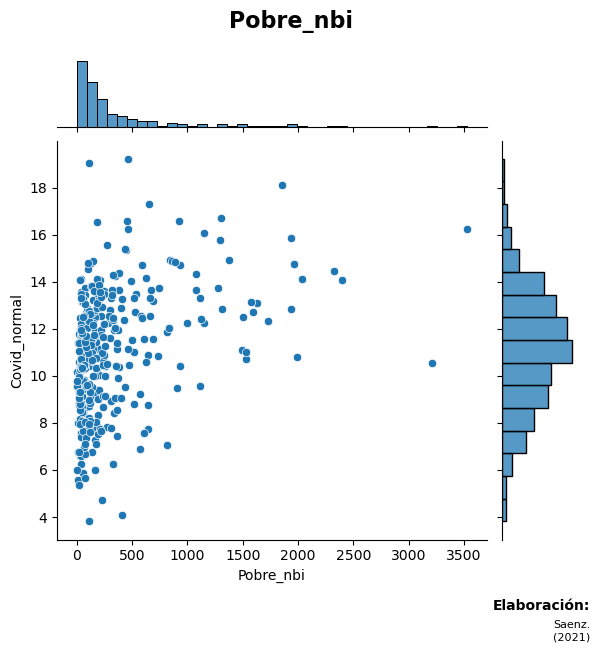

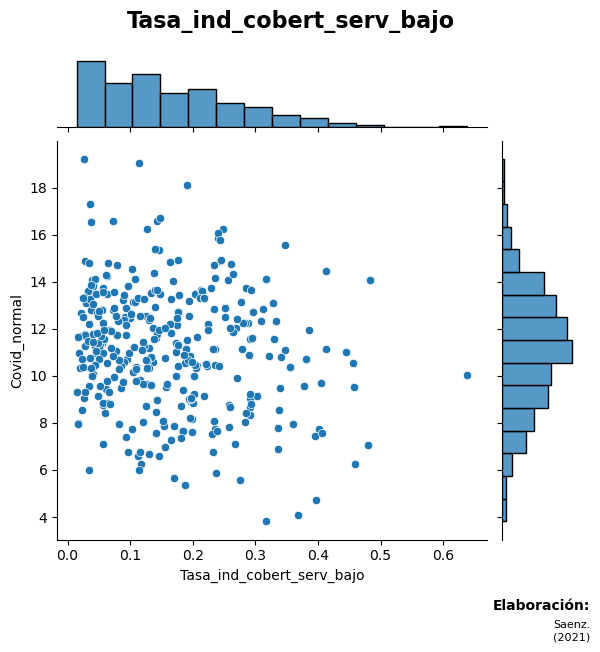

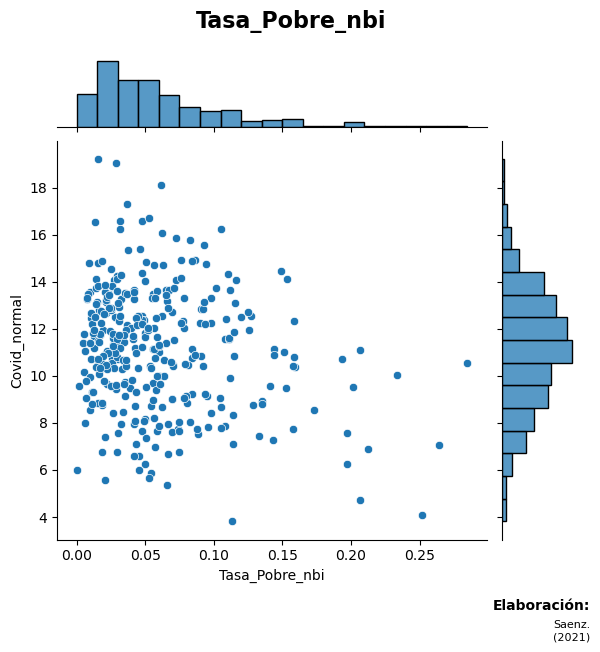

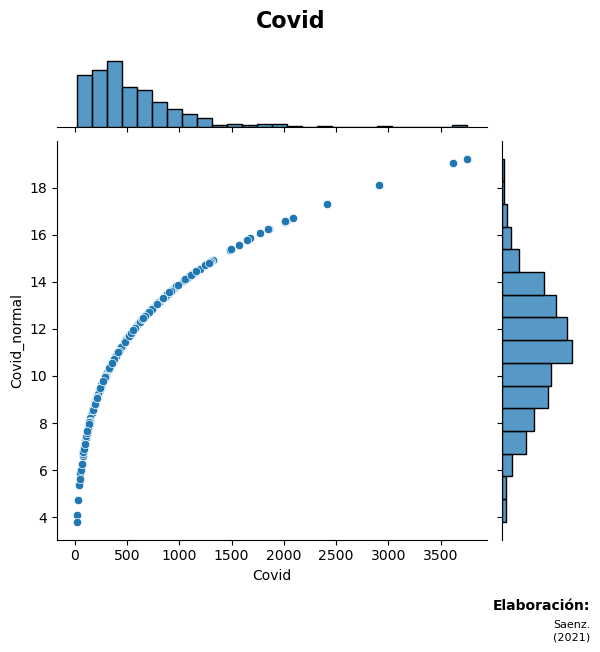

In [34]:
for i in Datos_econ_cali2.columns[0:29]:
    var = i
    data = pd.concat([Datos_econ_cali2['Covid_normal'], Datos_econ_cali2[var]], axis=1)
    g = sns.jointplot(x = var, y = "Covid_normal", data = data)
    g.fig.suptitle(i, fontsize = 16, fontweight = "bold")
    plt.subplots_adjust(top=0.9)
    g.fig.text(1,-.02, "Elaboración:", fontsize = 10, fontweight = "bold", ha = "right")
    g.fig.text(1,-.07, "Saenz.\n(2021)", fontsize = 8, ha = "right")
    plt.show()

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


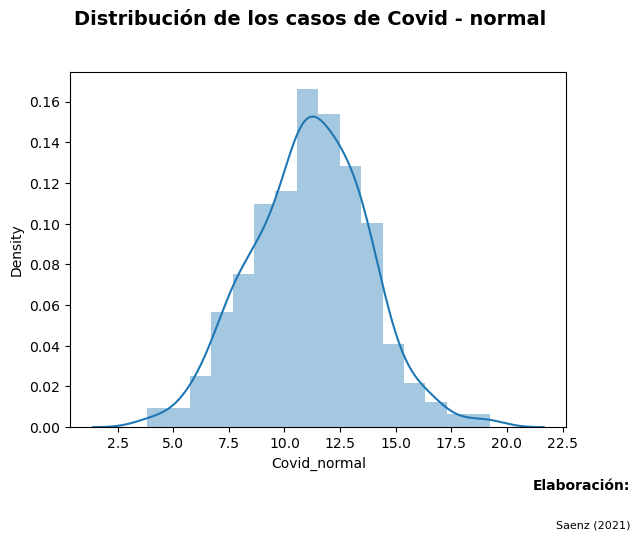

In [35]:
fig = plt.figure()
ax = sns.distplot(Datos_econ_cali2['Covid_normal'])
fig.axes.append(ax)
fig.suptitle("Distribución de los casos de Covid - normal", fontsize = 14, fontweight = "bold")
plt.subplots_adjust(top = 0.85)
fig.text(1,-.02, "Elaboración:", fontsize = 10, fontweight = "bold", ha = "right")
fig.text(1,-.1, "Saenz (2021)", fontsize = 8, ha = "right")
plt.show()

c:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


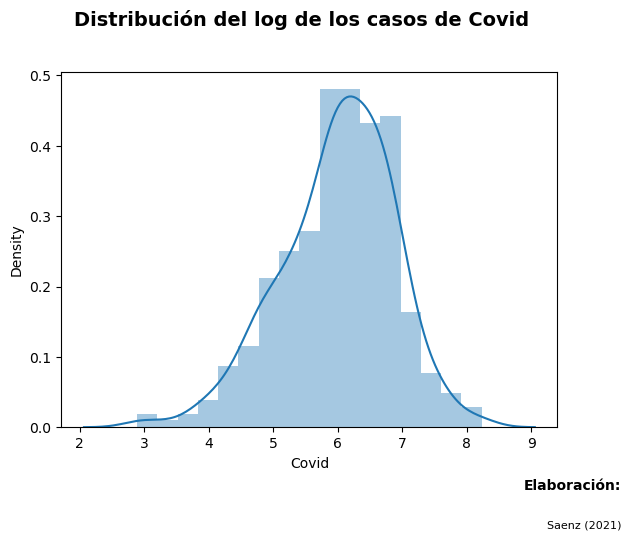

In [36]:
fig = plt.figure()
ax = sns.distplot(np.log(Datos_econ_cali2['Covid']))
fig.axes.append(ax)
fig.suptitle("Distribución del log de los casos de Covid", fontsize = 14, fontweight = "bold")
plt.subplots_adjust(top = 0.85)
fig.text(1,-.02, "Elaboración:", fontsize = 10, fontweight = "bold", ha = "right")
fig.text(1,-.1, "Saenz (2021)", fontsize = 8, ha = "right")
plt.show()

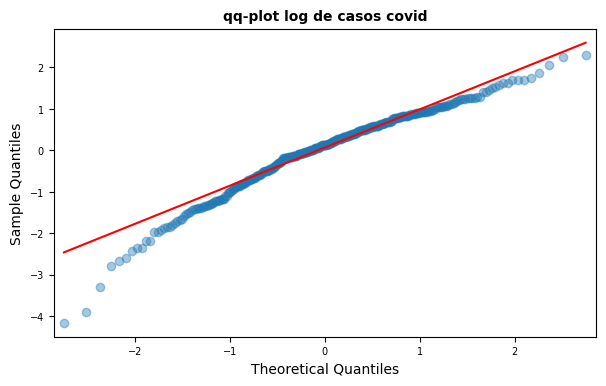

In [37]:
import statsmodels.api as sm
# Gráfico Q-Q
# ==============================================================================
fig, ax = plt.subplots(figsize=(7,4))
sm.qqplot(np.log(Datos_econ_cali2['Covid_normal']), fit   = True, line  = 'q', alpha = 0.4, lw    = 2, ax    = ax)
ax.set_title('qq-plot log de casos covid', fontsize = 10, fontweight = "bold")
ax.tick_params(labelsize = 7)

In [38]:
from scipy import stats
# Shapiro-Wilk test
# ==============================================================================
shapiro_test = stats.shapiro(np.log(Datos_econ_cali2['Covid_normal']))
shapiro_test

ShapiroResult(statistic=0.9623964428901672, pvalue=1.5814853782103455e-07)

In [39]:
# D'Agostino's K-squared test
# ==============================================================================
k2, p_value = stats.normaltest(np.log(Datos_econ_cali2['Covid_normal']))
print(f"Estadístico = {k2}, p-value = {p_value}")

Estadístico = 41.83935772635583, p-value = 8.216727921668033e-10


### Correlaciones

In [40]:
correlation_mat = Datos_econ_cali.iloc[:,5:73].corr()
corr_pairs = correlation_mat.unstack()
sorted_pairs = corr_pairs.sort_values(kind="quicksort")
print(sorted_pairs)

TD = Desocupados/PEA            TE = Ocupados/PEA                -1.000000
TE = Ocupados/PEA               TD = Desocupados/PEA             -1.000000
Tasa_ind_cobert_serv_bajo       Cobertura_Internet_ fijoomovil   -0.955420
Cobertura_Internet_ fijoomovil  Tasa_ind_cobert_serv_bajo        -0.955420
Proporcion_sabe_leer_escribir   Tasa_ind_cobert_serv_bajo        -0.898616
                                                                    ...   
Prop_Edad_M_80omas              Prop_Edad_M_80omas                1.000000
Prop_Edad_M_75a79               Prop_Edad_M_75a79                 1.000000
Prop_Edad_M_70a74               Prop_Edad_M_70a74                 1.000000
Cobertura_Gas_natural           Cobertura_Gas_natural             1.000000
Covid                           Covid                             1.000000
Length: 4624, dtype: float64


In [41]:
sorted_pairs['Covid'][30:65] # Variables que presentan mayor correlación lineal positiva con Covid. 
#No hay asociaciones negativas significativas

Asistencia_esc_5                  0.071497
Asistencia_esc_6a10               0.079564
TD = Desocupados/PEA              0.082852
Prop_Edad_M_65a69                 0.090775
Asistencia_esc_5a16               0.099423
Cobertura_Energia_electrica       0.100844
Prop_Edad_H_60a64                 0.103197
Prop_Edad_T_60a64                 0.103697
Cobertura_Recoleccion_basura      0.103944
Asistencia_esc_11a16              0.104262
Proporcion_sabe_leer_escribir     0.110161
Prop_Edad_M_60a64                 0.121781
Cobertura_Gas_natural             0.134325
Tam_promedio_hog                  0.138199
Cobertura_Internet_ fijoomovil    0.140378
Pobre_nbi                         0.363036
ind_cobert_serv_bajo              0.410783
pope0a19_M                        0.641017
e0_19                             0.646679
popae0a19_F                       0.651288
pope20a39_M                       0.730322
e20_39                            0.736384
pope20a39_F                       0.741112
Poblacion_t

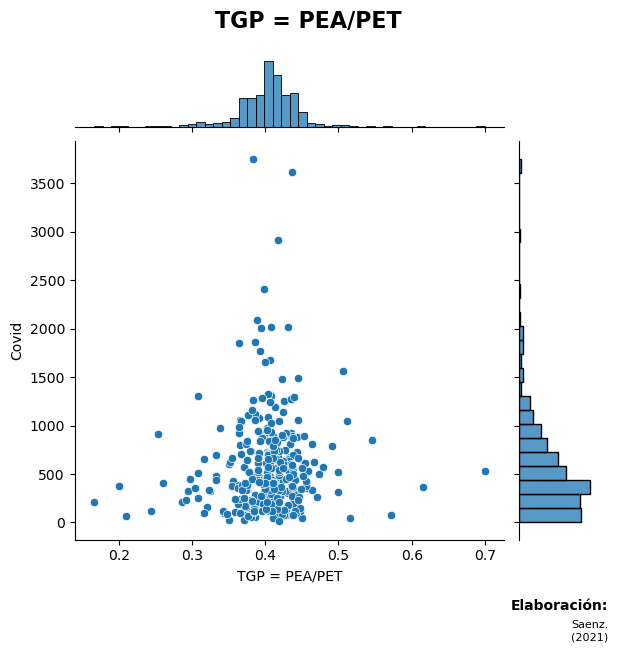

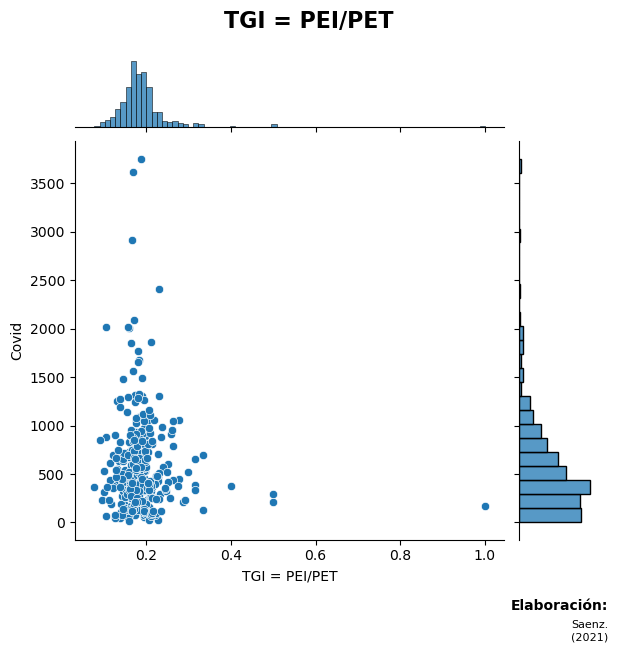

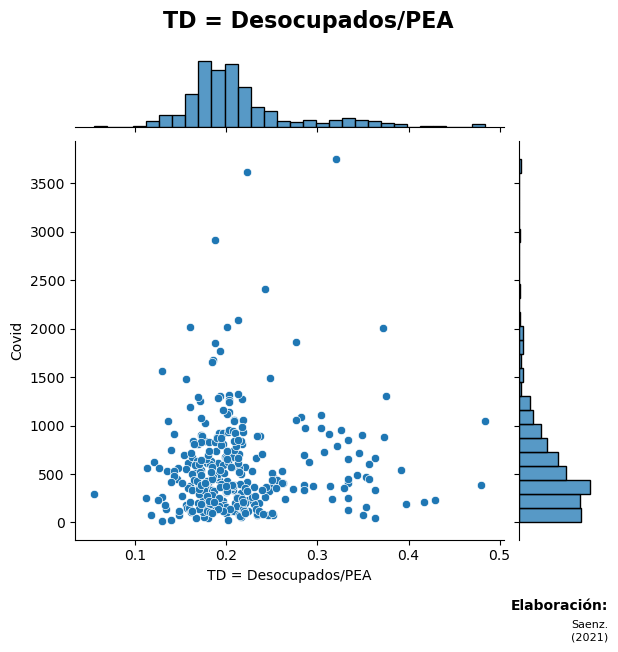

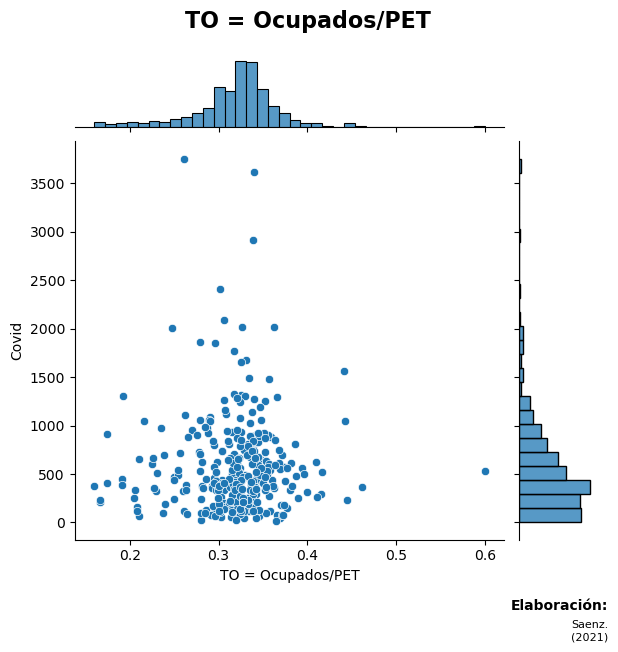

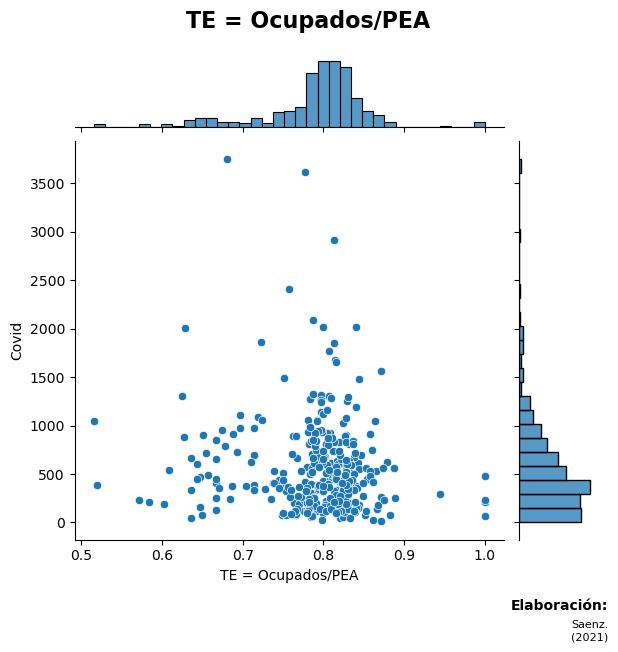

...

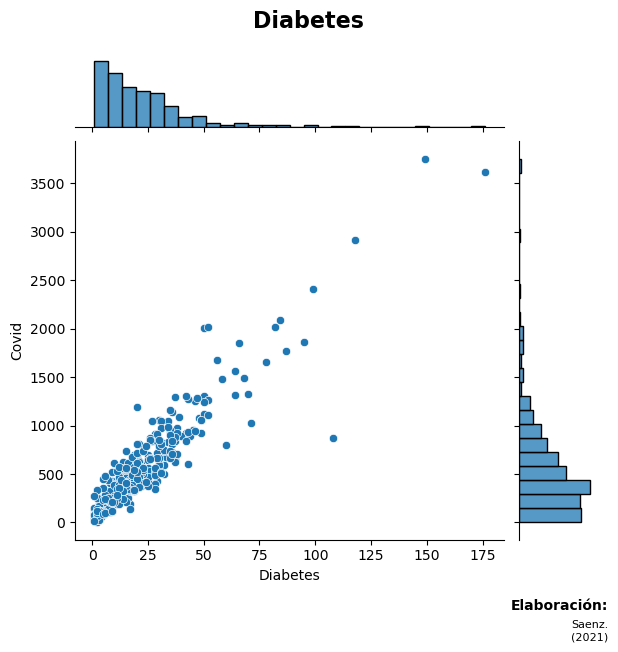

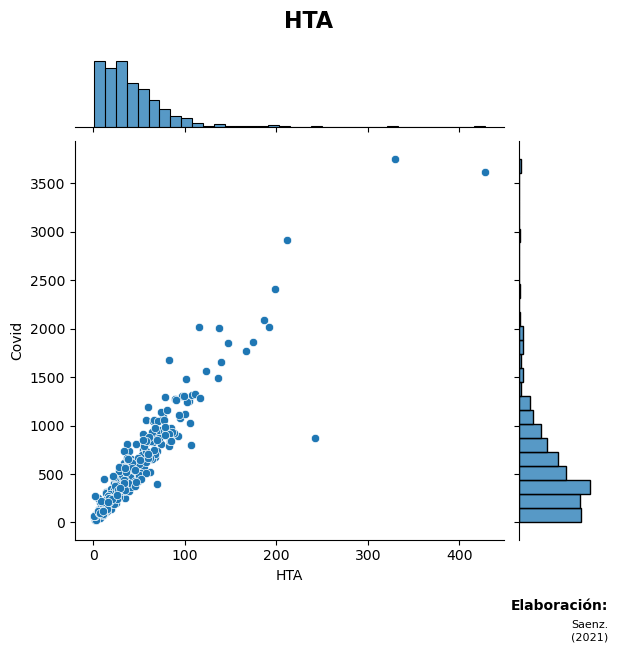

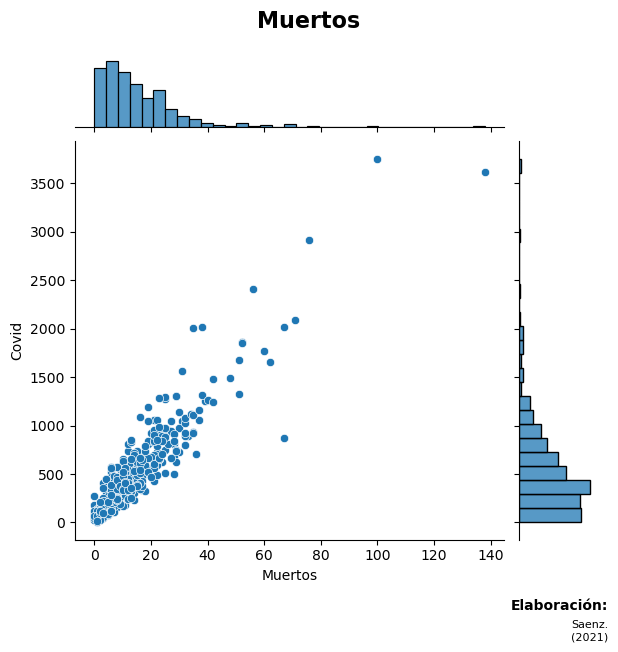

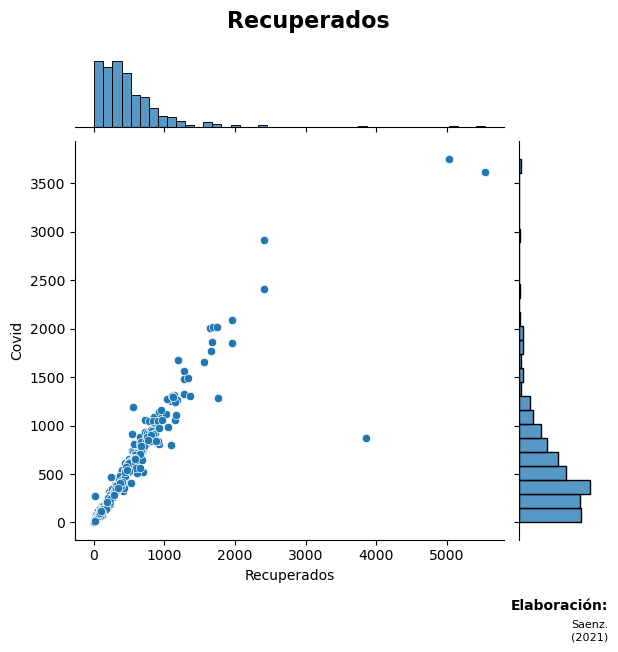

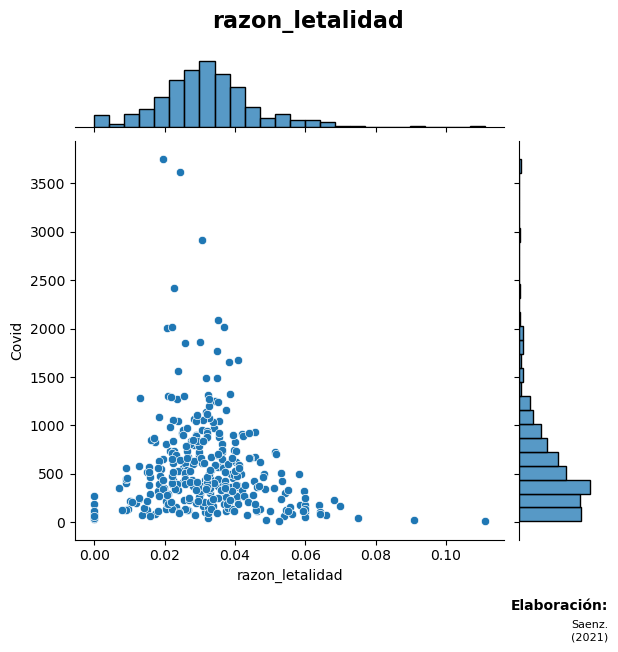

In [42]:
for i in Datos_econ_cali.columns[5:72]:
    var = i
    data = pd.concat([Datos_econ_cali['Covid'], Datos_econ_cali[var]], axis=1)
    g = sns.jointplot(x = var, y = "Covid", data = data)
    g.fig.suptitle(i, fontsize = 16, fontweight = "bold")
    plt.subplots_adjust(top=0.9)
    g.fig.text(1,-.02, "Elaboración:", fontsize = 10, fontweight = "bold", ha = "right")
    g.fig.text(1,-.07, "Saenz.\n(2021)", fontsize = 8, ha = "right")
    plt.show()

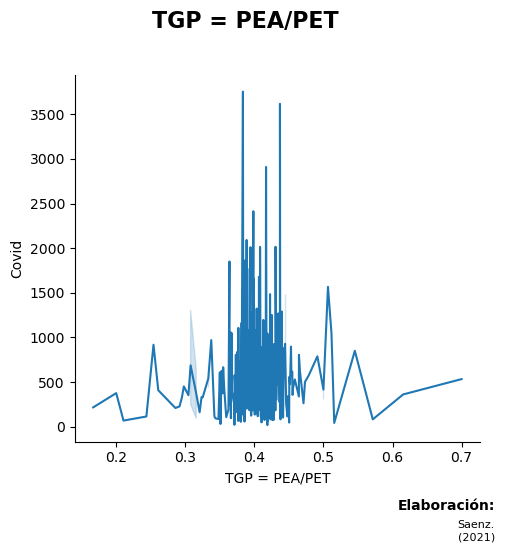

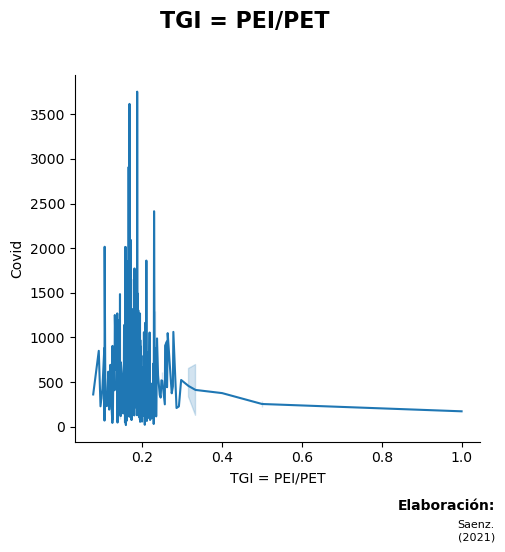

In [43]:
for i in Datos_econ_cali.columns[5:7]:
    var2 = i
    data2 = pd.concat([Datos_econ_cali['Covid'], Datos_econ_cali[var2]], axis=1)
    g = sns.relplot(x = var2, y = "Covid", kind = "line", data = data2)
    g.fig.suptitle(i, fontsize = 16, fontweight = "bold")
    plt.subplots_adjust(top=0.85)
    g.fig.text(1,-.02, "Elaboración:", fontsize = 10, fontweight = "bold", ha = "right")
    g.fig.text(1,-.08, "Saenz.\n(2021)", fontsize = 8, ha = "right")
    plt.show()

In [ ]:
#sns.set_style("white")
#sns.set_style('whitegrid')

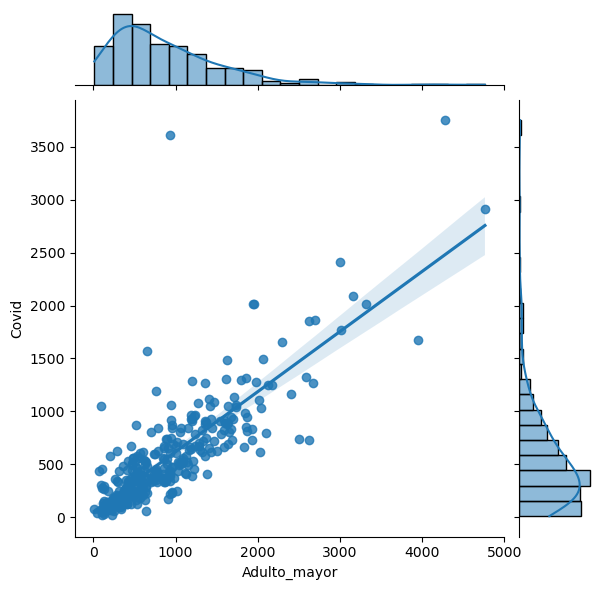

In [44]:
sns.jointplot(x = "Adulto_mayor", y = "Covid", data = Datos_econ_cali, kind = "reg");

# Regresion lasso 

In [45]:
Datos_econ_cali

,N,ID_BARRIO,Barrio_Urbanizacion_o_Sector,NOMBRE,Comuna,TGP = PEA/PET,TGI = PEI/PET,TD = Desocupados/PEA,TO = Ocupados/PET,TE = Ocupados/PEA,...,Tasa_ind_cobert_serv_bajo,Tasa_Pobre_nbi,Comorbilidad,Diabetes,HTA,Muertos,Recuperados,razon_letalidad,Covid,geometry
0,1,101,Terron Colorado,Terron Colorado,1,0.406665,0.182994,0.185587,0.331193,0.814413,...,0.240125,0.072224,230,56.0,83.0,51,1197,0.040865,1679,POLYGON ((-76.56995120093426 3.456430244134905...
1,2,102,Vista Hermosa,Vista Hermosa,1,0.390458,0.169281,0.178775,0.320654,0.821225,...,0.287637,0.098189,79,10.0,34.0,10,439,0.022272,614,POLYGON ((-76.57692380316878 3.458973625028077...
2,3,196,Sector Patio Bonito,Sect. Patio Bonito,1,0.371220,0.203902,0.203679,0.295610,0.796321,...,0.400932,0.157675,10,3.0,6.0,1,66,0.014925,123,"POLYGON ((-76.59073787613775 3.46718939421395,..."
3,4,199,Aguacatal,Aguacatal,1,0.380852,0.194102,0.200827,0.304367,0.799173,...,0.234079,0.090310,94,15.0,39.0,12,543,0.021622,733,"POLYGON ((-76.5591645462267 3.463446593644202,..."
4,5,201,Santa Rita,Santa Rita,2,NaN,NaN,NaN,NaN,NaN,...,0.055994,0.018139,26,4.0,12.0,0,121,0.000000,184,POLYGON ((-76.54810921072797 3.454631979818922...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
332,333,2201,Urbanizacion Ciudad Jardin,Urb. Ciudad Jardin,21,NaN,NaN,NaN,NaN,NaN,...,0.025290,0.007376,191,36.0,85.0,28,875,0.031008,844,"POLYGON ((-76.53706083204358 3.37110660760294,..."
333,334,2296,Parcelaciones Pance,Parcelaciones Pance,22,0.396226,0.179245,0.190476,0.320755,0.809524,...,0.033703,0.009044,297,47.0,116.0,23,1755,0.012936,1282,POLYGON ((-76.52755986680749 3.362999117367949...
334,335,2297,Urbanización Río Lili,Urb. Rio Lili,22,0.424632,0.174632,0.112554,0.376838,0.887446,...,0.057901,0.012476,91,15.0,35.0,6,660,0.009009,561,POLYGON ((-76.52972746439929 3.367275198135529...
335,339,2298,Ciudad Campestre,Ciudad Campestre,22,NaN,NaN,NaN,NaN,NaN,...,0.073852,0.009980,67,11.0,26.0,6,286,0.020548,286,POLYGON ((-76.53706453754501 3.371108479961668...


In [46]:
Datos_econ_cali3 = pd.concat([Datos_econ_cali[Datos_econ_cali.columns[5:12]].reset_index(drop=True), Datos_econ_cali[Datos_econ_cali.columns[24:28]]], axis=1)
Datos_econ_cali3 = pd.concat([Datos_econ_cali3.reset_index(drop=True), Datos_econ_cali[Datos_econ_cali.columns[43:66]]], axis=1)
Datos_econ_cali3 = pd.concat([Datos_econ_cali3.reset_index(drop=True), Datos_econ_cali[Datos_econ_cali.columns[72]]], axis=1)
Datos_econ_cali3 = Datos_econ_cali3.set_index([Datos_econ_cali['NOMBRE']])
Datos_econ_cali3 = Datos_econ_cali3.dropna()
Datos_econ_cali3

,TGP = PEA/PET,TGI = PEI/PET,TD = Desocupados/PEA,TO = Ocupados/PET,TE = Ocupados/PEA,Estrato_moda,Poblacion_total,Hogares,Tam_promedio_hog,Adulto_mayor,...,Proporcion_buscando_trabajo,Proporcion_trabajando,Proporcion_jubilados,Hacinam_cuarto,Hacinam_dormit,ind_cobert_serv_bajo,Pobre_nbi,Tasa_ind_cobert_serv_bajo,Tasa_Pobre_nbi,Covid
NOMBRE,,,,,,,,,,,,,,,,,,,,,
Terron Colorado,0.406665,0.182994,0.185587,0.331193,0.814413,2.0,26861.0,9306.0,2.778397,3950.0,...,0.054866,0.529735,0.050823,0.009143,0.023765,6450.0,1940.0,0.240125,0.072224,1679
Vista Hermosa,0.390458,0.169281,0.178775,0.320654,0.821225,1.0,10103.0,3349.0,2.504631,1321.0,...,0.047786,0.541374,0.036172,0.008575,0.028119,2906.0,992.0,0.287637,0.098189,614
Sect. Patio Bonito,0.371220,0.203902,0.203679,0.295610,0.796321,1.0,4078.0,1375.0,2.609828,526.0,...,0.058394,0.508516,0.025547,0.023114,0.060156,1635.0,643.0,0.400932,0.157675,123
Aguacatal,0.380852,0.194102,0.200827,0.304367,0.799173,1.0,14572.0,5133.0,2.714030,1931.0,...,0.045005,0.571116,0.043059,0.015196,0.045630,3411.0,1316.0,0.234079,0.090310,733
Arboledas,0.409639,0.204819,0.264706,0.301205,0.735294,6.0,3840.0,1475.0,2.408240,956.0,...,0.022439,0.589607,0.126956,0.003934,0.009303,328.0,150.0,0.085417,0.039062,242
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Potrero Grande,0.304527,0.243682,0.254925,0.226895,0.745075,2.0,11258.0,3136.0,2.582542,756.0,...,0.114344,0.418277,0.003978,0.021104,0.096896,5132.0,3206.0,0.455854,0.284775,353
Ciudadela del Rio,0.403192,0.173563,0.201051,0.322130,0.798949,2.0,10164.0,3249.0,2.805138,859.0,...,0.057505,0.554858,0.029184,0.001145,0.012062,1770.0,590.0,0.174144,0.058048,656
Valle Grande,0.439872,0.157301,0.169226,0.365434,0.830774,2.0,17501.0,5653.0,2.530996,1202.0,...,0.063738,0.555847,0.021358,0.001060,0.010341,2863.0,890.0,0.163591,0.050854,1290


In [47]:
Datos_econ_cali3.iloc[:,34]

NOMBRE
Terron Colorado        1679
Vista Hermosa           614
Sect. Patio Bonito      123
Aguacatal               733
Arboledas               242
                       ... 
Potrero Grande          353
Ciudadela del Rio       656
Valle Grande           1290
Parcelaciones Pance    1282
Urb. Rio Lili           561
Name: Covid, Length: 314, dtype: int64

In [48]:
from sklearn.model_selection import train_test_split
X_train, X_test,y_train,y_test = train_test_split(Datos_econ_cali3.iloc[:,0:34], Datos_econ_cali3.iloc[:,34],
                                                  test_size = 0.2,
                                                  random_state = 42)

In [49]:
from sklearn.linear_model import Lasso
alphas = np.linspace(0.1, 200, 2000)
coefs_lasso = []
for a in alphas: 
    lasso = Lasso(alpha=a, normalize = True)
    lasso.fit(X_train, y_train)
    coefs_lasso.append(lasso.coef_)

c:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_base.py:141: FutureWarning: 'normalize' was deprecated in version 1.0 and will be removed in 1.2.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), Lasso())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
  warnings.warn(
c:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_base.py:141: FutureWarning: 'normalize' was deprecated in version 1.0 and will be removed in 1.2.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

f

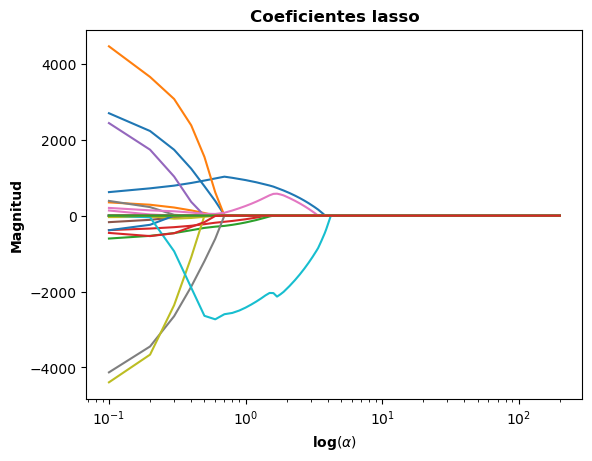

In [50]:
fig, ax = plt.subplots()
ax.plot(alphas, coefs_lasso)
ax.set_xscale("log")
ax.set_title("Coeficientes lasso", fontweight = "bold")
ax.set_xlabel(r"log$(\alpha)$",fontweight = "bold")
ax.set_ylabel("Magnitud",fontweight = "bold")
#fig.text(.9,-.02, "Elaboración:",fontsize = 10, fontweight = "bold",ha = "right")
#fig.text(.9,-.1,"Saenz (2021)",fontsize = 8, ha = "right")
plt.show()

In [51]:
from sklearn.linear_model import LassoCV
lassocv = LassoCV(alphas = alphas, cv = 10, normalize = True)
lassocv.fit(X_train, y_train)
lassocv.alpha_

c:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_base.py:141: FutureWarning: 'normalize' was deprecated in version 1.0 and will be removed in 1.2.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), Lasso())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
  warnings.warn(


0.1

In [52]:
from sklearn.metrics import mean_absolute_error, mean_squared_error
alpha_cv = lassocv.alpha_
lasso01 = Lasso(alpha = alpha_cv, normalize = True)
lasso01.fit(X_train, y_train)
y_pred_lasso = lasso01.predict(X_test)
MAE_lasso01 = mean_absolute_error(y_test, y_pred_lasso)
MSE_lasso01 = mean_squared_error(y_test, y_pred_lasso)
RMSE_lasso01 = np.sqrt(MSE_lasso01)
print("El MAE de la regresión lasso alpha = 0.1 es:",MAE_lasso01)
print("La RMSE de la regresión lasso alpha = 0.1 es:",RMSE_lasso01)

El MAE de la regresión lasso alpha = 0.1 es: 166.24180123350948
La RMSE de la regresión lasso alpha = 0.1 es: 223.98762721305687


c:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_base.py:141: FutureWarning: 'normalize' was deprecated in version 1.0 and will be removed in 1.2.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), Lasso())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
  warnings.warn(


In [53]:
pd.DataFrame({"Coeficientes": lasso01.coef_},index = Datos_econ_cali3.iloc[:,0:34].columns)

,Coeficientes
TGP = PEA/PET,620.285100
TGI = PEI/PET,0.000000
TD = Desocupados/PEA,0.000000
TO = Ocupados/PET,0.000000
TE = Ocupados/PEA,-0.000000
Estrato_moda,-3.251784
Poblacion_total,0.073852
Hogares,0.014763
Tam_promedio_hog,-37.831896
Adulto_mayor,0.303403


In [54]:
coeficientes = pd.DataFrame({"Coeficientes": lasso01.coef_},index = Datos_econ_cali3.iloc[:,0:34].columns)
coeficientes[coeficientes["Coeficientes"]!=0]

,Coeficientes
TGP = PEA/PET,620.285100
Estrato_moda,-3.251784
Poblacion_total,0.073852
Hogares,0.014763
Tam_promedio_hog,-37.831896
Adulto_mayor,0.303403
Prop_adulto_mayor,2699.511703
Proporcion_etnia,349.773742
Proporc_personas_dificultades,-380.724129
Proporcion_sabe_leer_escribir,2439.388522


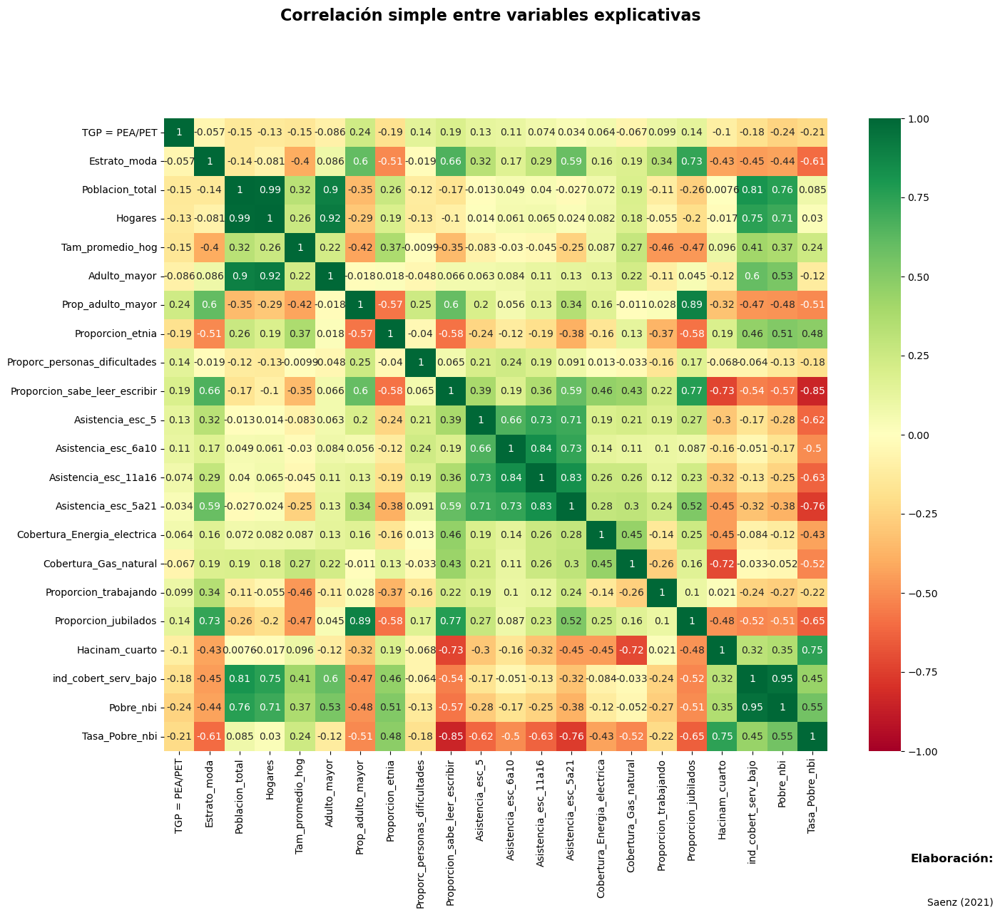

In [55]:
Explicativas = Datos_econ_cali3[coeficientes[coeficientes["Coeficientes"]!=0].index]
fig, ax = plt.subplots(figsize = (15, 12))
fig.suptitle("Correlación simple entre variables explicativas", fontsize = 16, fontweight = "bold", x = 0.43)
sns.heatmap(Explicativas.corr(), vmin = -1, vmax = 1, ax = ax, cmap = "RdYlGn", annot = True)
plt.subplots_adjust(top = 0.85)
fig.text(.9,-.02, "Elaboración:", fontsize = 12, fontweight = "bold", ha = "right")
fig.text(.9,-.07, "Saenz (2021)", fontsize = 10, ha = "right")
plt.show()

In [56]:
correl_expli = Datos_econ_cali3[np.append(coeficientes[coeficientes["Coeficientes"]!=0].index,
                                                'Covid')].corr().unstack().sort_values(kind="quicksort")
correl_expli['Covid']

Tasa_Pobre_nbi                  -0.180852
Hacinam_cuarto                  -0.160810
Proporc_personas_dificultades   -0.072790
Proporcion_etnia                -0.007946
Prop_adulto_mayor                0.005063
Proporcion_trabajando            0.007689
TGP = PEA/PET                    0.033774
Proporcion_jubilados             0.039743
Asistencia_esc_5                 0.082310
Asistencia_esc_6a10              0.090902
Tam_promedio_hog                 0.102857
Estrato_moda                     0.109567
Asistencia_esc_5a21              0.115547
Asistencia_esc_11a16             0.120006
Cobertura_Energia_electrica      0.133170
Proporcion_sabe_leer_escribir    0.139412
Cobertura_Gas_natural            0.160671
Pobre_nbi                        0.354419
ind_cobert_serv_bajo             0.401769
Poblacion_total                  0.747255
Hogares                          0.776239
Adulto_mayor                     0.818369
Covid                            1.000000
dtype: float64